# Analysis of CITE sequencing data of human brain cells 

## Introduction

Understanding which specific proteins are responsible for the development of autoimmune diseases can aid in early diagnosis and treatment.
One of the most progressive research methods for this today is single-cell RNA sequencing (scRNA-seq), which provides a detailed and accurate picture of gene expression. 

In this project, I will analyze single-cell sequencing data from the human brain organoid. Since the cells were also bound with antibodies from patients with autoimmune diseases, I hope to discover a correlation between gene expression and binding.

I will use the augmented transcriptome mapping of RNA sequencing data, a fast and highly resolved method for analyzing gene expression [1].
 
Because RNA-seq data analysis mainly relies on packages for R language, here I also aim to entirely rely on Python. The main reason for this is the belief that big data processing can be more effective using Python. It is also a more flexible and fastly developing tool, using which also might be crucial for cutting-edge data analysis.

**CITE-seq protocol**

The CITE-seq protocol integrates cellular protein and single-cell RNA (scRNA) measurements into a single assay using oligonucleotide-labeled antibodies.

**Design of Experiment**

Cerebral (brain) organoid cells from four donors were bound to four types of antibodies.

**Data Processing Approach**

In general, scRNA and antibody/cell-hashtag data are processed separately. Here they will only be merged at the dimensionality reduction stage.


---
[1] Workflow is mainly based on recommendations in https://www.sc-best-practices.org/ book and [Tutorial fron scRNA data analysis from Zhisong He, Barbara Treutlein](https://github.com/quadbio/scRNAseq_analysis_vignette). 

## Project Structure 

### Raw data processing

Download reference genome, gene annotation files (Gencode), and barcode whitelist (10x Chromium v2)

#### Raw scRNA data processing

1. Generation so-called the splici index for the reference genome (a.k.a. augmented transcriptome: build spliced transcripts taking into account the presence of introns and index it) 

2. Generation a permit list for cell barcode correction 10x Chromium v2 chemistry

3. Mapping of the sequencing reads against an index of the reference 

4. UMI resolution: allocation a molecular count to each gene in each cell. UMIs with equal matches to multiple genes are treated as a group (a.k.a. equivalence class), using an expectation maximization algorithm. 

#### Raw antibodies data processing

1. Generation of the index the feature barcodes according the barcode sequences of the antibody-derived tags (ADT) and the hash antibody tag oligos (HTO). Further here is referred as  “antibodies data” 

2. Generation a permit list for cell barcode correction 10x Chromium v2 chemistry

3. Mapping of the sequencing reads against the index

4. UMI resolution

More details one can find in `raw_data_processing_report.md`. 

### Preprocessing 

1. Upload Data for scRNA and Antibodies Sequencing
2. Protein-coding Genes Preselection
3. Quality Control (QC) for scRNA-seq: 
    
    * Ambient RNA Correction
    * Ribosomal and Mitochondrial Genes Filtration
    * Outlier Filtration
    * Check Marker Genes for a Brain Organoid 
    
**For scRNA-seq data**

4. Normalization of scRNA-seq data
5. Highly-variable Genes Selection

**For Antibodies data** 

6. Exploratory Data Analysis of Antibodies Sequencing Data
7. QC for Antibodies Data
8. Normalization of Antibodies Data
9. Heterogeneous Doublet Detection
10. Combine the Data: keep cells which belong to both scRNA and Antibodies 

I will refer to combined data as *CITE-seq data*.


### Data Analysis of CITE-seq data

1. Dimensionality Reduction 
2. Correlations between Gene Expression and Antibody Binding
3. Correlations for Plasma Membrane Genes

### Communicate Results

* Prepare a Report in PDF


In [1]:
import helper as h # import helper functions for the project 

In [2]:
import numpy as np
import pandas as pd
import anndata as ad
import pyroe
import scanpy as sc

import doubletdetection 
import scanpy.external as sce

import mudata as md
from mudata import MuData
import muon as mu

/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [67]:
# to display plots
import matplotlib.pyplot as plt
import seaborn as sns 

sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=100,
    dpi_save=300,
    facecolor="white",
    frameon=False,
)

In [4]:
path = h.return_path() # absolute path for the data
joined_dir = f"{path}/joined_data" # raw joined data and processed data are stored in the directory "joined_data"
path_images = f"{path}/figures" # absolute path for images storing 

## scRNA-seq raw data import

We will store and operate our data using `anndata` object; its structure is presented below.

### Visual representation of AnnData Object 
<img src="figures/anndata.png" alt="Drawing" style="width: 500px;"/>

In [5]:
# Upload RNA data 
adata = ad.read_h5ad(f"{joined_dir}/raw_data_results.h5ad")
adata

/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 190954 × 62700
    obs: 'barcodes'

In [6]:
adata.obs_names_make_unique()

In [7]:
adata

AnnData object with n_obs × n_vars = 190954 × 62700
    obs: 'barcodes'

**Observational level** contains cell barcodes. **Variable level** contains gene ids.

Obtained AnnData object for RNA data correspond to **190954 cells with 62700 genes**.

For some reason, the indexes do not correspond to gene names. 
But this info already contains in `ref_data/splici_rl90_ref.gene_id_to_name.tsv`,
so we just need to change indexes 

### Gene Preselection 

We are working only with protein-coding genes, so I will do a gene preselection here. The list of genes is from [Ensembl BioMart database](https://www.ensembl.org/biomart/martview/15b6067720d16518894c7cc184e87e15)

In [8]:
df_genes = h.gene_names(joined_dir, adata)
adata.var = df_genes.copy()

In [9]:
df_genes = h.gene_names_coding_proteins(joined_dir, adata)
adata = adata[:,adata.var["gene_name"].isin(df_genes["gene_name"])]
adata.var.set_index("gene_name",inplace=True)


In [10]:
adata.var

,gene_ids
gene_name,
NIPAL3,ENSG00000001461.17
SPRTN,ENSG00000010072.16
CAMK1G,ENSG00000008118.10
FAM76A,ENSG00000009780.16
VPS13D,ENSG00000048707.15
...,...
DHRSX,ENSG00000292338.1
SLC25A6,ENSG00000292334.1
P2RY8,ENSG00000292333.1


In [11]:
adata.var.index.nunique()

20020

In [12]:
adata.var_names_make_unique()

/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Antibodies and cell hashtag  data raw data import

In [13]:
# sequences for antibody tags and cell hashing 
groups = {
    "IgM": "TAGCGAGCCCGTATA",
    "IgG-Fc": "CTGGAGCGATTAGAA",
    "Ig-kappa": "AGCTCAGCCAGTATG",
    "Ig-lambda": "CAGCCAGTAAGTCAC",
    "Donor-1": "GTCAACTCTTTAGCG",
    "Donor-2": "TGATGGCCTATTGGG",
    "Donor-3": "TTCCGCCTCTCTTTG",
    "Donor-4": "AGTAAGTTCAGCGTA"
}

In [14]:
ant_data = ad.read_h5ad(f"{joined_dir}/adt_hto/raw_data_results.h5ad")
ant_data.var.index.name = "groups"

/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [15]:
ant_data.obs_names_make_unique()

In [16]:
ant_data.to_df()

groups,IgM,IgG-Fc,Ig-kappa,Ig-lambda,Donor-1,Donor-2,Donor-3,Donor-4
barcodes,,,,,,,,
CATGCCTTCGAGAGCA,436.0,160.0,173.492874,178.507126,2.0,528.0,0.0,1.0
GGCGTGTTCTATGTGG,563.0,138.0,223.402161,148.597839,0.0,3.0,0.0,697.0
GATCGTATCAACGGCC,709.0,94.0,304.633331,176.366669,0.0,0.0,169.0,0.0
CTGATAGTCGCTTGTC,783.0,133.0,178.000000,242.000000,0.0,363.0,0.0,0.0
GAGTCCGCAGATCGGA,1173.0,179.0,432.907074,248.092926,1.0,1.0,0.0,96.0
...,...,...,...,...,...,...,...,...
TACGGATAGGCCGAAT-1,1.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0
AGATCTGAGCGACGTA-1,3.0,1.0,0.000000,3.000000,0.0,2.0,0.0,0.0
GGTATTGAGAGACTAT-1,11.0,2.0,3.000000,0.000000,0.0,2.0,0.0,1.0


In [17]:
check_d4 = ant_data.to_df()

for i in range(1,5):
    print(f"Total Counts for Donor-{i}:", round(check_d4[f"Donor-{i}"].sum()))

Total Counts for Donor-1: 534118
Total Counts for Donor-2: 673080
Total Counts for Donor-3: 273355
Total Counts for Donor-4: 257469


## Quality Control for scRNA-seq data

In [18]:
# Compute qc metrics

sc.pp.calculate_qc_metrics(
    adata, inplace=True, percent_top=[20], log1p=True
)
adata

AnnData object with n_obs × n_vars = 190954 × 20054
    obs: 'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes'
    var: 'gene_ids', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

#### Total counts

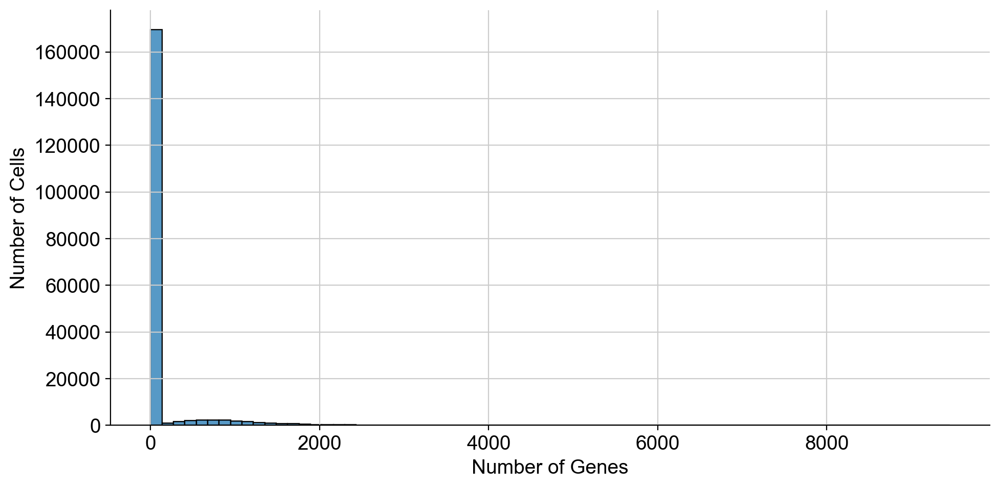

In [19]:
p1 = sns.displot(adata.obs["total_counts"], bins=70, kde=False, height=5,aspect=2)
p1.set_axis_labels( "Number of Genes", "Number of Cells")
plt.savefig(f"{path_images}/total_counts_1.png", bbox_inches="tight")

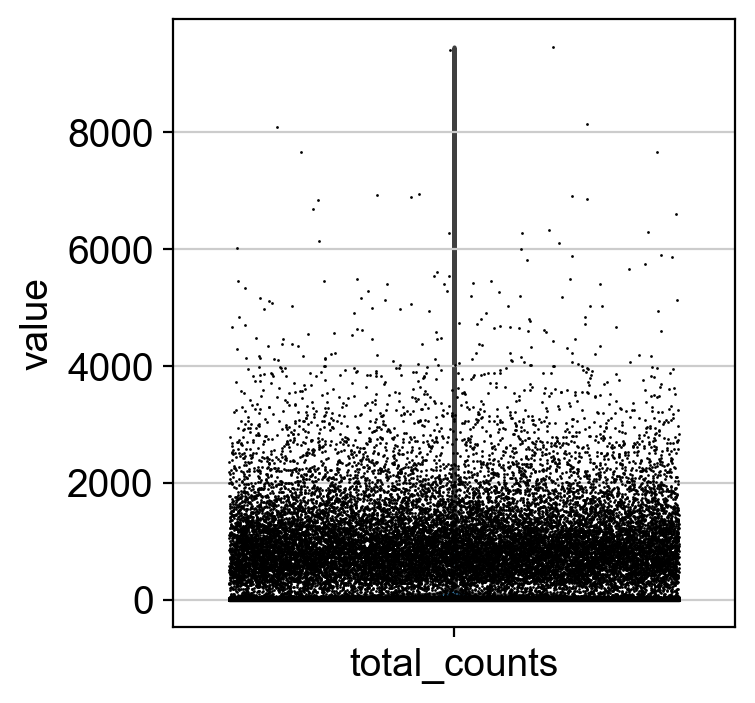

In [20]:
p21 = sc.pl.violin(adata, 'total_counts', jitter=0.4, save = "_1.png") 

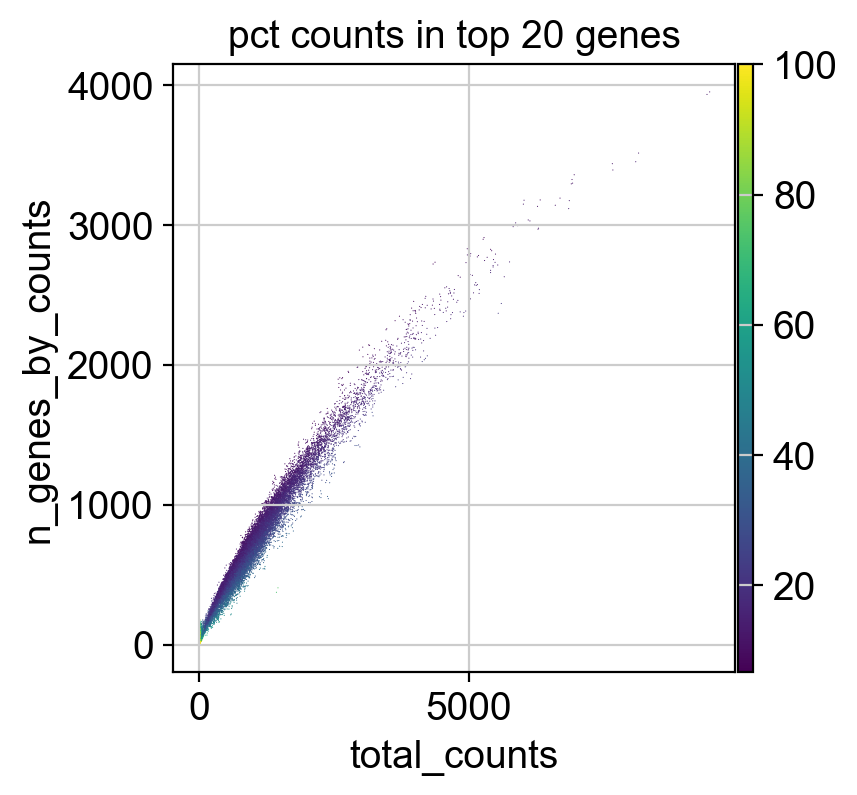

In [21]:
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_in_top_20_genes", save = "_1.png")

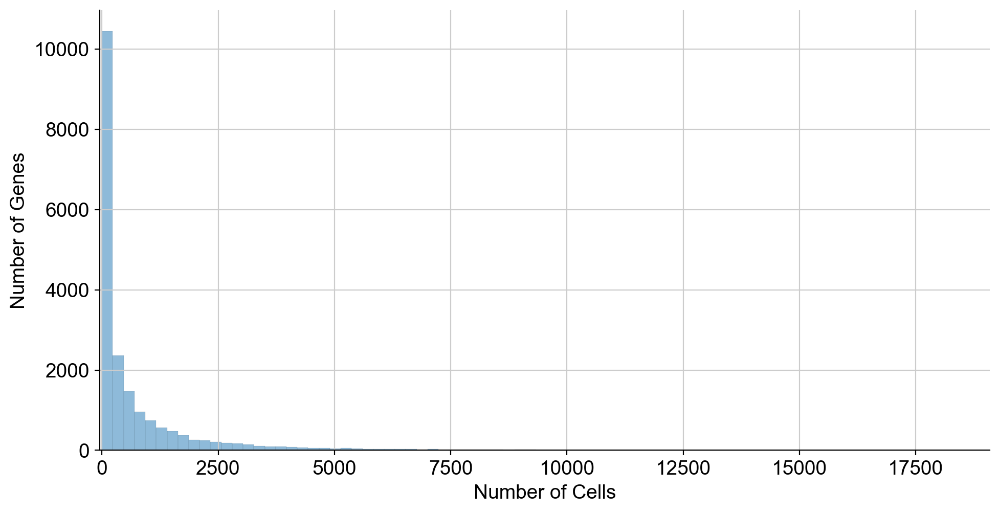

In [22]:
p1 = sns.displot(adata.X.T.sum(1), bins=2000, kde=False, legend=False, height=5,aspect=2)
p1.set_axis_labels("Number of Cells", "Number of Genes")
plt.xlim(-50,int(len(adata)/10))
plt.savefig(f"{path_images}/gene_counts_1.png", bbox_inches="tight");

### Ambient RNA Correction

Droplet-based scRNA-seq protocol assumes, that UMI enables us to identify the number of molecules for each gene and each cell. But cell-free mRNA molecules can be present in the dilution (people refer to this as a "soup"), which are also sequenced. Here we will filter these cell-free (ambient) mRNA. 

Probably, the left peak in the Count Depth distribution came from the ambient mRNA. It is quite easy to determine the threshold for count depth, but just in case we will plot the dependence of count depth from barcode rank to see the so-called "knee" or "elbow". 


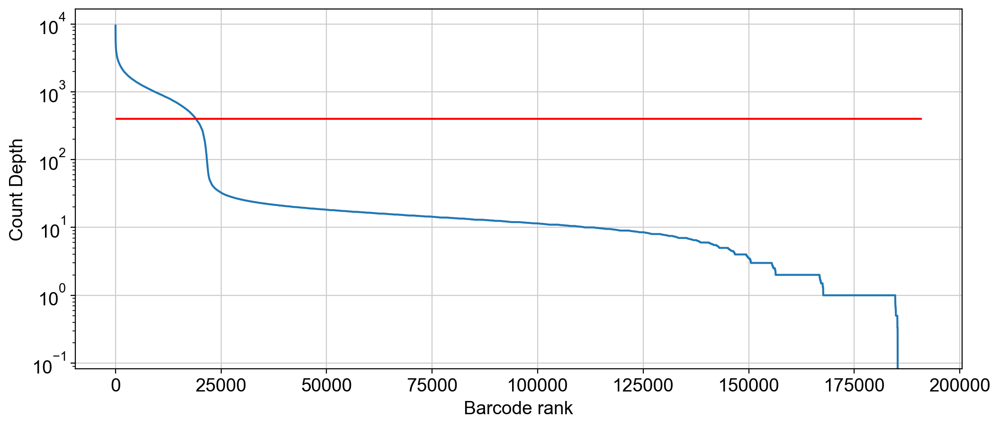

In [23]:
# Set `barcode_threshold` to desired value 
barcode_threshold = 400

barcodes_ranked = adata.obs["total_counts"].sort_values(ascending=False).reset_index()

plt.figure(figsize=(12,5))
plt.plot(barcodes_ranked.index, barcodes_ranked["total_counts"])
plt.hlines(barcode_threshold, 0, len(barcodes_ranked.index), colors='r')
plt.xlabel("Barcode rank")
plt.ylabel("Count Depth")
plt.yscale("log")
plt.savefig(f"{path_images}/barcode_rank_rna.png", bbox_inches="tight")
plt.show()

It is permissive to choose 400 counts as a threshold. Let's transform our data and look at the result.

In [24]:
print(f"Total number of cells: {adata.n_obs}")

true_rna = adata.obs["total_counts"] > barcode_threshold

adata =  adata[true_rna].copy()

print(f"Number of cells after filtering of low quality cells: {adata.n_obs}")

Total number of cells: 190954
Number of cells after filtering of low quality cells: 19026


We also will filter out cells for which less than 1000 genes were found. 

In [25]:
sc.pp.filter_cells(adata, min_genes = 1000)

print(f"Number of cells: {adata.n_obs}")
print(f"Number of genes: {len(adata.var)}")

Number of cells: 4326
Number of genes: 20054


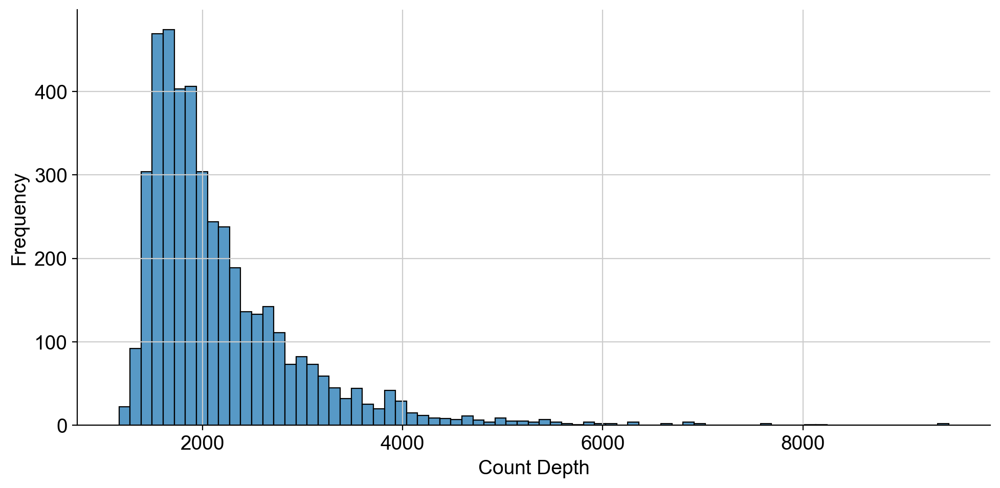

In [26]:
p1 = sns.displot(adata.obs["total_counts"], bins=75, kde=False, height=5,aspect=2)
p1.set_axis_labels("Count Depth", "Frequency");
plt.savefig(f"{path_images}/total_counts_2.png", bbox_inches="tight");

Now we are ready to filter outliers based on the whole distribution. 

In [27]:
# This part changes the quality of detection of brain-organoid releated genes 
# adata.obs["outlier"] = (
#     h.is_outlier(adata, "log1p_total_counts", 5)
#     | h.is_outlier(adata, "log1p_n_genes_by_counts", 5)
#     | h.is_outlier(adata, "pct_counts_in_top_20_genes", 5)
# )



# adata.obs["outlier"].value_counts()

In [28]:
# print(f"Total number of cells: {adata.n_obs}")
# adata = adata[(~adata.obs["outlier"]) ].copy()
# print(f"Number of cells after filtering of low quality cells: {adata.n_obs}")

In [29]:
# p1 = sns.displot(adata.obs["total_counts"], bins=80, kde=False, height=5,aspect=2)
# p1.set_axis_labels("Count Depth", "Frequency");
# plt.savefig(f"{path_images}/total_counts_3.png", bbox_inches="tight");

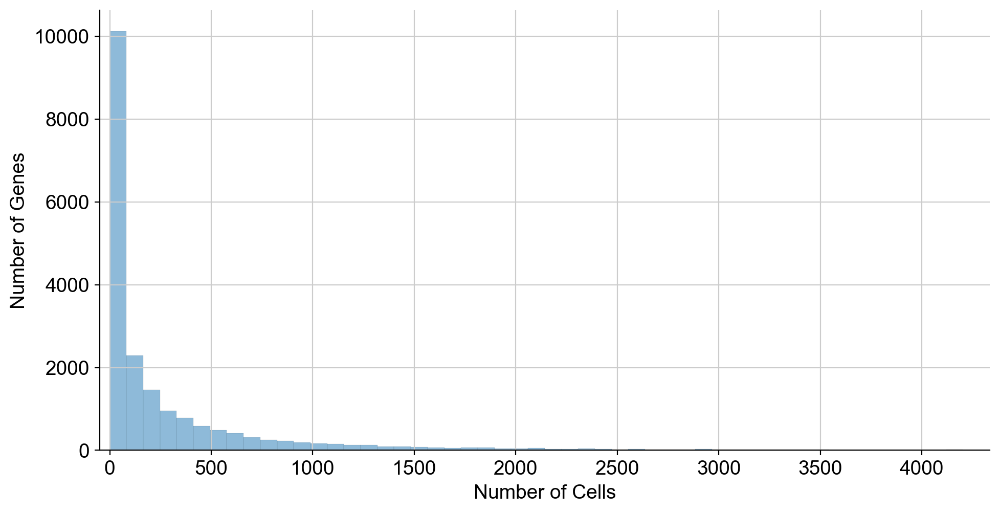

In [30]:
p1 = sns.displot(adata.X.T.sum(1), bins=2000, kde=False, legend=False, height=5,aspect=2)
p1.set_axis_labels("Number of Cells", "Number of Genes")
plt.xlim(-50,adata.shape[0] + 10)

plt.savefig(f"{path_images}/gene_counts_2.png", bbox_inches="tight");

Our distribution of total counts has changed significantly. Now, it is a skewed unimodal distribution, which hopefully gives us both informative and clean results. 

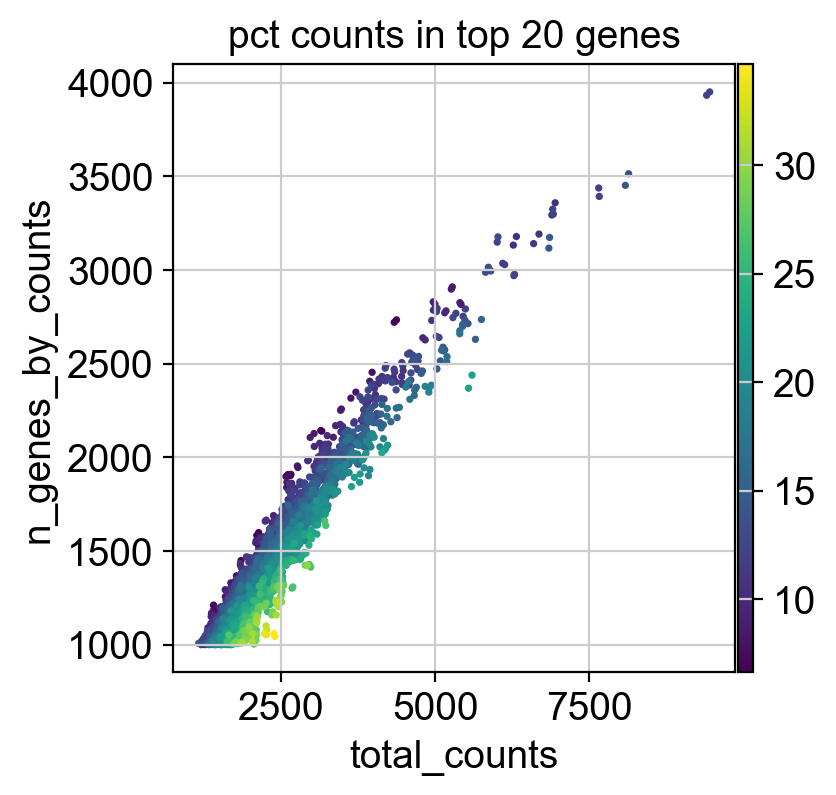

In [31]:
p4 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_in_top_20_genes", save="_2.png")

* "n_genes_by_counts" in .obs represents is the number of genes with at least 1 count in a cell. Calculated for all cells. 

* "pct counts in top 20 genes" signifies the proportion of total counts for top 20 genes.

We will use QC with a threshold of 5 MADs. 

### Damaged Cells Filtration

Here we want to filter out cells with broken membranes, which usually have a high amount of mitochondrial counts. To ensure accurate representation of informative mRNA transcripts, it is necessary to exclude cells with high ribosomal RNA reads from further analysis.



To do the outlier filtration, we need to determine a quality control threshold. Following the recommendations of the book [Single-cell best practices](https://www.sc-best-practices.org/), we can delete outliers in our data, which differ by 5 MADs.

$$
MAD = meadian(|X_i-median(X)|)
$$

In [32]:
# Varieties of genes in the dataset
print("Number of mitochondrial genes:" , sum(adata.var_names.str.startswith("MT-")))
print("Number of ribosomal genes:" , sum(adata.var_names.str.startswith(("RPS", "RPL"))))
adata.var["mt"] = adata.var_names.str.startswith("MT-")
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))

Number of mitochondrial genes: 13
Number of ribosomal genes: 102


In [33]:
# The proportions of counts for specific gene populations 

sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo"], inplace=True, percent_top=[20], log1p=True
)
adata

AnnData object with n_obs × n_vars = 4326 × 20054
    obs: 'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'n_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo'
    var: 'gene_ids', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'ribo'

#### Mitochongrial counts 

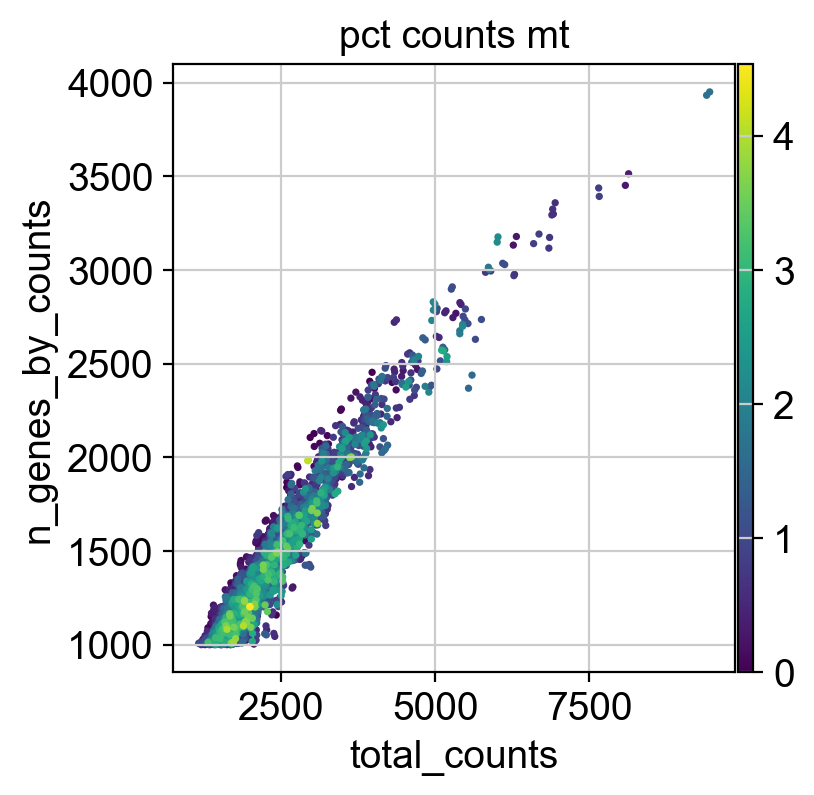

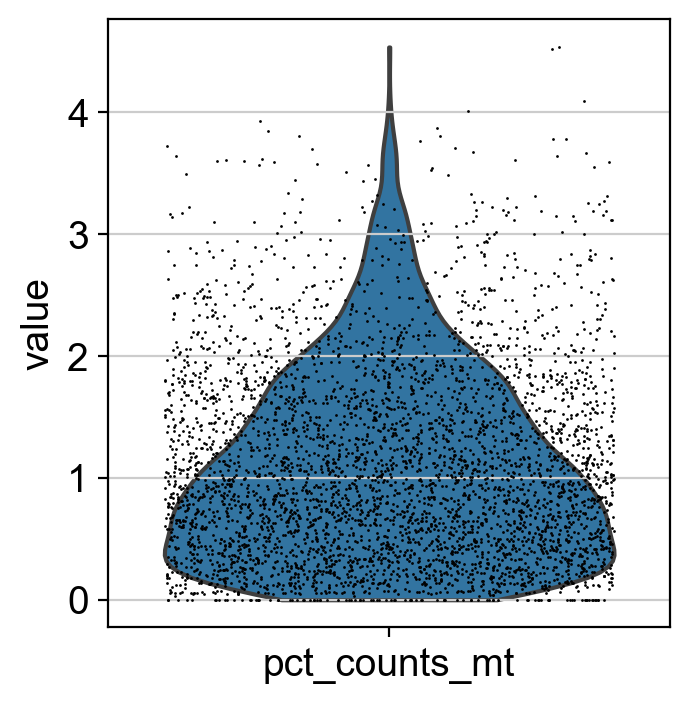

In [34]:
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt", save = "_mt_1.png") 
p22 = sc.pl.violin(adata, "pct_counts_mt",jitter=0.4)

* "n_genes_by_counts" in .obs represents is the number of genes with at least 1 count in a cell. Calculated for all cells. 

* "pct_counts_mt" signifies the proportion of total counts that originate from mitochondrial genes.

Some reads have a high percentage of mitochondrial counts which are often associated with cell degradation. We will use QC with automatic with a threshold of 5 MADs. Also, cells with a percentage of mitochondrial counts exceeding 8 % are filtered out.

In [35]:
adata.obs["mt_outlier"] = h.is_outlier(adata, "pct_counts_mt", 5) | (
    adata.obs["pct_counts_mt"] > 8
)
adata.obs["mt_outlier"].value_counts()

False    4302
True       24
Name: mt_outlier, dtype: int64

#### Ribosomial counts

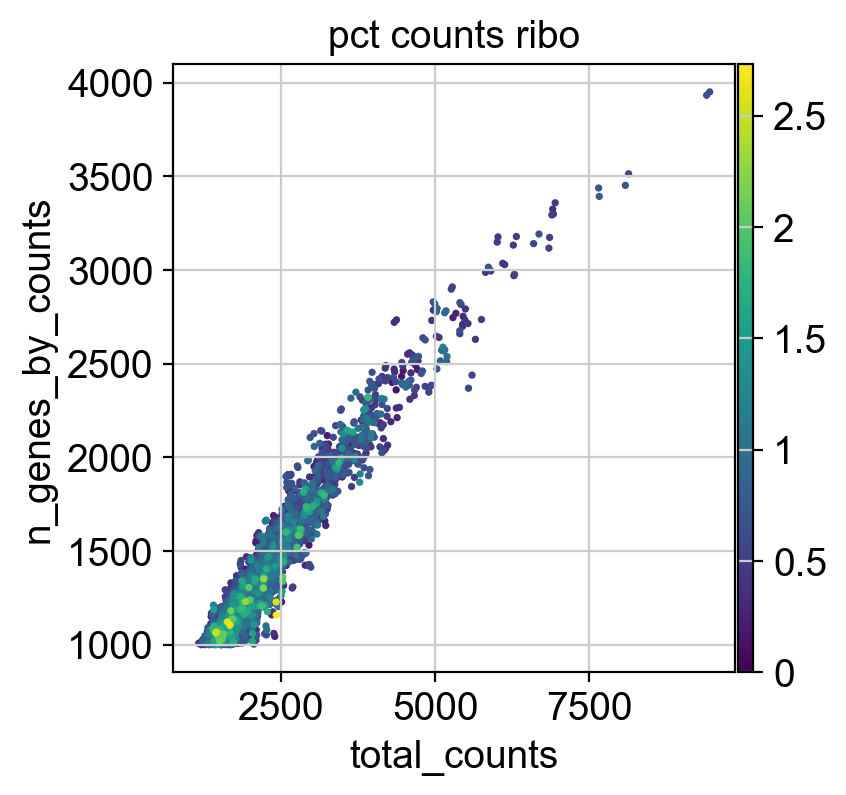

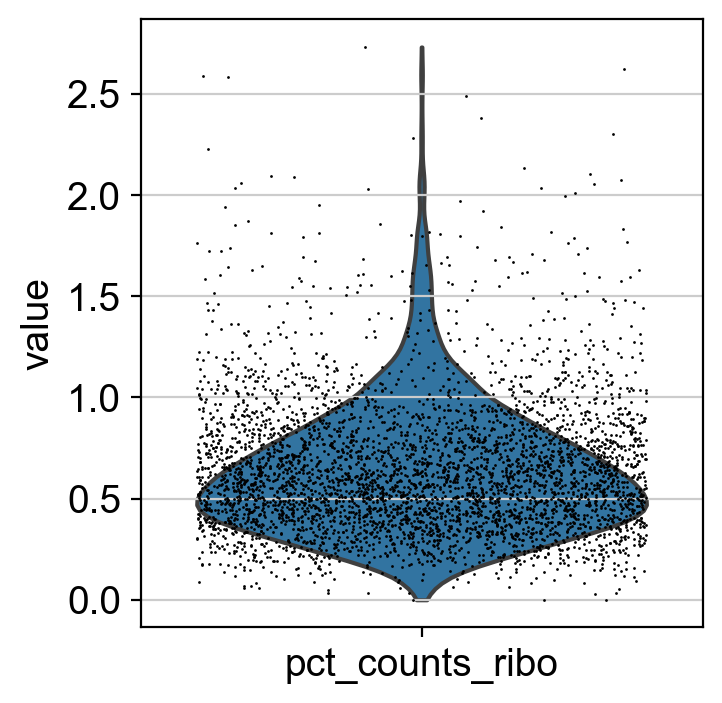

In [36]:
p4 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_ribo", save = "_ribo_1.png")
p42 = sc.pl.violin(adata, "pct_counts_ribo",jitter=0.4, save="_ribo_1.png")

If not filtered out, rRNA reads can dominate the sequencing data, reducing the representation of other biologically relevant transcripts. Removing rRNA reads helps to focus the analysis on the informative mRNA transcripts.

We apply the same QC as for mitochondrial counts.

In [37]:
adata.obs["ribo_outlier"] = h.is_outlier(adata, "pct_counts_ribo", 5) | (
    adata.obs["pct_counts_ribo"] > 8
)
adata.obs["ribo_outlier"].value_counts()

False    4228
True       98
Name: ribo_outlier, dtype: int64

#### Filter out ribosomal and mitochondrial counts

In [38]:
print(f"Total number of cells: {adata.n_obs}")
adata = adata[ (~adata.obs["mt_outlier"]) & (~adata.obs["ribo_outlier"])].copy()
print(f"Number of cells after filtering of low quality cells: {adata.n_obs}")

Total number of cells: 4326
Number of cells after filtering of low quality cells: 4205


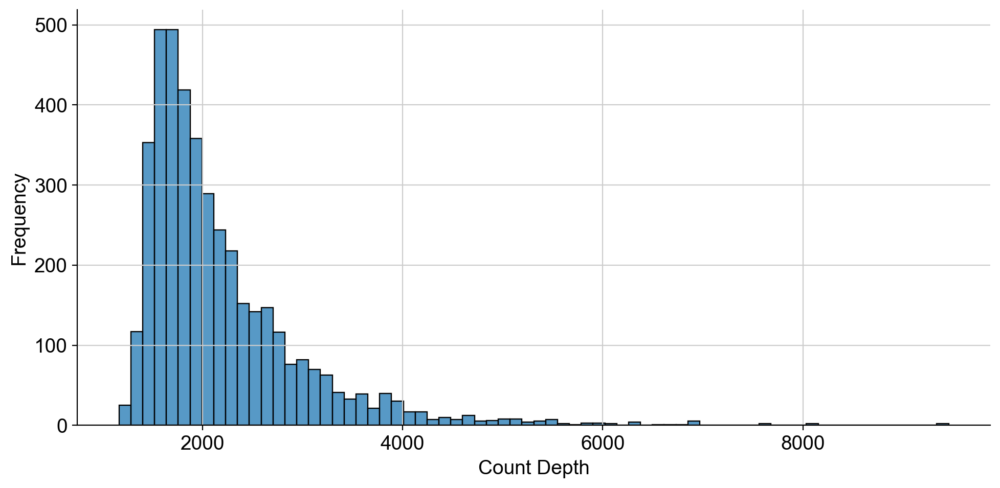

In [39]:
p1 = sns.displot(adata.obs["total_counts"], bins=70, kde=False, height=5,aspect=2)
p1.set_axis_labels("Count Depth", "Frequency");
plt.savefig(f"{path_images}/total_counts_2.png", bbox_inches="tight")

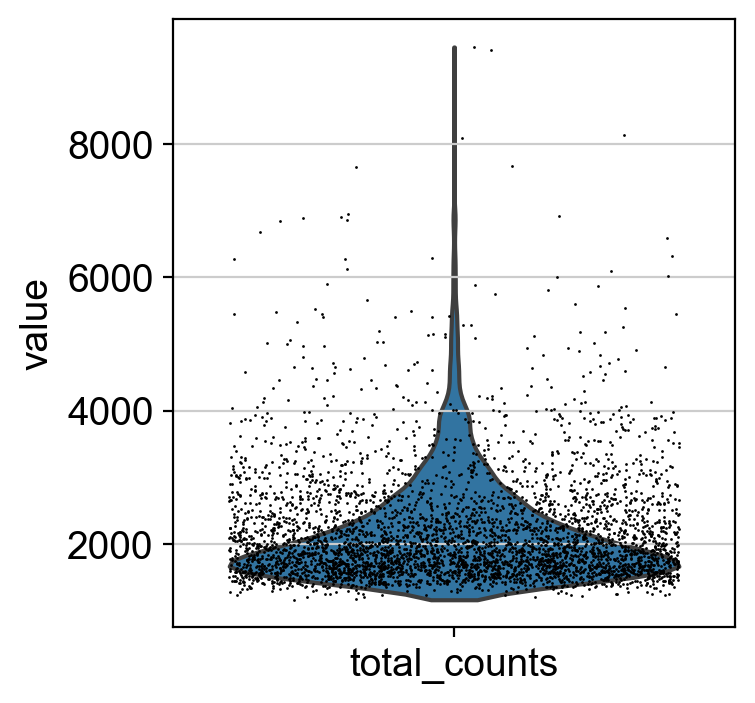

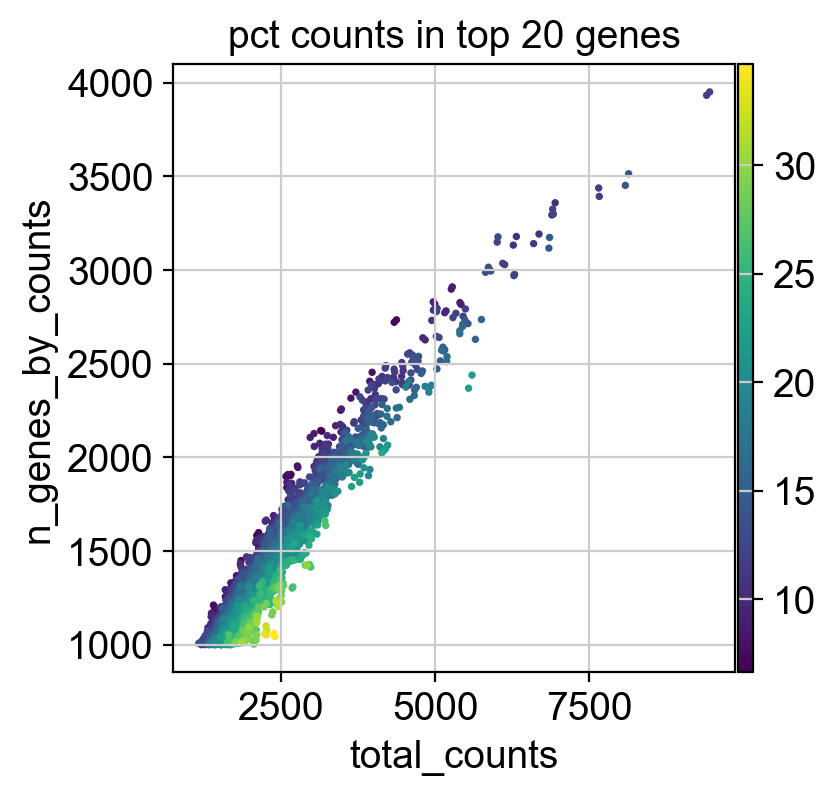

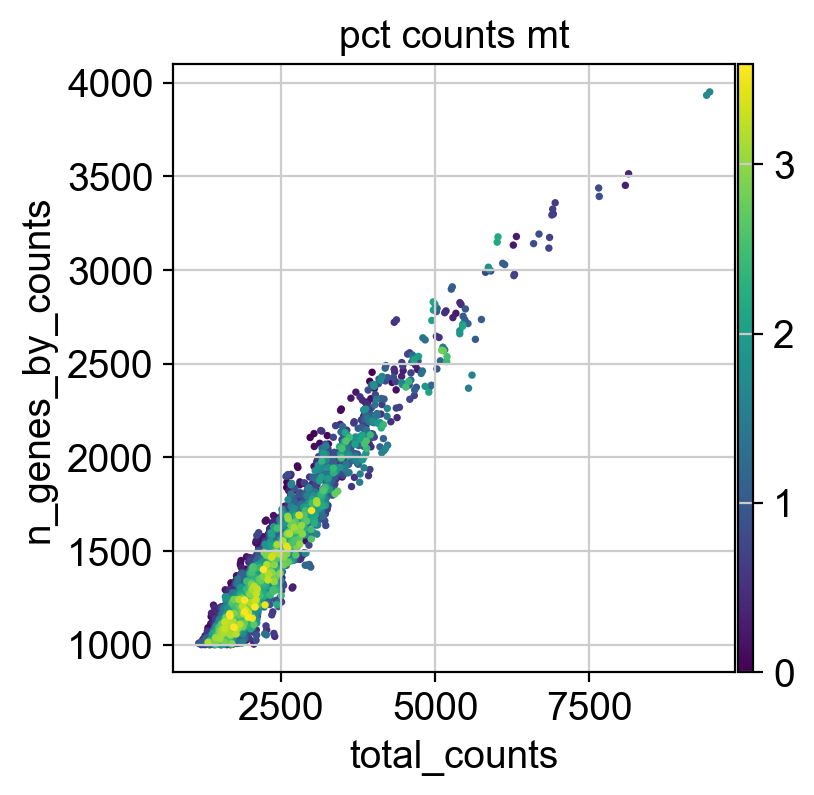

In [40]:
p21 = sc.pl.violin(adata, 'total_counts',jitter=0.4, save = "_total_2.png")
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_in_top_20_genes", save = "_2.png")
p4 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt", save = "_mt_2.png")

In [41]:
# Preserve original counts in a layer before the normalization
adata_raw = adata.copy()

# And export our intermediate results 
adata_raw.write(f"{joined_dir}/rna_data_after_qc.h5ad")

### Normalization 

**Shifted logarithm** aims to make the variances across the dataset more similar. It used for subsequent dimensionality reduction and identification of differentially expressed genes.
The transformation $T$ is determed as

$$
T(y) = \ln(\frac{y}{s}-y_0)
$$

where $y$ are row counts, $s$ is scaling parameter, $y_0$ is preudo-count (it is not possible to take log for exact zeros). 

For a single cell, scaling parameter is following

$$
s = \sum_{all \; genes} y_{gene}/L
$$

where $L$ here is a target sum, which is median count depth. 



In [42]:
scales_counts = sc.pp.normalize_total(adata, target_sum=None, inplace=False)
# log1p transform
adata.layers["log1p_norm"] = sc.pp.log1p(scales_counts["X"], copy=True)

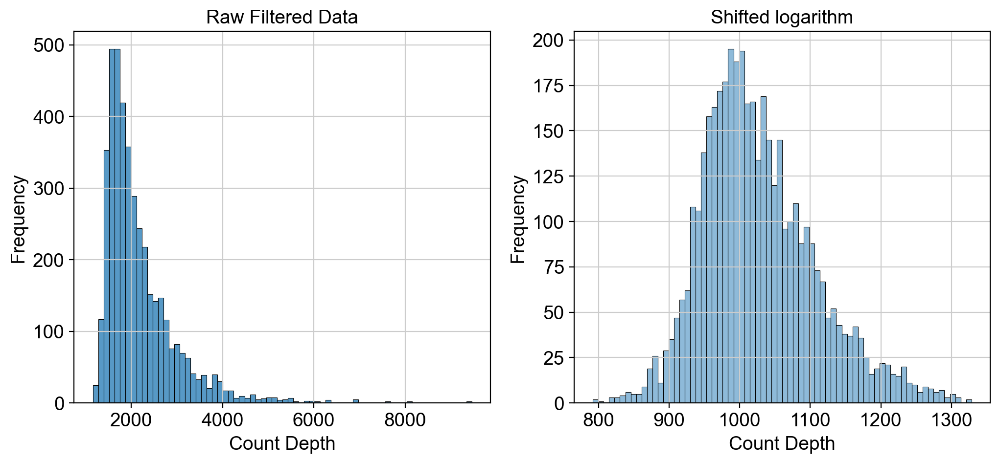

In [43]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
# adata.obs["total_counts"] is the same as adata.X.sum(1)
p1 = sns.histplot(adata.obs["total_counts"], bins=70, kde=False, ax=axes[0])
p1.set_title("Raw Filtered Data")
axes[0].set_xlabel("Count Depth")
axes[0].set_ylabel("Frequency")

# adata.layers["log1p_norm"].sum(1) gives a sum of each row - which is total counts (a.k.a. count depth)
p2 = sns.histplot(adata.layers["log1p_norm"].sum(1), bins=70, kde=False,legend=False, ax=axes[1])
axes[1].set_title("Shifted logarithm")
axes[1].set_xlabel("Count Depth")
axes[1].set_ylabel("Frequency")
plt.savefig(f"{path_images}/total_counts_norm.png", bbox_inches="tight")
plt.show()

In [44]:
adata.var

,gene_ids,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,mt,ribo
gene_name,,,,,,,,,
NIPAL3,ENSG00000001461.17,71,0.015927,0.015801,98.358761,68.900002,4.247066,False,False
SPRTN,ENSG00000010072.16,570,0.143057,0.133707,86.823856,618.865906,6.429503,False,False
CAMK1G,ENSG00000008118.10,23,0.005317,0.005303,99.468331,23.000000,3.178054,False,False
FAM76A,ENSG00000009780.16,215,0.051235,0.049966,95.030051,221.642960,5.405570,False,False
VPS13D,ENSG00000048707.15,622,0.167115,0.154535,85.621822,722.938293,6.584706,False,False
...,...,...,...,...,...,...,...,...,...
DHRSX-1,ENSG00000292338.1,0,0.000000,0.000000,100.000000,0.000000,0.000000,False,False
SLC25A6-1,ENSG00000292334.1,0,0.000000,0.000000,100.000000,0.000000,0.000000,False,False
P2RY8-1,ENSG00000292333.1,0,0.000000,0.000000,100.000000,0.000000,0.000000,False,False


In [45]:
# And export again our intermediate results 
adata.write(f"{joined_dir}/normalized_data.h5ad")

### Gene selection
Some number of genes might be detected in a few cells (our matrix is sparse), but we are interested in the most expressed ones and genes with high spread of expression values relative to the mean. 

Choosing the pseudo count, our normalization could introduce biases in the data, changing variance of genes. So we do first gene selection based on Analytic Pearson residuals.

#### Highly variable genes 
Plot mean and residual variance of each gene, highlighting the selected genes (red). We see that genes with a high residual variance are selected as highly deviant.

In [46]:
# Expect counts without normalization. 
# The method might give a warning message because the count matrix has 1.0 (float) instead of 1 (int). 
sc.experimental.pp.highly_variable_genes(adata, flavor="pearson_residuals", n_top_genes=4000)

/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/scanpy/experimental/pp/_highly_variable_genes.py:72: UserWarning: `flavor='pearson_residuals'` expects raw count data, but non-integers were found.
  warnings.warn(


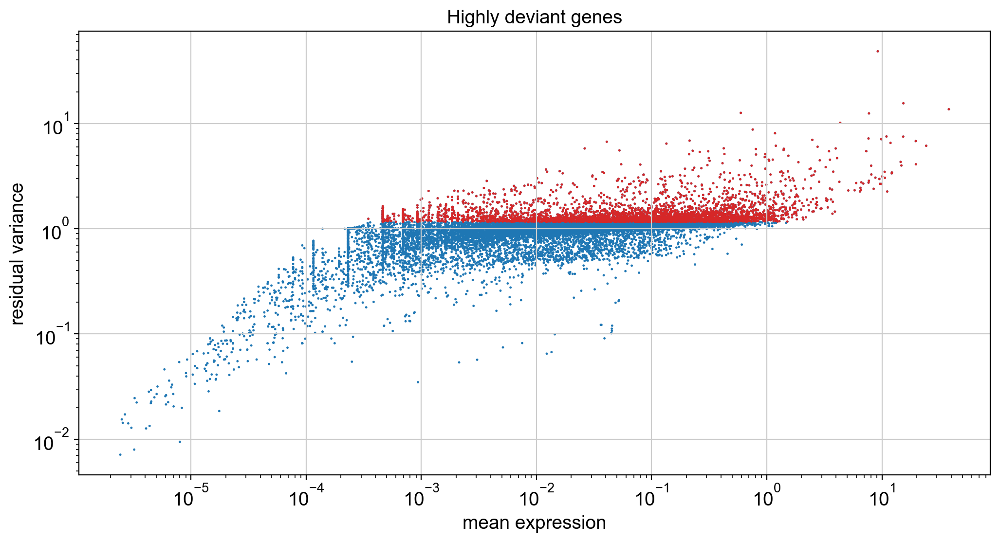

In [47]:
hvgs = adata.var["highly_variable"]

plt.figure(figsize=(12, 6))


plt.scatter(
    adata.var["mean_counts"], adata.var["residual_variances"], s=3, edgecolor="none"
)
plt.scatter(
    adata.var["mean_counts"][hvgs],
    adata.var["residual_variances"][hvgs],
    c="tab:red",
    s=3,
    edgecolor="none",
)

plt.xscale("log")
plt.xlabel("mean expression")
plt.yscale("log")
plt.ylabel("residual variance")
plt.title("Highly deviant genes");
plt.savefig(f"{path_images}/residual_variances.png", bbox_inches="tight");

Analytic Pearson residuals help detect biologically variable genes by comparing observed counts to expected counts in a "null model" without biological variability. Genes with no differential expression have residuals close to 1, while differentially expressed genes deviate from the null model, resulting in larger residuals and variance >1. For more information and comparisons to other gene selection methods, refer to Lause et al. (2021). 

Briefly, the observed counts for a gene in a cell $X_{gene\; per \;cell}$ or $X_{cg}$ can be described using the Poisson distribution around expected average, which is given by count depth $\hat{n}_c = \sum_g X_{cg}$ and probability to observe gene in a cell $\hat{p}_g = \sum_c X_{cg} / \sum_c \hat{n}_c$ :

$\hat{\mu}_{cg} = \frac{\sum_j X_{cj} \cdot \sum_i X_{ig}}{\sum_{ij} X_{ij}}$

The Pearson residuals are calculated as:

$Z_{cg} = \frac{X_{cg} - \hat{\mu}_{cg}}{\sqrt{\hat{\mu}_{cg} + \frac{\hat{\mu}_{cg}^2}{\theta}}}$

where $\hat{\mu}_{cg} + \frac{\hat{\mu}_{cg}^2}{\theta}$ is the negative binomial variance, and as $\theta \rightarrow \infty$, it converges to the Poisson limit.

**The variance of Pearson residuals quantifies how much each gene deviates from this constant-expression model.**

In [48]:
adata_raw = adata_raw[:, adata.var["highly_variable"]]

In [49]:
adata = adata[:, adata.var["highly_variable"]]

In [50]:
print("Top-20 highly variable genes ")
print("-"*40)
adata.var["highly_variable_rank"].sort_values(ascending=True).head(20)

Top-20 highly variable genes 
----------------------------------------


gene_name
H2BC4       0.0
ERBB4       1.0
CCSER1      2.0
H2AC13      3.0
COPG2       4.0
TJP1        5.0
NKAIN2      6.0
CNTNAP2     7.0
DLGAP1      8.0
MT-CO1      9.0
NXPH1      10.0
BLCAP      11.0
NEGR1      12.0
VIM        13.0
DGKI       14.0
SH3TC1     15.0
LSAMP      16.0
KCND2      17.0
IL6ST      18.0
TRABD2A    19.0
Name: highly_variable_rank, dtype: float32

### Check marker genes of a brain organoid
#### PCA

In [51]:
marker_genes = ["MAP2", "ENO2", "FOXG1", "NEUROD6",
                "NEUROD2", "SLC17A7", "DLX5", "DLX2", 
                "DLX1", "GAD1", "GAD2", "SLC32A1", "ISL1",
                "EBF1", "NHLH2", "SLC17A6", "LHX9", "TFAP2B",
                "GBX2", "SHOX2", "PCP4", "RSPO3", "RELN", 
               "GATA3", "OTX2", "SOX14", "GLI3", "EOMES",
               "GRIA2", "CCND2", "POU5F1", "SOX2", "DLK1",
               "HES1", "PAX6", "MKI67", "AQP4"]

highly_var_genes = adata.var.index.to_list()

In [52]:
highly_var_marker_genes = []
for gene in marker_genes:
    if gene in highly_var_genes:
        highly_var_marker_genes.append(gene)
print("Number of marker genes:" , len(marker_genes) )       
print("Number of highly variable marker genes:" , len(highly_var_marker_genes) )       

Number of marker genes: 37
Number of highly variable marker genes: 17


In [53]:
# Here I work with normalized data for a clear picture 
adata_rna = ad.AnnData(adata.layers["log1p_norm"], obs=adata.obs, var=adata.var) 
adata_rna.var.drop(columns=["n_cells_by_counts", "mean_counts", "log1p_mean_counts", "pct_dropout_by_counts", "total_counts", "log1p_total_counts"], inplace=True)

sc.pp.calculate_qc_metrics(
    adata_rna, inplace=True , log1p=False
)

In [54]:
sc.tl.pca(adata_rna, svd_solver='arpack', zero_center=False)


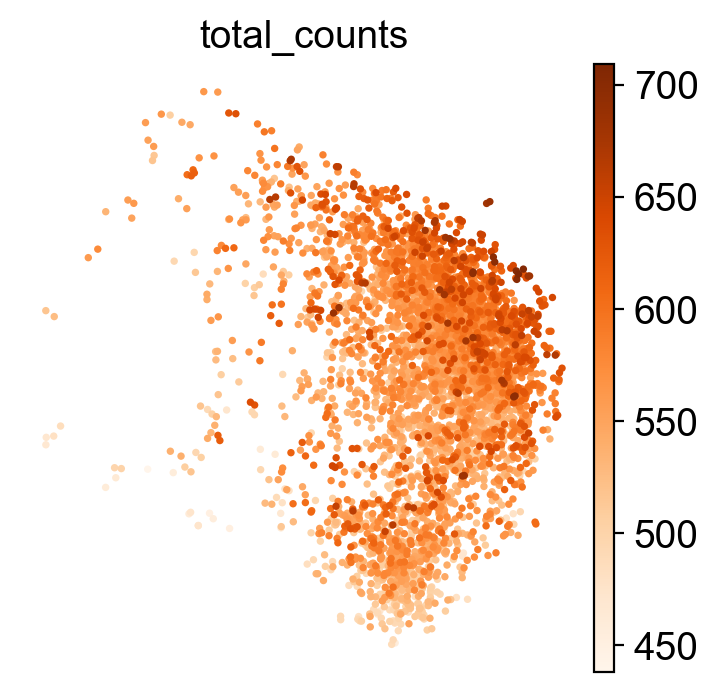

In [55]:
sc.pl.pca(adata_rna,color="total_counts",  cmap="Oranges")

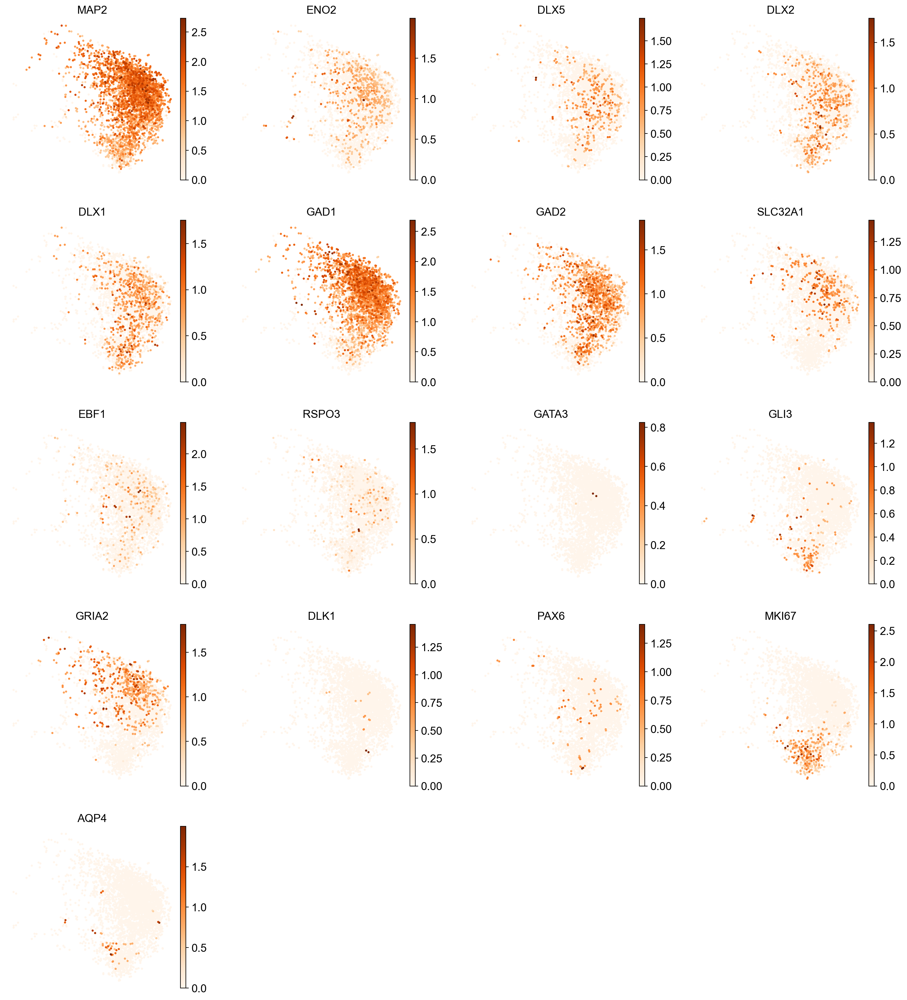

In [56]:
sc.pl.pca(adata_rna,color=highly_var_marker_genes, cmap="Oranges", save="_marker_genes_RNA.png")

#### UMAP

In [57]:
sc.pp.neighbors(adata_rna)
sc.tl.umap(adata_rna, random_state=42)

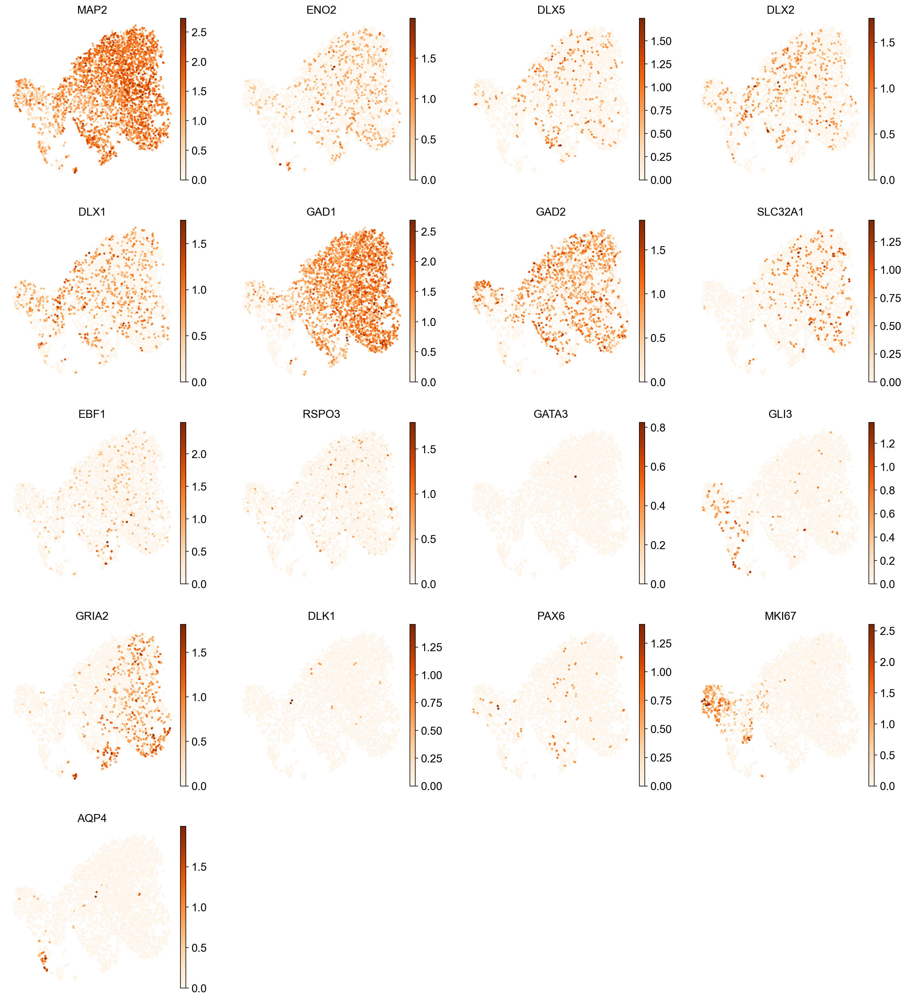

In [68]:
sc.pl.umap(adata_rna, color=highly_var_marker_genes, cmap="Oranges" , save="_marker_genes_RNA.png")

#### t-SNE

In [59]:
sc.tl.tsne(adata_rna, n_pcs=25, use_rep="X_pca", learning_rate=400, random_state=42, n_jobs=4)

/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/scanpy/tools/_tsne.py:105: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(
/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


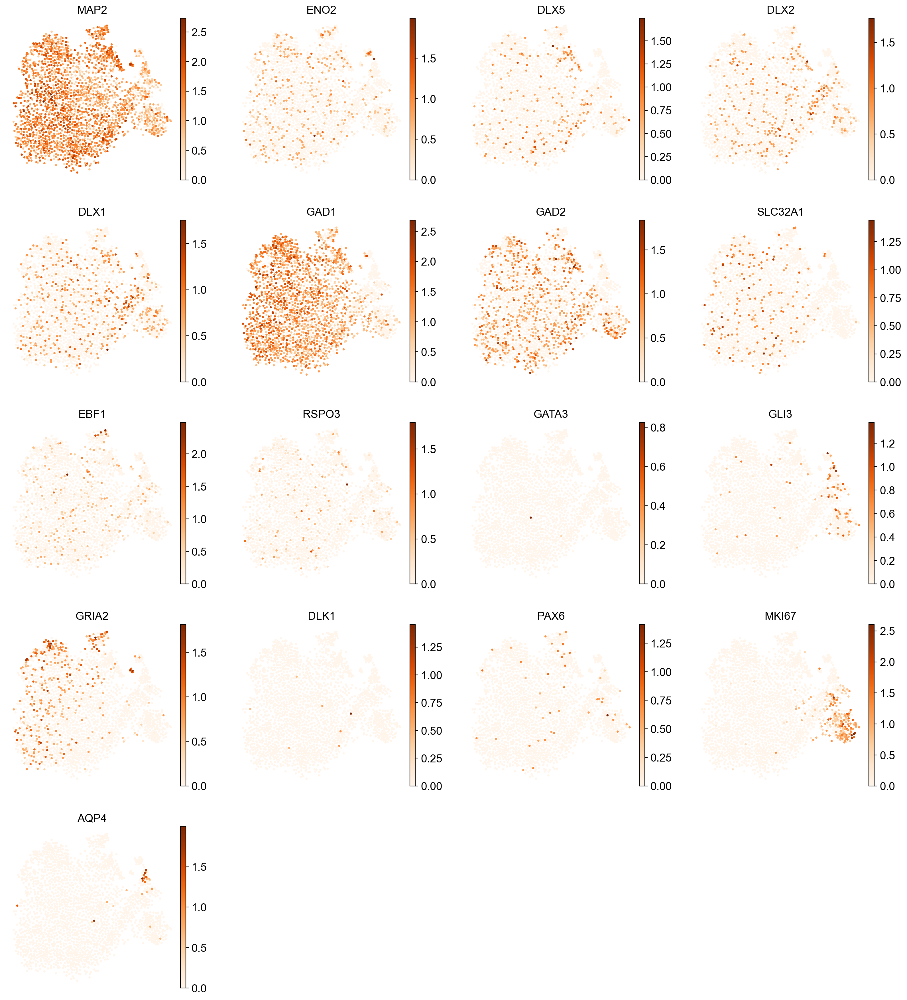

In [69]:
sc.pl.tsne(adata_rna, color=highly_var_marker_genes, cmap="Oranges",save="_marker_genes_RNA.png.png")

In [61]:
# And export again our intermediate results 
adata.write(f"{joined_dir}/processed_rna_data.h5ad")

In [62]:
# If you want to read it back 
# adata = ad.read_h5ad(f"{joined_dir}/processed_rna_data.h5ad")

In [ ]:
# adata.obs_names_make_unique()

## EDA of antibodies sequencing data


In [70]:
ant_names = ["IgM","IgG-Fc","Ig-kappa","Ig-lambda"]
donor_names = ["Donor-1", "Donor-2","Donor-3", "Donor-4"]

In [71]:
# Choose cells which were detected in RNA data
adata_rna = adata.copy()
adata_adt = ant_data.copy()

# We will work with cells that persist in both RNA-seq and antibody data
mdata_prep = MuData({"RNA": adata_rna , "ADT_HTO": adata_adt})
mu.pp.intersect_obs(mdata_prep)
mdata_prep


MuData object with n_obs × n_vars = 4171 × 4008
  2 modalities
    RNA:	4171 x 4000
      obs:	'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'n_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'mt_outlier', 'ribo_outlier'
      var:	'gene_ids', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'ribo', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
      uns:	'hvg'
      layers:	'log1p_norm'
    ADT_HTO:	4171 x 8
      obs:	'barcodes'

In [72]:
# Extract data back, it's convenient to work with them separately on this stage
ant_data = mdata_prep.mod["ADT_HTO"].copy()
ant_data

AnnData object with n_obs × n_vars = 4171 × 8
    obs: 'barcodes'

In [73]:
sc.pp.calculate_qc_metrics(
    ant_data, inplace=True, percent_top=None, log1p=True
)
ant_data

AnnData object with n_obs × n_vars = 4171 × 8
    obs: 'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

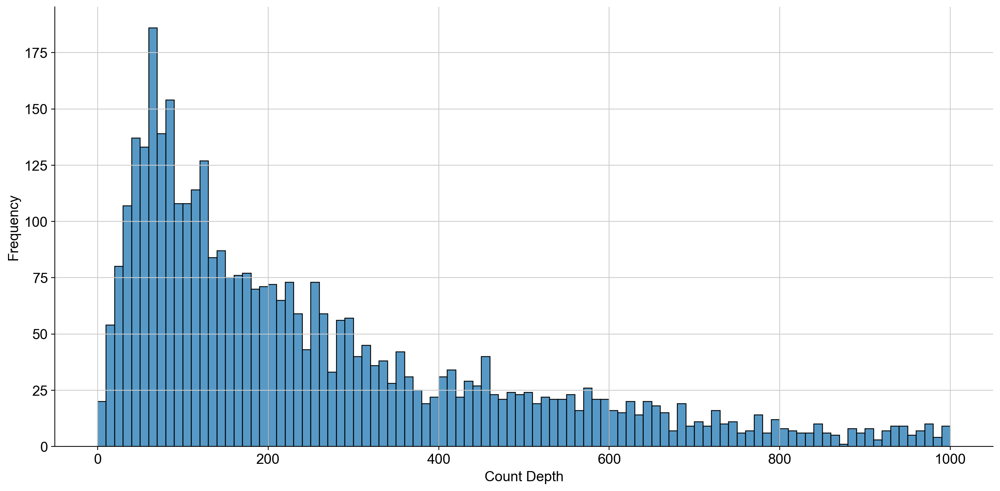

In [74]:
p_sh1 = sns.displot(ant_data.obs["total_counts"], bins=100, kde=False, height=7,aspect=2,binrange=(0, 1000))
p_sh1.set_axis_labels("Count Depth", "Frequency");
plt.savefig(f"{path_images}/total_counts_ant_1.png", bbox_inches="tight");

In [75]:
ant_data.var

,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
groups,,,,,,
IgM,4169,166.803345,5.122793,0.047950,695736.937500,13.452728
IgG-Fc,4001,33.467182,3.540008,4.075761,139591.609375,11.846483
Ig-kappa,4109,51.293964,3.956881,1.486454,213947.218750,12.273489
Ig-lambda,4055,38.149670,3.667392,2.781108,159122.125000,11.977433
Donor-1,2829,28.670916,3.390167,32.174538,119586.390625,11.691803
Donor-2,3034,42.034161,3.761994,27.259650,175324.484375,12.074399
Donor-3,2076,17.393745,2.912011,50.227763,72549.312500,11.192036
Donor-4,1952,17.132589,2.897711,53.200671,71460.031250,11.176908


In [76]:
ant_data.to_df()

groups,IgM,IgG-Fc,Ig-kappa,Ig-lambda,Donor-1,Donor-2,Donor-3,Donor-4
barcodes,,,,,,,,
CATGCCTTCGAGAGCA,436.000000,160.0,173.492874,178.507126,2.0,528.000,0.0,1.000000
GCTCTGTAGACACGAC,1159.000000,102.0,423.682251,197.317749,1.0,1.000,419.0,1.000000
CACATTTGTACCGCTG,2199.000000,341.0,693.000000,451.000000,1.0,1.000,1.0,379.000000
CTTCTCTGTTGTTTGG,2830.251953,547.0,798.790344,727.332886,3.0,1354.625,1.0,0.000000
GCGCGATTCGAATGCT,433.000000,205.0,102.355400,185.644592,3.0,1086.000,0.0,0.000000
...,...,...,...,...,...,...,...,...
ATTGGTGAGATATGCA-1,7.000000,2.0,5.555000,4.445000,0.0,14.000,0.0,0.000000
ACTTACTAGGCTCATT-1,11.000000,7.0,1.000000,2.000000,0.0,9.000,0.0,0.000000
ACTTACTCAACTGGCC-1,5.000000,0.0,0.000000,1.335938,1.0,1.000,0.0,2.664062


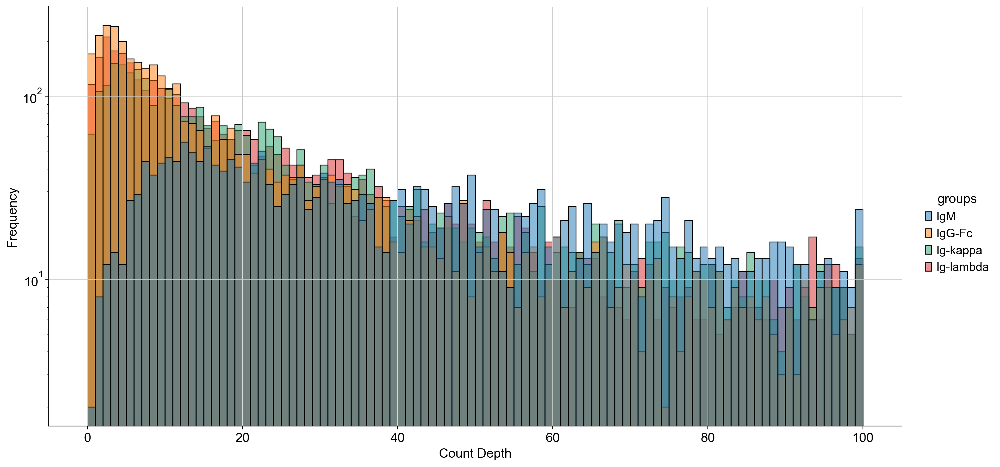

In [77]:
# Antibodies raw distributions

p_sh1 = sns.displot(ant_data.to_df()[ant_names], 
                    bins=100, kde=False, log_scale=(False,True),
                    height=7,aspect=2,binrange=(0, 100))

p_sh1.set_axis_labels("Count Depth", "Frequency");
plt.savefig(f"{path_images}/total_counts_Ig_1.png", bbox_inches="tight");

In [78]:
ant_data.to_df()[ant_names].describe()

groups,IgM,IgG-Fc,Ig-kappa,Ig-lambda
count,4171.000000,4171.000000,4171.000000,4171.000000
mean,166.803345,33.467186,51.293964,38.149666
std,259.734314,57.710358,83.244431,61.544239
min,0.000000,0.000000,0.000000,0.000000
25%,30.000000,4.000000,8.000000,6.000000
50%,76.000000,12.000000,22.000000,17.000000
75%,192.950699,36.000000,59.000000,43.000000
max,2888.000000,703.421448,910.000000,727.332886


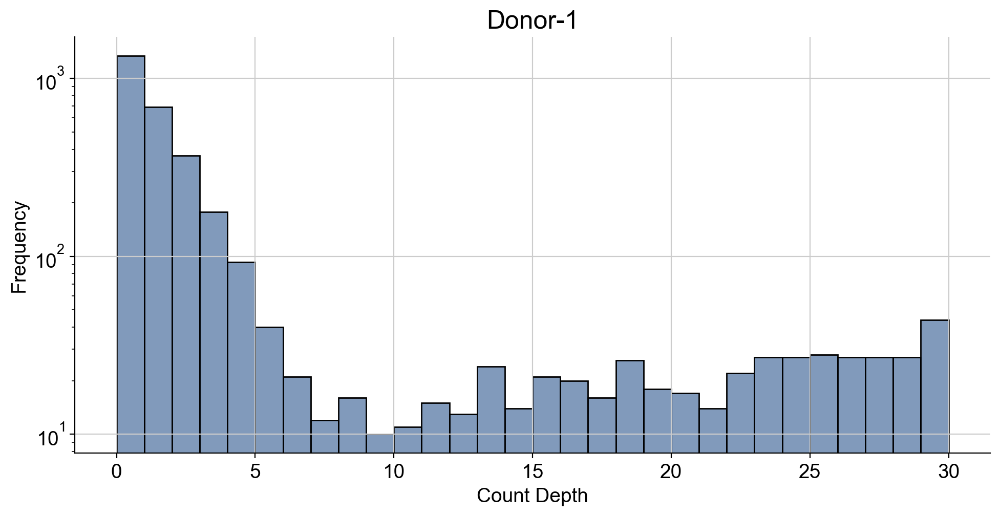

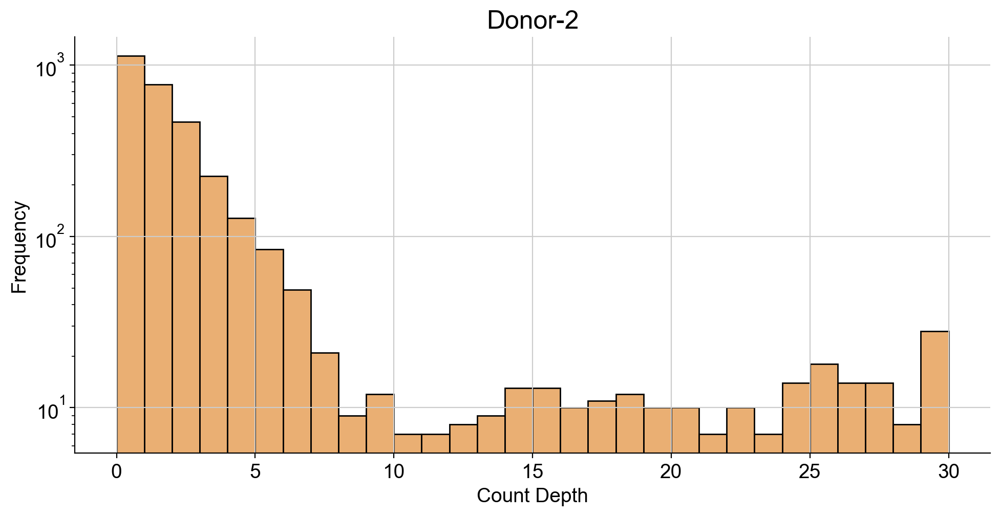

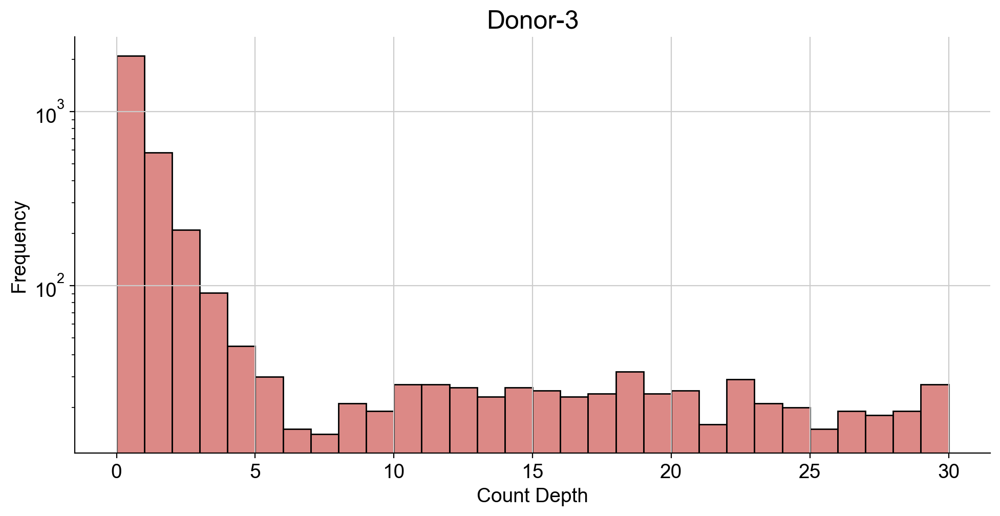

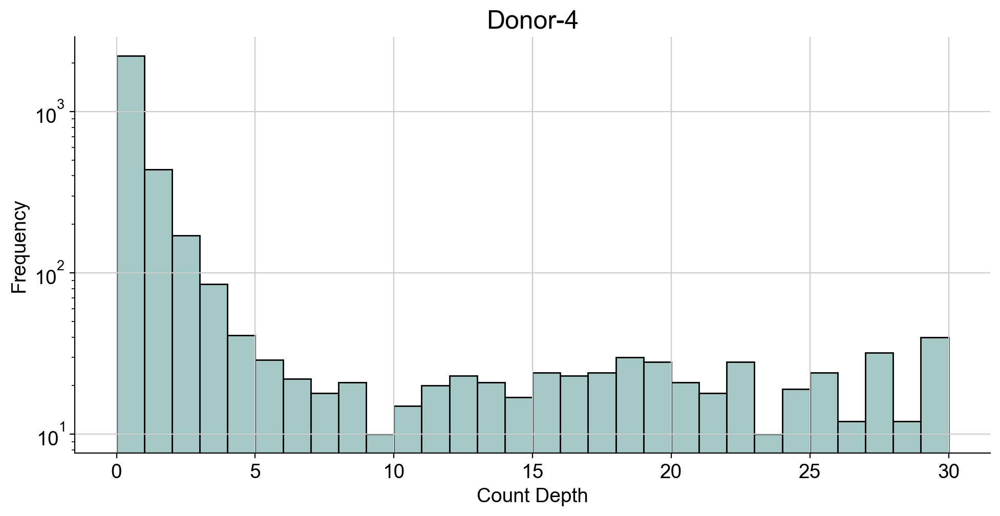

In [79]:
# Donors raw distributions
col = {"Donor-1": "#5778a4",
  "Donor-2": "#e49444",
  "Donor-3": "#d1615d",
  "Donor-4": "#85b6b2"}
for donor in donor_names:
   
    p_sh1 = sns.displot(ant_data.to_df()[donor], 
                        bins=30, kde=False, log_scale=(False,True),
                        color=col[donor],
                        height=5,aspect=2,binrange=(0, 30))
    p_sh1.set_axis_labels("Count Depth", "Frequency");
    plt.title(donor,fontsize=18 )
    plt.savefig(f"{path_images}/total_counts_{donor}.png", bbox_inches="tight");

In [80]:
ant_data.to_df()[donor_names].describe()

groups,Donor-1,Donor-2,Donor-3,Donor-4
count,4171.000000,4171.000000,4171.000000,4171.000000
mean,28.670916,42.034161,17.393745,17.132589
std,73.295761,122.624886,52.553753,50.754990
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000
50%,2.000000,2.000000,0.000000,0.000000
75%,27.000000,30.000000,10.000000,13.000000
max,1181.000000,1869.000000,765.000000,895.000000


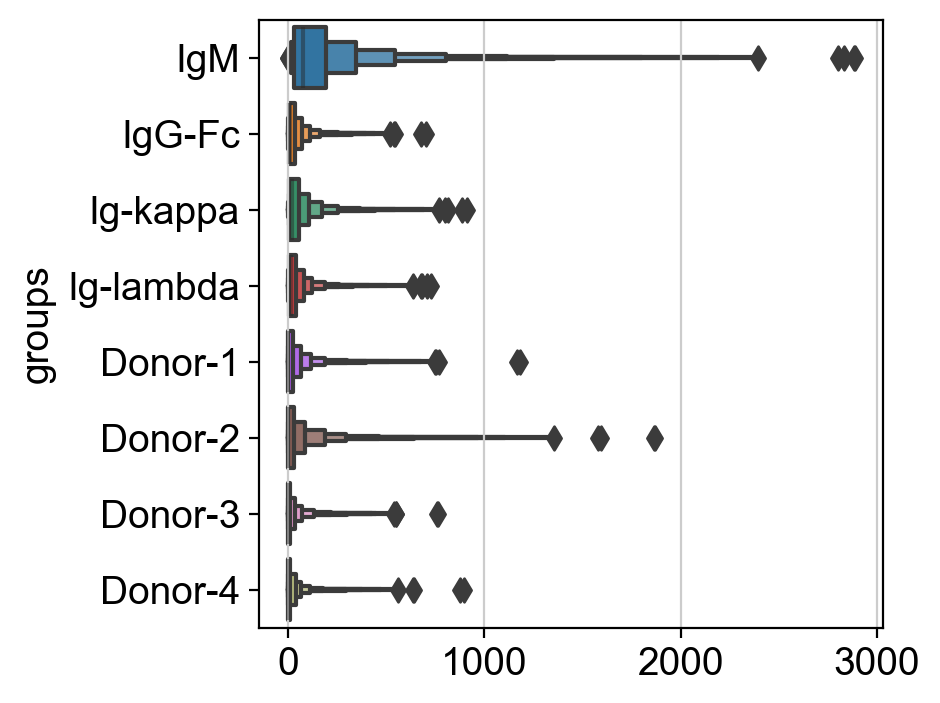

In [81]:
sns.boxenplot(ant_data.to_df(),orient="h");

In summary, in all groups, there are some outliers with exceptionally high expression. Antibodies data (IgM, IgG-Fc, Ig-kappa, Ig-lambda) generally have higher median expression levels and more extreme outliers compared to the cell hashing data (Donor-1, Donor-2, Donor-3, Donor-4). The count distribution for Donor-4 is right-skewed and has the lowest median among all donors. 

### Quality control for antibody data

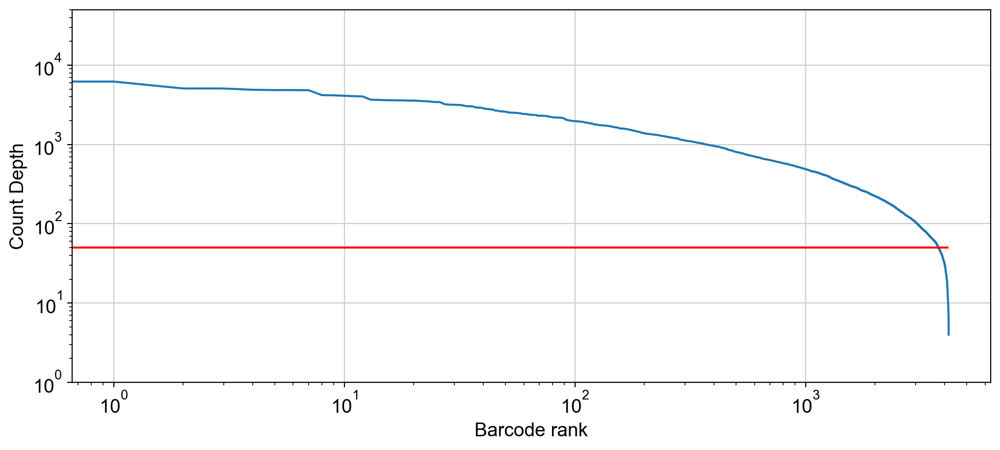

In [82]:
# Carefully here - the threshold is not the same as for RNA-seq data
barcode_threshold_lower = 50

barcodes_ranked_ant = ant_data.obs["total_counts"].sort_values(ascending=False).reset_index()

plt.figure(figsize=(12,5))
plt.plot(barcodes_ranked_ant.index, barcodes_ranked_ant["total_counts"])
plt.hlines(barcode_threshold_lower, 0, len(barcodes_ranked_ant.index), colors='r')
plt.xlabel("Barcode rank")
plt.ylabel("Count Depth")
plt.yscale("log")
plt.xscale("log")
plt.ylim(1,5*10**4)
plt.savefig(f"{path_images}/barcode_rank_ant.png", bbox_inches="tight")
plt.show()

In [83]:
print(f"Total number of cells: {ant_data.n_obs}")

true_data = (ant_data.obs["total_counts"] > barcode_threshold_lower)

ant_data =  ant_data[true_data].copy()

print(f"Number of cells after filtering of low quality cells: {ant_data.n_obs}")

Total number of cells: 4171
Number of cells after filtering of low quality cells: 3761


Check distributions after QC

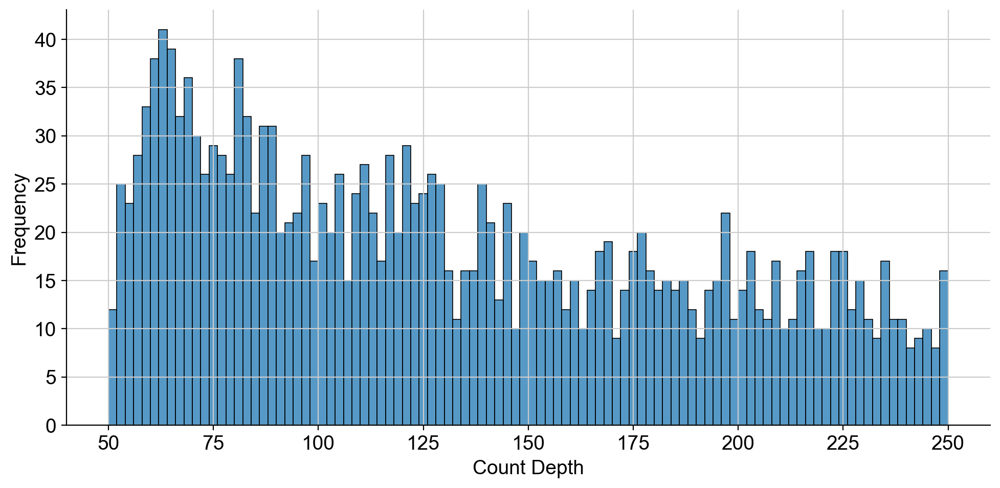

In [84]:
p_sh1 = sns.displot(ant_data.obs["total_counts"], bins=100, kde=False, height=5,aspect=2,binrange=(barcode_threshold_lower, barcode_threshold_lower+200))
p_sh1.set_axis_labels("Count Depth", "Frequency");

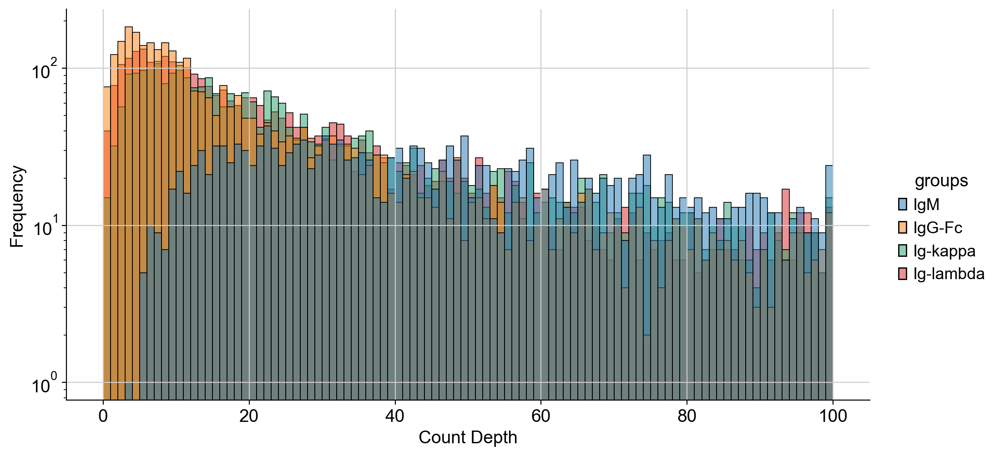

In [85]:
p_sh1 = sns.displot(ant_data.to_df()[["IgM", "IgG-Fc","Ig-kappa","Ig-lambda"]], 
                    bins=100, kde=False, log_scale=(False,True),
                    height=5,aspect=2,binrange=(0, 100))
p_sh1.set_axis_labels("Count Depth", "Frequency");
plt.savefig(f"{path_images}/total_counts_Ig_2.png", bbox_inches="tight");

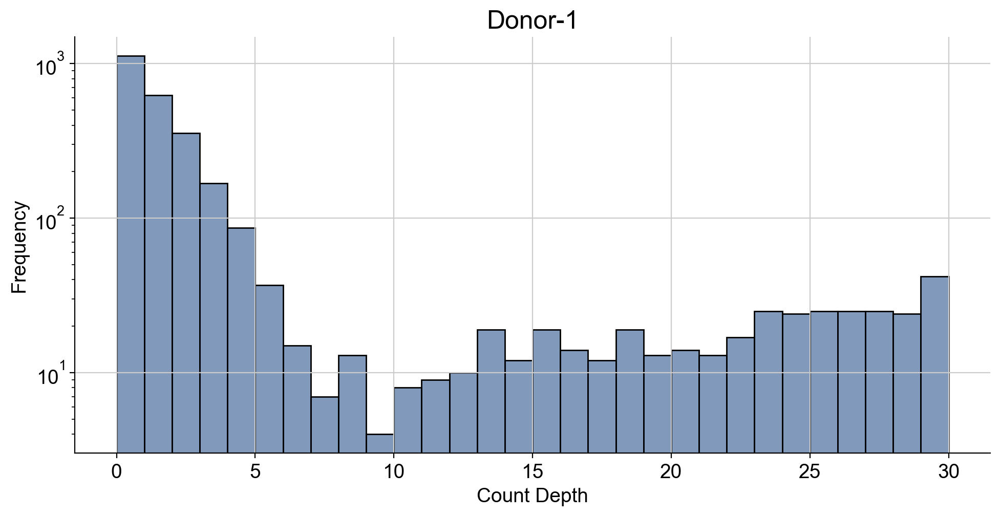

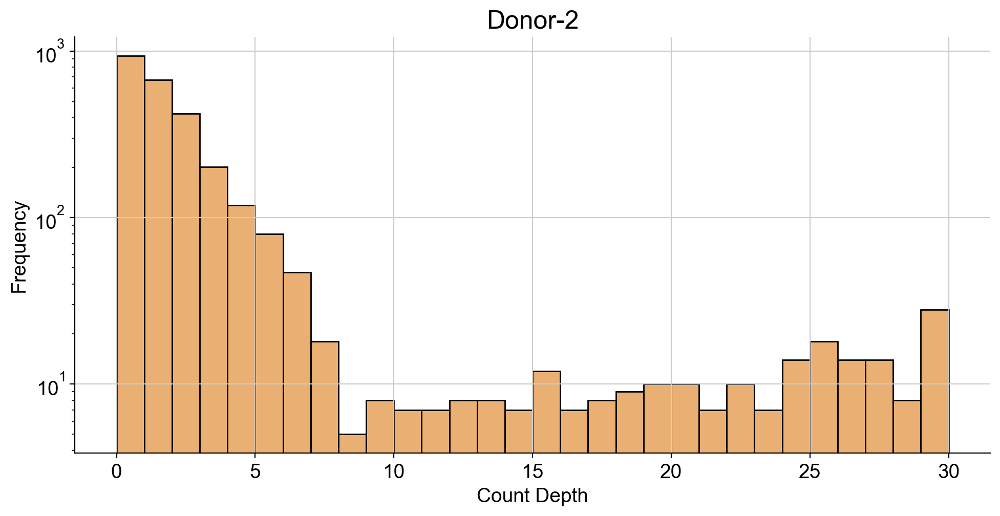

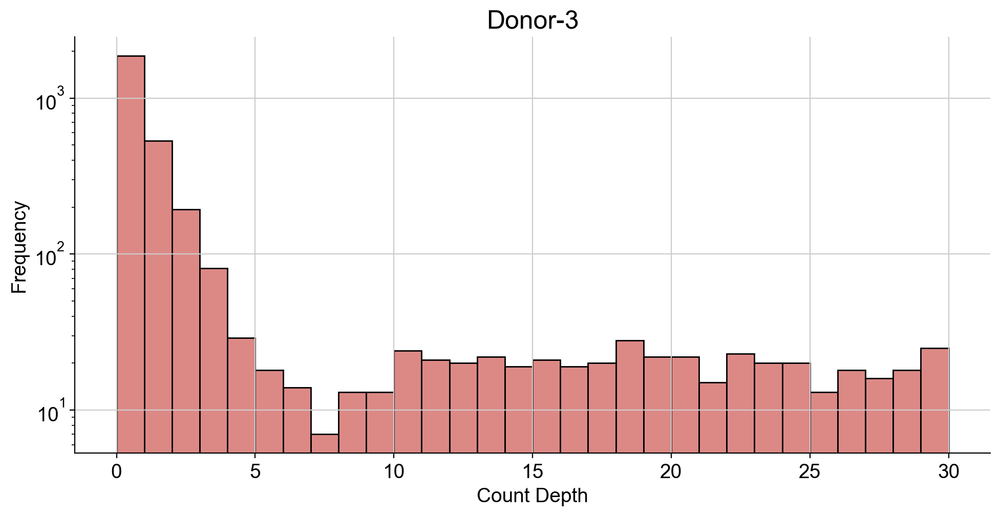

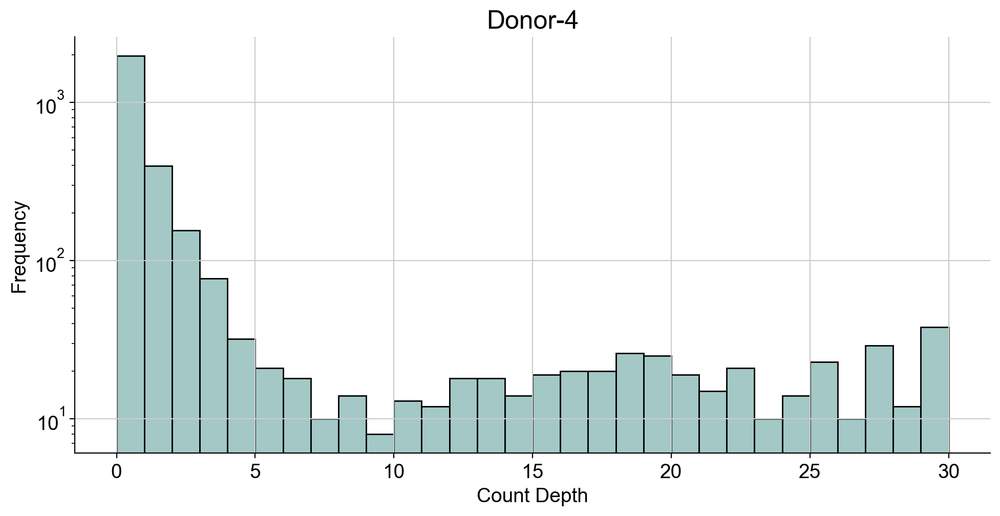

In [86]:
# Donors raw distributions

for donor in donor_names:
   
    p_sh1 = sns.displot(ant_data.to_df()[donor], 
                        bins=30, kde=False, log_scale=(False,True),
                        color=col[donor],
                        height=5,aspect=2,binrange=(0, 30))
    p_sh1.set_axis_labels("Count Depth", "Frequency");
    plt.title(donor,fontsize=18 )
    plt.savefig(f"{path_images}/total_counts_{donor}.png", bbox_inches="tight");

Look at log-scaled counts for antibodies 

In [87]:
scales_counts = sc.pp.normalize_total(ant_data, target_sum=None, inplace=False)
ant_norm_df = ad.AnnData(sc.pp.log1p(scales_counts["X"], copy=True), obs=ant_data.obs, var=ant_data.var).to_df() 

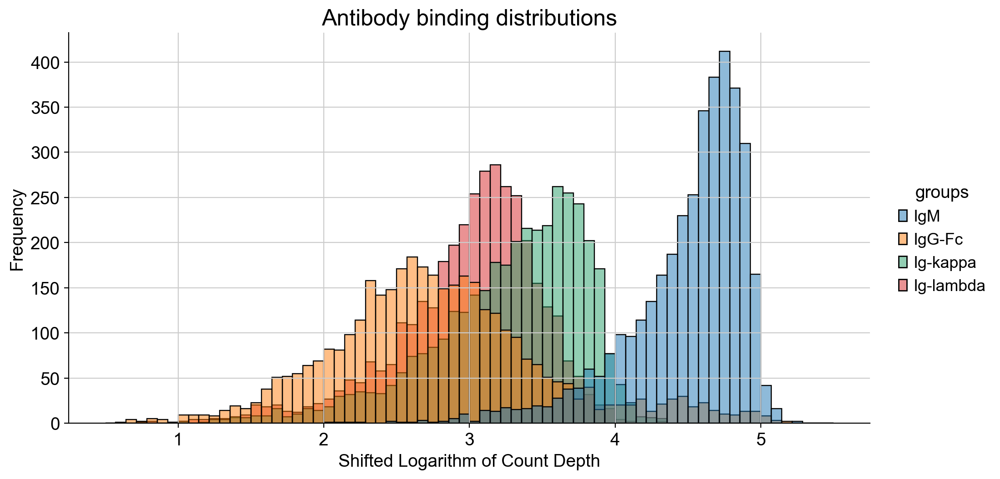

In [88]:
p2 = sns.displot(ant_norm_df[ant_names], bins=70, kde=False, binrange=(0.5, 5.5), height=5,aspect=2,)
p2.set_axis_labels("Shifted Logarithm of Count Depth", "Frequency");
plt.title("Antibody binding distributions",fontsize=18 )
plt.savefig(f"{path_images}/total_counts_norm_Ig.png", bbox_inches="tight");
plt.show()

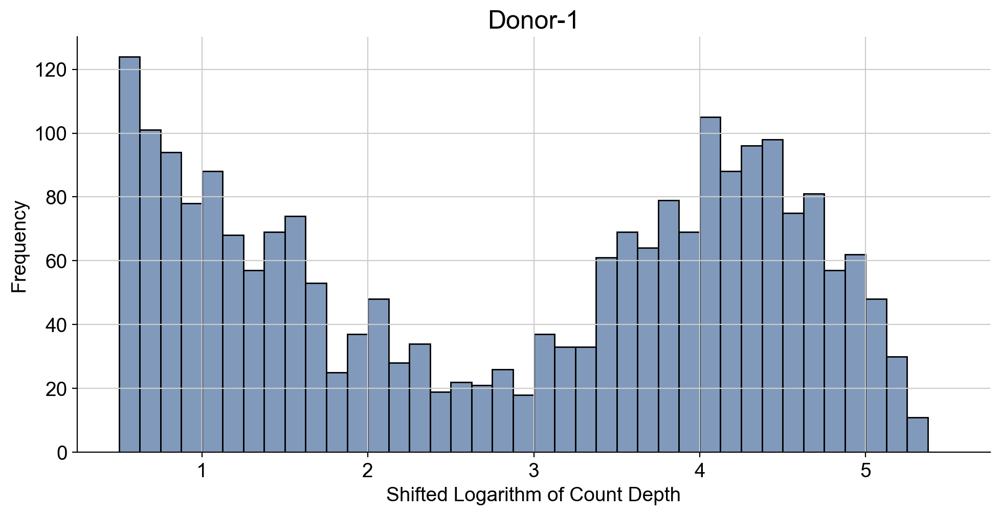

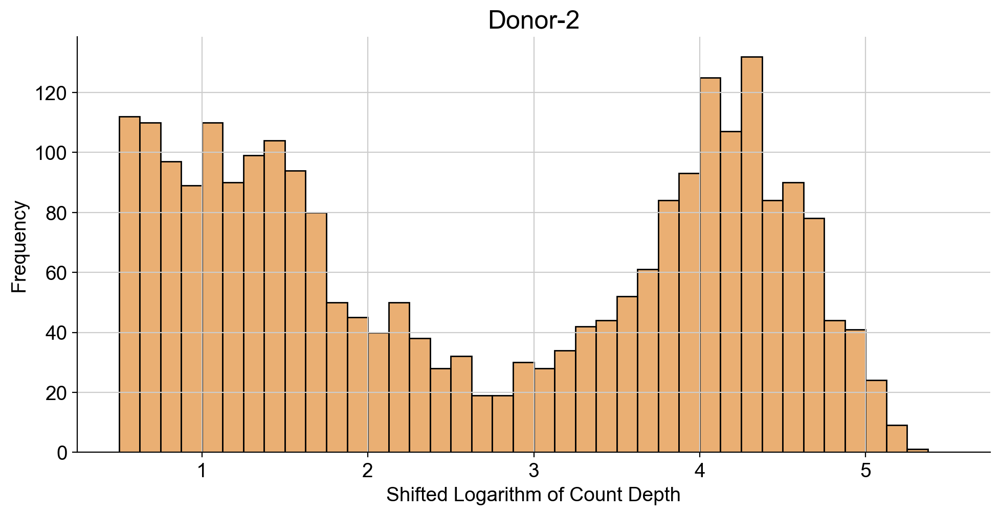

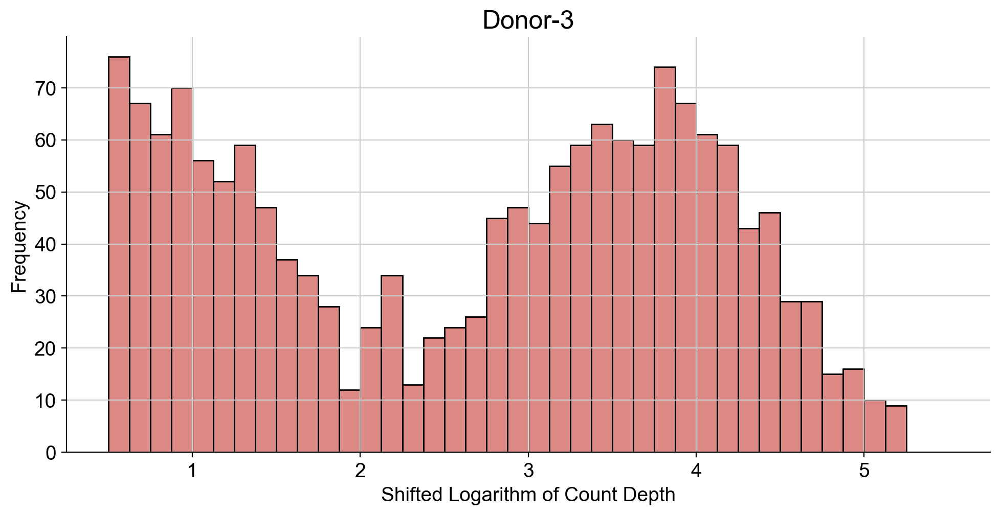

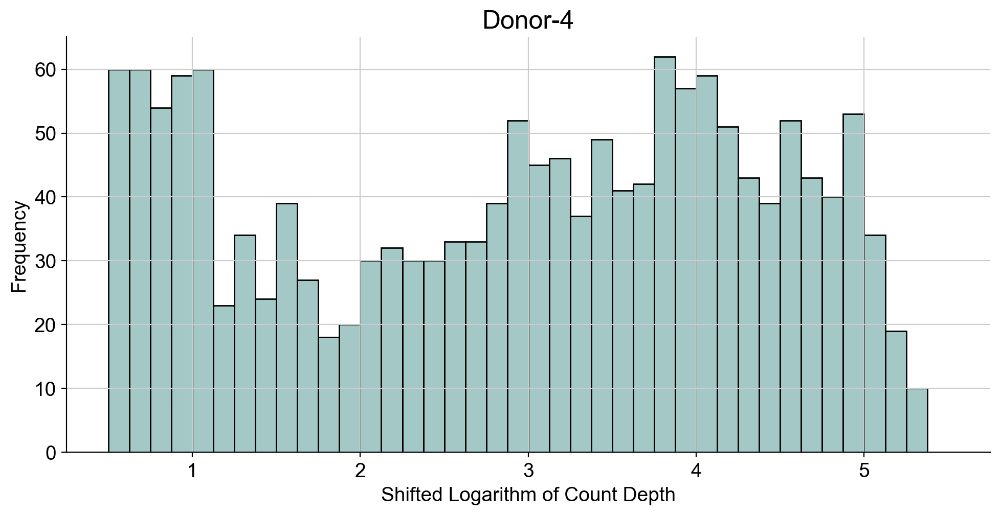

In [89]:
for donor in donor_names:
    p2 = sns.displot(ant_norm_df[donor],
                     bins=40, kde=False,
                     color=col[donor],
                     binrange=(0.5, 5.5),
                     height=5,aspect=2,)
    p2.set_axis_labels("Shifted Logarithm of Count Depth", "Frequency");
    plt.title(f"{donor}",fontsize=18 )
    #plt.savefig(f"{path_images}/total_counts_norm_{donor}.png", bbox_inches="tight");
    plt.show()

Looks like more quality control needs to be done for the donors data. **I will filter out points with count depth threshold individually for each donor**.


In [90]:
donors_thresholds = {"Donor-1":9, "Donor-2":8, "Donor-3":7,"Donor-4":9}


for name in donor_names:
    ant_data.obs[f"{name}_outlier"] = (ant_data.to_df()[name]< donors_thresholds[name]) 
    
for name in donor_names:
    print(f"Number of {name} outliers:", (ant_data.obs[f"{name}_outlier"]==True).sum())
    print(f"Number of {name} true data:", (ant_data.obs[f"{name}_outlier"]==False).sum())
    print("-"*50)

Number of Donor-1 outliers: 2433
Number of Donor-1 true data: 1328
--------------------------------------------------
Number of Donor-2 outliers: 2497
Number of Donor-2 true data: 1264
--------------------------------------------------
Number of Donor-3 outliers: 2741
Number of Donor-3 true data: 1020
--------------------------------------------------
Number of Donor-4 outliers: 2704
Number of Donor-4 true data: 1057
--------------------------------------------------


If a donor is outlier, I assign its counts to 0.  

In [91]:
ant_data_df = ant_data.to_df()
    
ant_data_df.loc[ant_data.obs["Donor-1_outlier"], "Donor-1"] = 0.
ant_data_df.loc[ant_data.obs["Donor-2_outlier"], "Donor-2"] = 0.
ant_data_df.loc[ant_data.obs["Donor-3_outlier"], "Donor-3"] = 0.
ant_data_df.loc[ant_data.obs["Donor-4_outlier"], "Donor-4"] = 0.


ant_data_df

groups,IgM,IgG-Fc,Ig-kappa,Ig-lambda,Donor-1,Donor-2,Donor-3,Donor-4
barcodes,,,,,,,,
CATGCCTTCGAGAGCA,436.000000,160.0,173.492874,178.507126,0.0,528.000,0.0,0.0
GCTCTGTAGACACGAC,1159.000000,102.0,423.682251,197.317749,0.0,0.000,419.0,0.0
CACATTTGTACCGCTG,2199.000000,341.0,693.000000,451.000000,0.0,0.000,0.0,379.0
CTTCTCTGTTGTTTGG,2830.251953,547.0,798.790344,727.332886,0.0,1354.625,0.0,0.0
GCGCGATTCGAATGCT,433.000000,205.0,102.355400,185.644592,0.0,1086.000,0.0,0.0
...,...,...,...,...,...,...,...,...
AAAGATGCATAAAGGT-1,28.000000,3.0,10.384127,4.615873,0.0,0.000,0.0,11.0
ACTTACTAGGATGGTC-1,27.000000,3.0,4.739651,1.664178,10.0,0.000,0.0,0.0
ATTGGACTCACGCATA-1,23.000000,12.0,8.401042,9.598958,0.0,17.000,0.0,0.0


In [92]:
# Recreate an anndata object

original_obs = ant_data.obs.copy() 

antibody_data = sc.AnnData(ant_data_df, original_obs, ant_data_df.columns.to_frame())

In [93]:
antibody_data

AnnData object with n_obs × n_vars = 3761 × 8
    obs: 'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'Donor-1_outlier', 'Donor-2_outlier', 'Donor-3_outlier', 'Donor-4_outlier'
    var: 'groups'

In [94]:
sc.pp.calculate_qc_metrics(
    antibody_data, inplace=True, percent_top=None, log1p=True
)
antibody_data.var

,groups,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
groups,,,,,,,
IgM,IgM,3761,183.774048,5.219134,0.000000,691174.187500,13.446149
IgG-Fc,IgG-Fc,3685,36.885830,3.634577,2.020739,138727.609375,11.840275
Ig-kappa,Ig-kappa,3746,56.521645,4.052161,0.398830,212577.906250,12.267069
Ig-lambda,Ig-lambda,3721,42.055176,3.762482,1.063547,158169.515625,11.971429
Donor-1,Donor-1,1328,30.635326,3.454274,64.690242,115219.460938,11.654603
Donor-2,Donor-2,1264,45.530018,3.840098,66.391917,171238.390625,12.050817
Donor-3,Donor-3,1020,18.503141,2.970576,72.879553,69590.312500,11.150395
Donor-4,Donor-4,1057,18.196026,2.954703,71.895772,68435.250000,11.133658


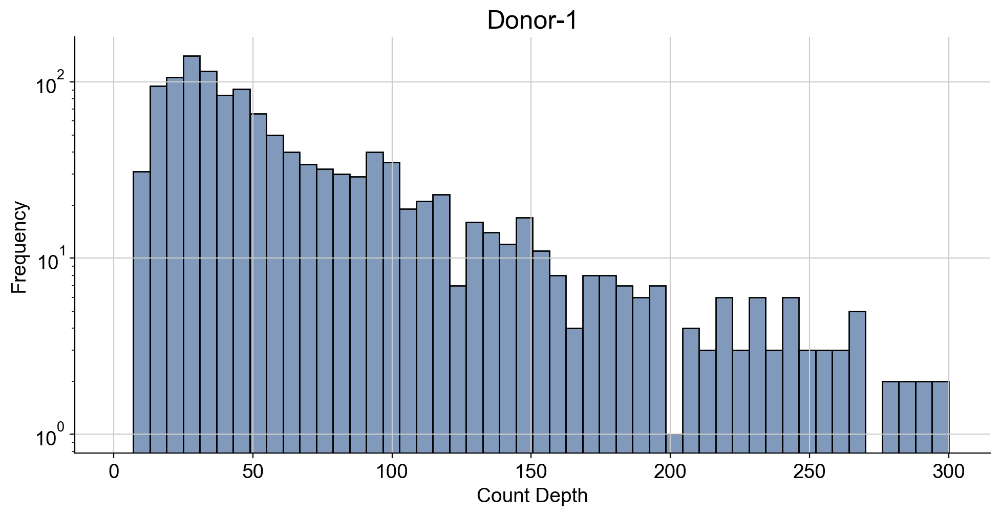

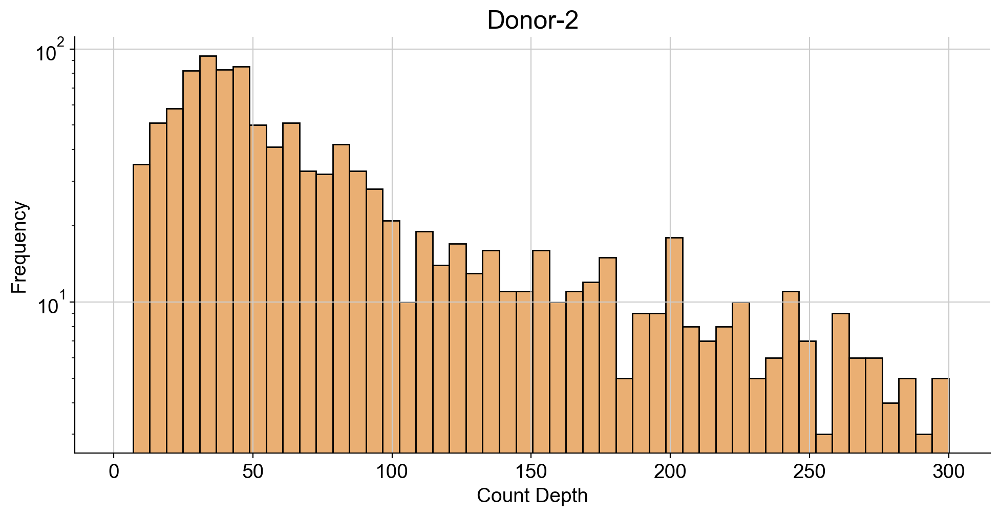

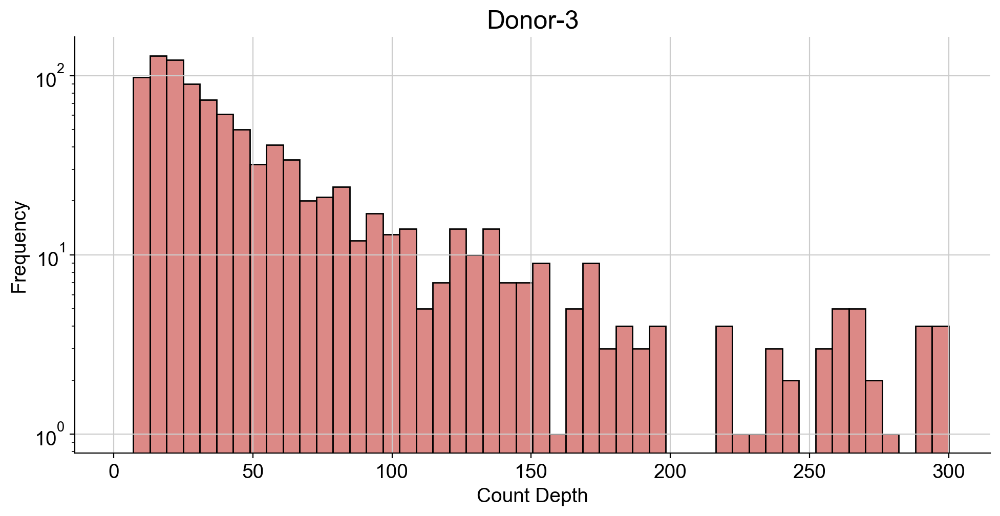

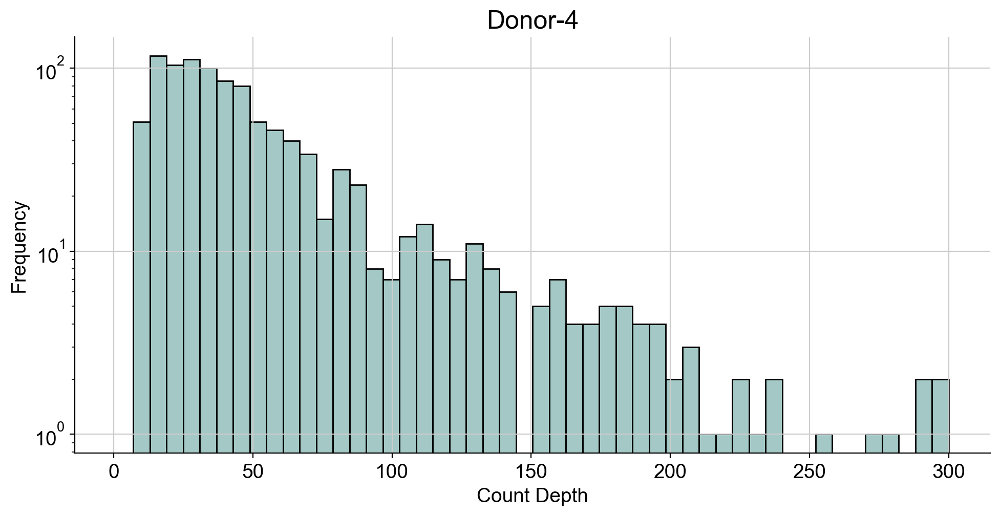

In [95]:

for donor in donor_names:
   
    p_sh1 = sns.displot(antibody_data.to_df()[donor], 
                        bins=50, kde=False, log_scale=(False,True),
                        color=col[donor],
                        height=5,aspect=2,binrange=(1, 300))
    p_sh1.set_axis_labels("Count Depth", "Frequency");
    plt.title(donor,fontsize=18 )
    plt.savefig(f"{path_images}/total_counts_{donor}_2.png", bbox_inches="tight");

### Doublet Detection 

#### Heterogeneous Doublet Detection

When several cells from *different donors* are in the same droplet (a.k.a. doublet), sequencing results may be misrepresented and spoil the analysis.  

If we have > 0 counts for any 2 donors, it must be a doublet and we filter it out. 



In [96]:
doublet_indexes = set()
ant_df = antibody_data.to_df()

for donor_1 in donor_names:
    for donor_2 in donor_names: 
        if donor_1!=donor_2:
            list_of_indexes = ant_df[(ant_df[donor_1] > donors_thresholds[donor_1]) & (ant_df[donor_2] > donors_thresholds[donor_2]) ].index.to_list()
            for j in range(len(list_of_indexes)):
                doublet_indexes.add(list_of_indexes[j])

In [97]:
# To filter out cells with zero counts for all donors
list_of_indexes = ant_df[(ant_df["Donor-1"]==0.)&(ant_df["Donor-2"]==0.)&(ant_df["Donor-3"]==0.)&(ant_df["Donor-4"]==0.)].index.to_list()
for j in range(len(list_of_indexes)): 
    doublet_indexes.add(list_of_indexes[j])

In [98]:
print(f"Number of doublets: {len(doublet_indexes)}")

Number of doublets: 926


In [99]:
antibody_data.obs["doublet"] = antibody_data.obs.index.isin(doublet_indexes)
antibody_data.obs

,barcodes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,Donor-1_outlier,Donor-2_outlier,Donor-3_outlier,Donor-4_outlier,doublet
barcodes,,,,,,,,,,
CATGCCTTCGAGAGCA,CATGCCTTCGAGAGCA,5,1.791759,1476.000000,7.297768,True,False,True,True,False
GCTCTGTAGACACGAC,GCTCTGTAGACACGAC,5,1.791759,2301.000000,7.741534,True,True,False,True,False
CACATTTGTACCGCTG,CACATTTGTACCGCTG,5,1.791759,4063.000000,8.309923,True,True,True,False,False
CTTCTCTGTTGTTTGG,CTTCTCTGTTGTTTGG,5,1.791759,6258.000000,8.741776,True,False,True,True,False
GCGCGATTCGAATGCT,GCGCGATTCGAATGCT,5,1.791759,2012.000000,7.607381,True,False,True,True,False
...,...,...,...,...,...,...,...,...,...,...
AAAGATGCATAAAGGT-1,AAAGATGCATAAAGGT,5,1.791759,57.000000,4.060443,True,True,True,False,False
ACTTACTAGGATGGTC-1,ACTTACTAGGATGGTC,5,1.791759,46.403828,3.858703,False,True,True,True,False
ATTGGACTCACGCATA-1,ATTGGACTCACGCATA,5,1.791759,70.000000,4.262680,True,False,True,True,False


In [100]:
print(f"Total number of cells: {antibody_data.n_obs}")

antibody_data =  antibody_data[~antibody_data.obs["doublet"]].copy()

print(f"Number of cells after filtering of low quality cells: {antibody_data.n_obs}")

Total number of cells: 3761
Number of cells after filtering of low quality cells: 2835


In [101]:
# To save names for convenience
ant_data = antibody_data.copy()
ant_data

AnnData object with n_obs × n_vars = 2835 × 8
    obs: 'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'Donor-1_outlier', 'Donor-2_outlier', 'Donor-3_outlier', 'Donor-4_outlier', 'doublet'
    var: 'groups', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [102]:
# Preserve original counts in a layer before the normalisation
ant_data_raw = ant_data.copy()

ant_data_raw.write(f"{joined_dir}/ant_data_qc.h5ad")

### Normalization of antibody data

In [103]:
scales_counts = sc.pp.normalize_total(ant_data, target_sum=None, inplace=False)
# log1p transform
ant_data.layers["log1p_norm"] = sc.pp.log1p(scales_counts["X"], copy=True)

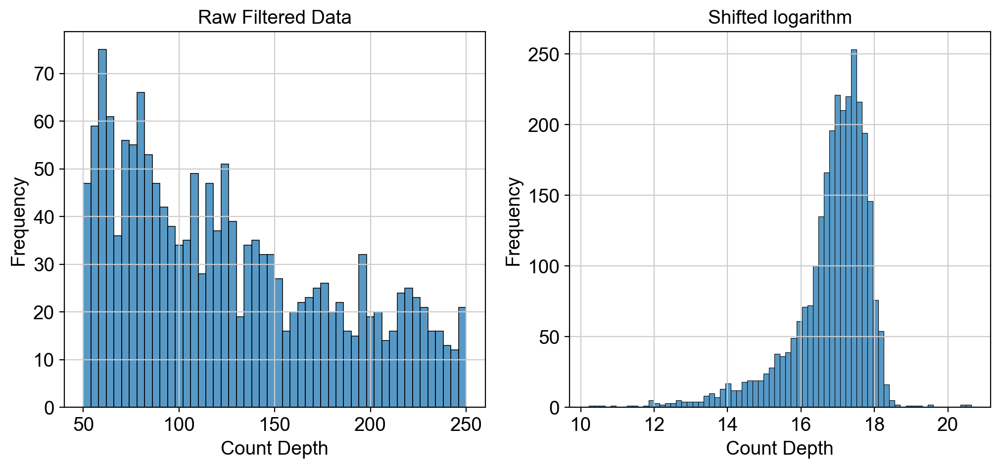

In [104]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
# adata.obs["total_counts"] is the same as adata.X.sum(1)
p1 = sns.histplot(ant_data.obs["total_counts"], 
                  bins=barcode_threshold_lower, 
                  kde=False, ax=axes[0],
                  binrange=(barcode_threshold_lower, barcode_threshold_lower+200))

p1.set_title("Raw Filtered Data")
axes[0].set_xlabel("Count Depth")
axes[0].set_ylabel("Frequency")

# adata.layers["log1p_norm"].sum(1) gives a sum of each row - which is total counts (a.k.a. count depth)
p2 = sns.histplot(ant_data.layers["log1p_norm"].sum(1), bins=70, kde=False, ax=axes[1])
axes[1].set_title("Shifted logarithm")
axes[1].set_xlabel("Count Depth")
axes[1].set_ylabel("Frequency")
plt.savefig(f"{path_images}/total_counts_norm_ant.png", bbox_inches="tight");
plt.show()

In [105]:
ant_data = ad.AnnData(ant_data.layers["log1p_norm"], obs=ant_data.obs, var=ant_data.var) 

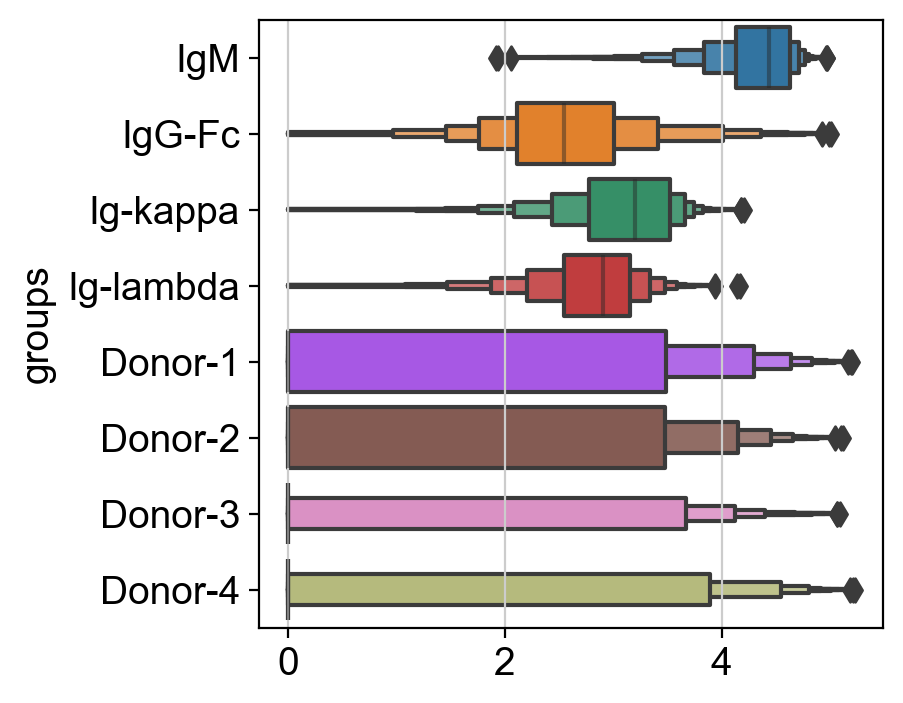

In [106]:
sns.boxenplot(ant_data.to_df(),orient="h",k_depth="trustworthy");
plt.savefig(f"{path_images}/boxenplot_norm_ant.png", bbox_inches="tight");

Aggregated distribution for antibodies (without cell hashing)

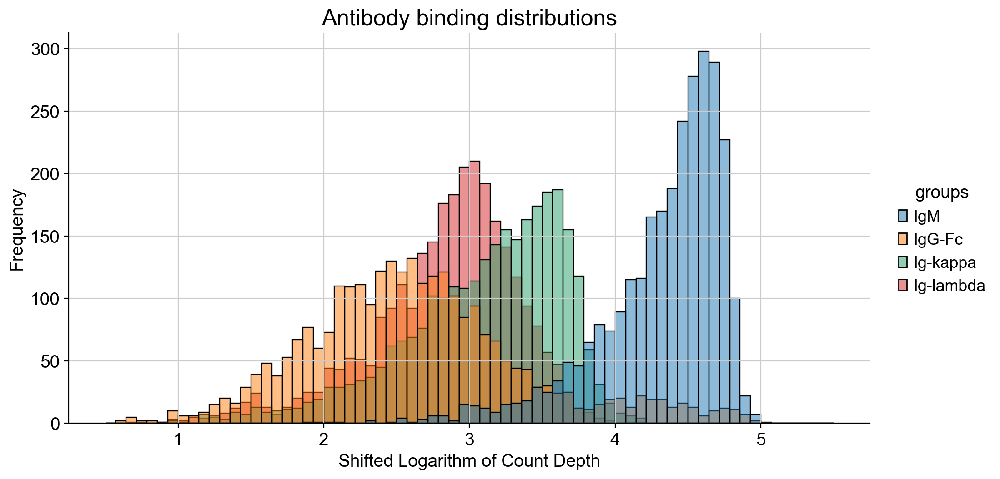

In [107]:
p2 = sns.displot(ant_data.to_df()[ant_names], bins=70, kde=False, binrange=(0.5, 5.5), height=5,aspect=2,)
p2.set_axis_labels("Shifted Logarithm of Count Depth", "Frequency");
plt.title("Antibody binding distributions",fontsize=18 )
plt.savefig(f"{path_images}/total_counts_norm_Ig.png", bbox_inches="tight");
plt.show()

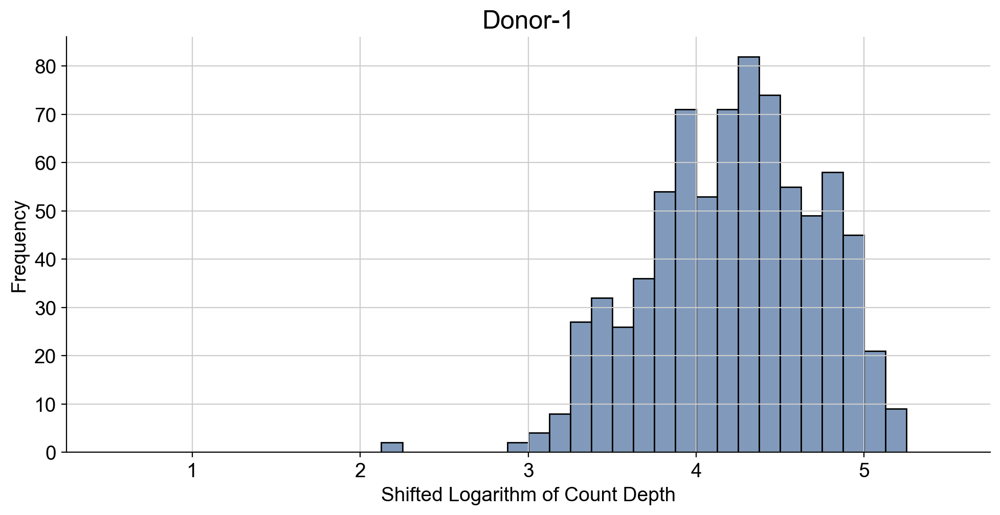

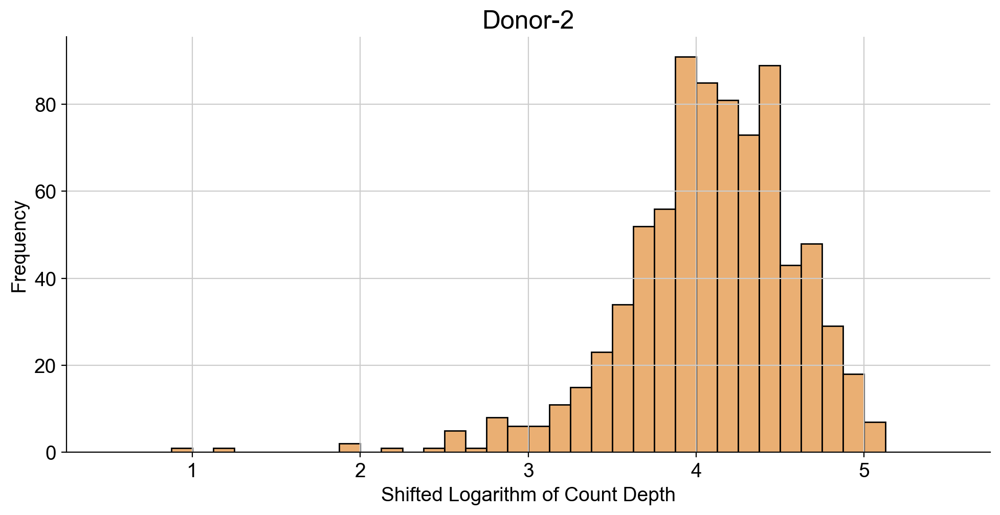

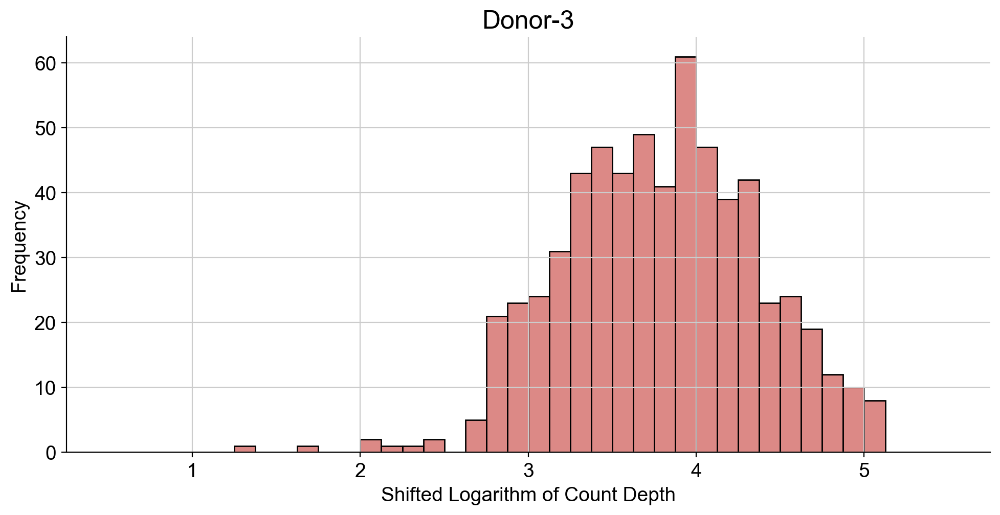

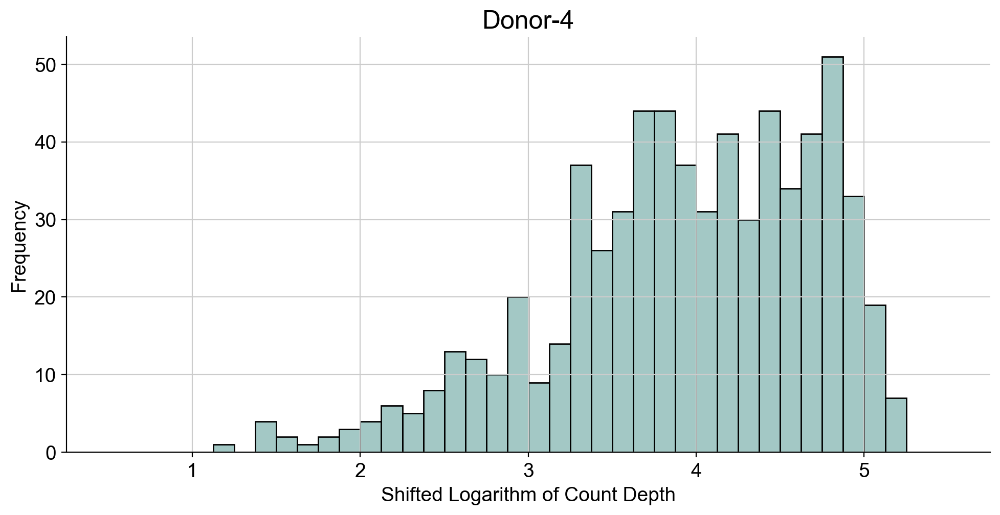

In [108]:
for donor in donor_names:
    p2 = sns.displot(ant_data.to_df()[donor],
                     bins=40, kde=False,
                     color=col[donor],
                     binrange=(0.5, 5.5),
                     height=5,aspect=2,)
    p2.set_axis_labels("Shifted Logarithm of Count Depth", "Frequency");
    plt.title(f"{donor}",fontsize=18 )
    plt.savefig(f"{path_images}/total_counts_norm_{donor}.png", bbox_inches="tight");
    plt.show()

In [109]:
# # Recreate an anndata object

# original_obs = ant_data.obs.copy() 

# antibody_data = sc.AnnData(ant_data_df, original_obs, ant_data_df.columns.to_frame())

In [110]:
# sc.pp.calculate_qc_metrics(
#     antibody_data, inplace=True, percent_top=None, log1p=True
# )
# antibody_data.var

In [111]:
# Save antibody normalized data
ant_data.write(f"{joined_dir}/adt_hto/ant_normalized.h5ad")

In [112]:
# If you want to upload data at this stage
#adata = ad.read_h5ad(f"{joined_dir}/processed_rna_data.h5ad")\\

In [113]:
#adata.obs_names_make_unique()

## Dimensionality reduction of antibody data

#### PCA

In [119]:
# Again, I take an intersection of the data, but now without doublets and with normalized antibody counts.

mdata_prep = MuData({"RNA": adata_rna.copy() , "ADT_HTO": ant_data.copy() })
mu.pp.intersect_obs(mdata_prep)

ant_data_dr = mdata_prep["ADT_HTO"].copy()

In [120]:
sc.tl.pca(ant_data_dr, svd_solver='arpack', zero_center=False)

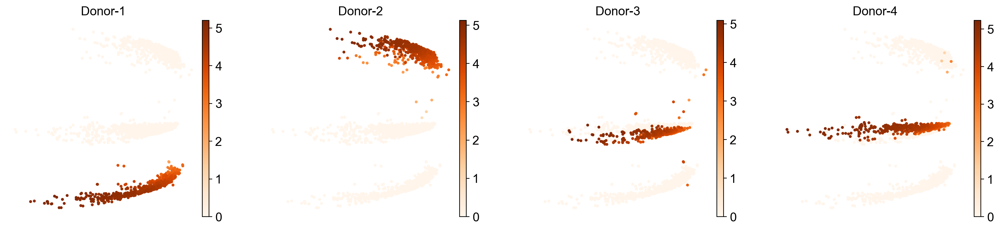

In [121]:
sc.pl.pca(ant_data_dr,color=donor_names, color_map="Oranges", save="_ant_donors.png") 

#### UMAP

In [122]:
sc.pp.neighbors(ant_data_dr)
sc.tl.umap(ant_data_dr, random_state=42)

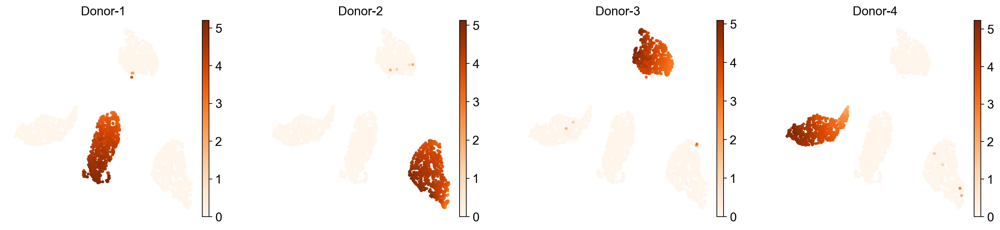

In [123]:
sc.pl.umap(ant_data_dr, color=donor_names, color_map="Oranges", save="_ant_donors.png") 

---
#### Read the data back

In [ ]:
# adata_rna = ad.read_h5ad(f"{joined_dir}/processed_singlet_data.h5ad")
# ant_data = ad.read_h5ad(f"{joined_dir}/adt_hto/ant_singlet.h5ad")

In [ ]:
# adata_rna.obs_names_make_unique()

In [ ]:
# adata_rna

In [ ]:
# ant_data.obs_names_make_unique()

In [ ]:
# ant_data

## Combine the data: keep cells which belong to both scRNA and antibodies

Before dimensionality reduction, I join our processed RNA data with antibody data in one so-called MuData object, which was already used above. Here I want to explain a little bit more how it works. 

**Observations with the same name**: If you have observations with the same name in different groups (let's call them "modalities"), the MuData object treats them as if they are the same observation. It's like saying if you see the same name in different groups, we think of it as one thing, even though it's in different places.

**Unique variable names**: On the other hand, variable names need to be unique. We can't have two different types of information with the same name. Each variable name should represent only one specific type of data.



Names for antibodies: "IgM", "IgG-Fc", "Ig-kappa", "Ig-lambda"

Names for donors: "Donor-1", "Donor-2", "Donor-3", "Donor-4"

In [124]:
# To plot normalized counts: here we replace X matrix on the normalized one
# but obs and var will stay the same as in the original matrix. 

adata_rna = ad.AnnData(adata_rna.layers["log1p_norm"], obs=adata_rna.obs, var=adata_rna.var) 
adata_rna.var.drop(columns=["n_cells_by_counts", "mean_counts", "log1p_mean_counts", "pct_dropout_by_counts", "total_counts", "log1p_total_counts"], inplace=True)

sc.pp.calculate_qc_metrics(
    adata_rna, inplace=True , log1p=False
)

In [125]:
adata = adata_rna.copy()
mdata = MuData({"RNA": adata , "ADT_HTO": ant_data})
mu.pp.intersect_obs(mdata)
mdata

MuData object with n_obs × n_vars = 2835 × 4008
  var:	'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
  2 modalities
    RNA:	2835 x 4000
      obs:	'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'n_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'mt_outlier', 'ribo_outlier', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
      var:	'gene_ids', 'mt', 'ribo', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    ADT_HTO:	2835 x 8
      obs:	'barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'Donor-1_outlier', 'Donor-2_outlier', 'Donor-3_outlier', 'Donor-4_outlier', 'doublet'
      var:	'groups', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

"In order to keep observations present in all the modalities, there is muon.pp.intersect_obs(). Using **the in-place filtering under the hood**, it will modify the MuData object and the contained modalities to only have the common observations"

## Exploratory Data Analysis of CITE-seq data



### Dimensionality Reduction

To create a low dimensional representation of high dimensional scRNA-seq data, there are 3 main approaches:

1. *Principal Component Analysis* (PCA, it is highly interpretable and computationally efficient) 

PCA is **linear** dimensionality reduction technique that takes a data set characterized by a set of possibly correlated features and generates a new set of features that are uncorrelated (that is efficient in terms of capturing the variance in the data set). But the relationships in scRNA-seq data are propably non-linear. 

The other 2 methods are graph based and non-linear dimensionality reduction techniques

2. *Uniform manifold approximation and projection* (UMAP, it has the highest stability) 
3.  *t-distributed stochastic neighbor embedding* (t-SNE, it has the best overall performance)



#### PCA

In [126]:
ant_names = ["IgM","IgG-Fc","Ig-kappa","Ig-lambda"]
donor_names = ["Donor-1", "Donor-2","Donor-3", "Donor-4"]

In [127]:
rna = mdata.mod['RNA']

sc.tl.pca(rna, svd_solver='arpack', zero_center=False)


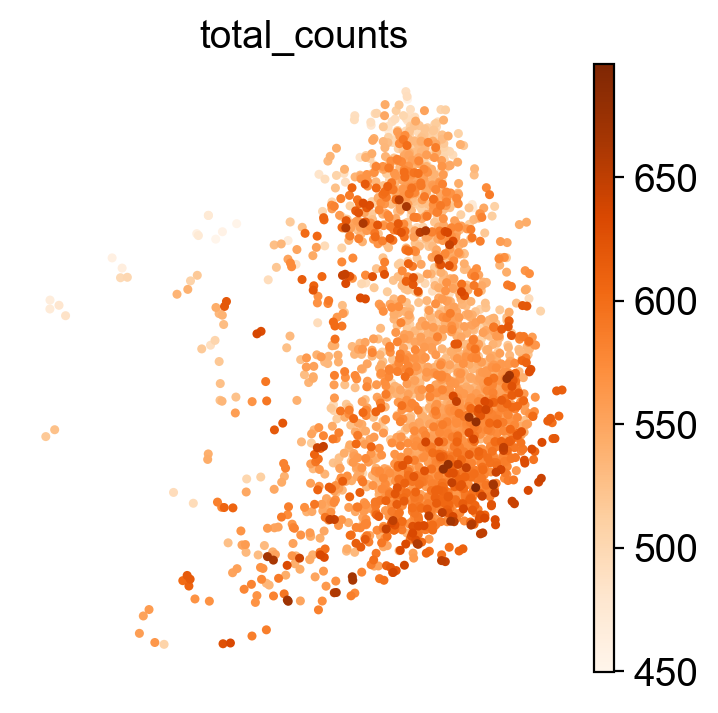

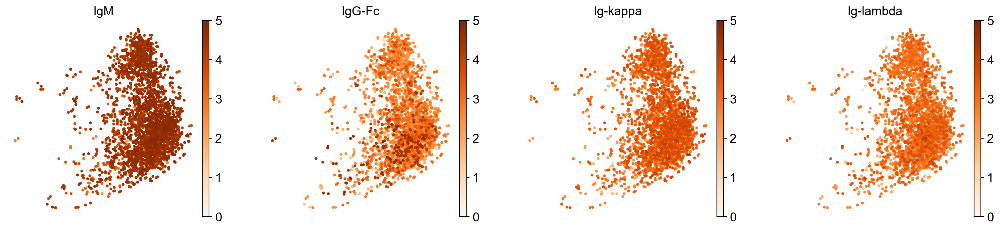

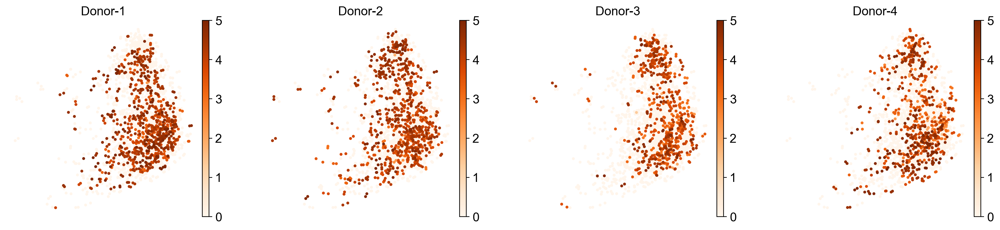

In [128]:

sc.pl.pca(rna,color=["total_counts"], color_map="Oranges", save="_rna.png")
mu.pl.embedding(mdata, 
                basis="RNA:X_pca", 
                color=ant_names,
                color_map="Oranges",
                vmin=0, vmax=5,
               save="_rna_Ig.png")

mu.pl.embedding(mdata, 
                basis="RNA:X_pca", 
                color=donor_names,
                color_map="Oranges",
                vmin=0,vmax=5,
               save="_rna_donors.png")



#### UMAP

In [129]:
sc.pp.neighbors(rna, n_pcs=15)
sc.tl.umap(rna, random_state=42)

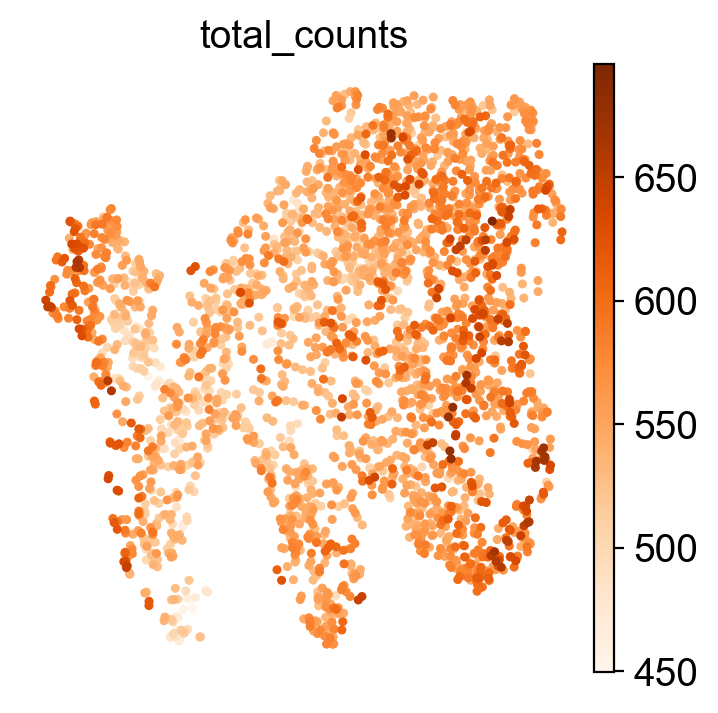

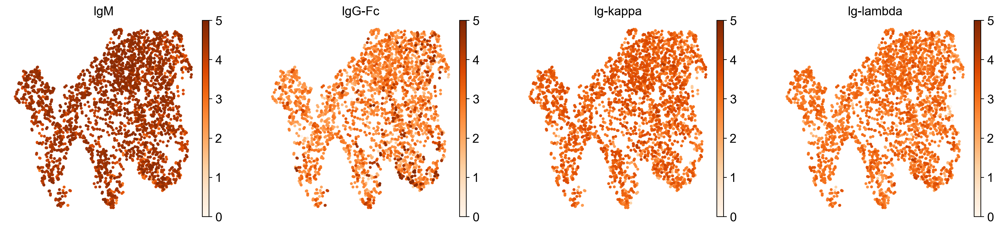

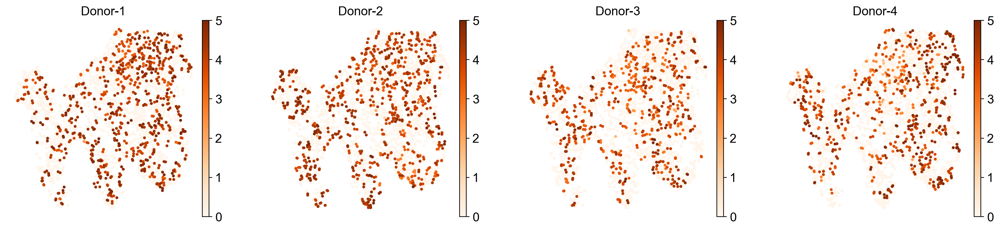

In [130]:
sc.pl.umap(rna, color=["total_counts"], color_map="Oranges", save="_rna.png")
mu.pl.embedding(mdata, 
                basis="RNA:X_umap", 
                color=ant_names,
                color_map="Oranges",
                vmin=0,vmax=5,
               save="_rna_Ig.png")

mu.pl.embedding(mdata, 
                basis="RNA:X_umap", 
                color=donor_names,
                color_map="Oranges",
                vmin=0,vmax=5,
                save="_rna_donors.png")



#### t-SNE

The key idea is that UMAP can serve as an initial dimensionality reduction step to capture global structure, and then t-SNE can be used to explore the local structure in more detail.

In [131]:
sc.tl.tsne(rna, n_pcs=25, use_rep="X_pca", random_state=42, n_jobs=4)


/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/scanpy/tools/_tsne.py:105: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(
/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


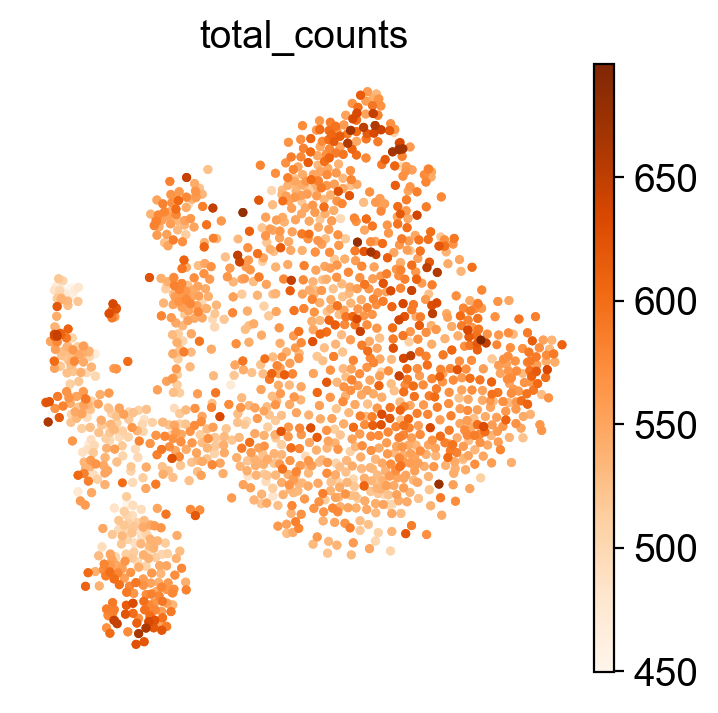

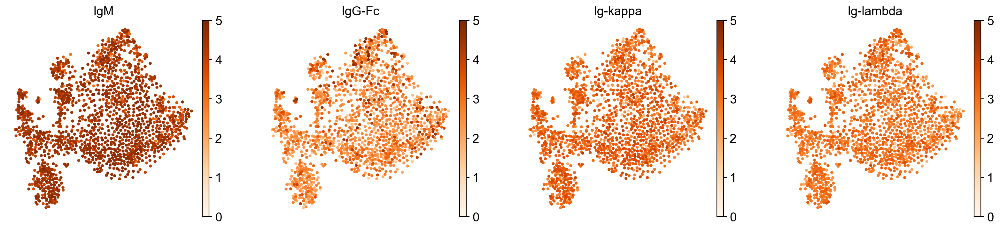

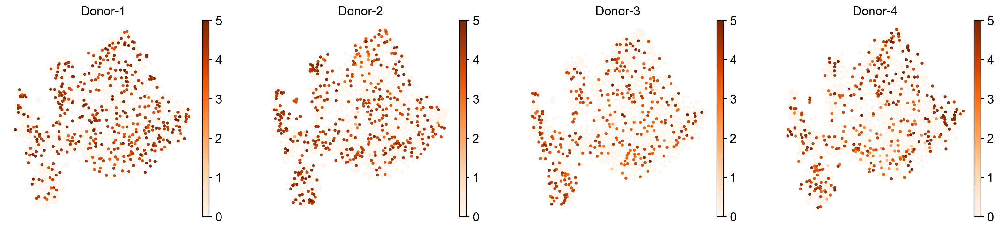

In [132]:

sc.pl.tsne(rna, color=["total_counts"], color_map="Oranges" ,save="_rna.png")
mu.pl.embedding(mdata, 
                basis="RNA:X_tsne", 
                color=ant_names,
                color_map="Oranges",
                vmin=0,vmax=5,
                save="_rna_Ig.png")

mu.pl.embedding(mdata, 
                basis="RNA:X_tsne", 
                color=donor_names,
                color_map="Oranges",
                vmin=0,vmax=5,
                save="_rna_donors.png")

### Antibodies detection

In [133]:
adt = mdata.mod['ADT_HTO']

gene_expr = rna.to_df()

donors_data = adt.to_df()

In [134]:
donors_data["max"] = donors_data[["Donor-1", "Donor-2", "Donor-3", "Donor-4"]].idxmax(axis=1)


barcodes_donor_1 = donors_data[donors_data["max"]=="Donor-1"].index.to_list()
barcodes_donor_2 = donors_data[donors_data["max"]=="Donor-2"].index.to_list()
barcodes_donor_3 = donors_data[donors_data["max"]=="Donor-3"].index.to_list()
barcodes_donor_4 = donors_data[donors_data["max"]=="Donor-4"].index.to_list()

In [135]:
ant_expr_d1 = donors_data[donors_data.index.isin(barcodes_donor_1)][ant_names+["Donor-1"]]
ant_expr_d2 = donors_data[donors_data.index.isin(barcodes_donor_2)][ant_names+["Donor-2"]]
ant_expr_d3 = donors_data[donors_data.index.isin(barcodes_donor_3)][ant_names+["Donor-3"]]
ant_expr_d4 = donors_data[donors_data.index.isin(barcodes_donor_4)][ant_names+["Donor-4"]]


gene_expr_d1 = gene_expr[gene_expr.index.isin(barcodes_donor_1)]
gene_expr_d2 = gene_expr[gene_expr.index.isin(barcodes_donor_2)]
gene_expr_d3 = gene_expr[gene_expr.index.isin(barcodes_donor_3)]
gene_expr_d4 = gene_expr[gene_expr.index.isin(barcodes_donor_4)]

donor_1 = pd.concat(
    [gene_expr_d1, ant_expr_d1], 
    axis=1,  join="inner")
donor_2 = pd.concat(
    [gene_expr_d2, ant_expr_d2], 
    axis=1,  join="inner")
donor_3 = pd.concat(
    [gene_expr_d3, ant_expr_d3], 
    axis=1,  join="inner")

donor_4 = pd.concat(
    [gene_expr_d4, ant_expr_d4], 
    axis=1,  join="inner")

### Dependences of antibody binding from gene expression

In [136]:
ant_names = ["IgM","IgG-Fc","Ig-kappa","Ig-lambda"]
donor_names = ["Donor-1", "Donor-2","Donor-3", "Donor-4"]

In [137]:
gene_name = "ERBB4" #"PPP1R12B" # "ROBO1" "RSKR" #"GAD1" #"ERBB4" #"PPP2R5A" ENSG00000279694

print(f"Gene {gene_name} in a list: {gene_name in gene_expr.columns}")

Gene ERBB4 in a list: True


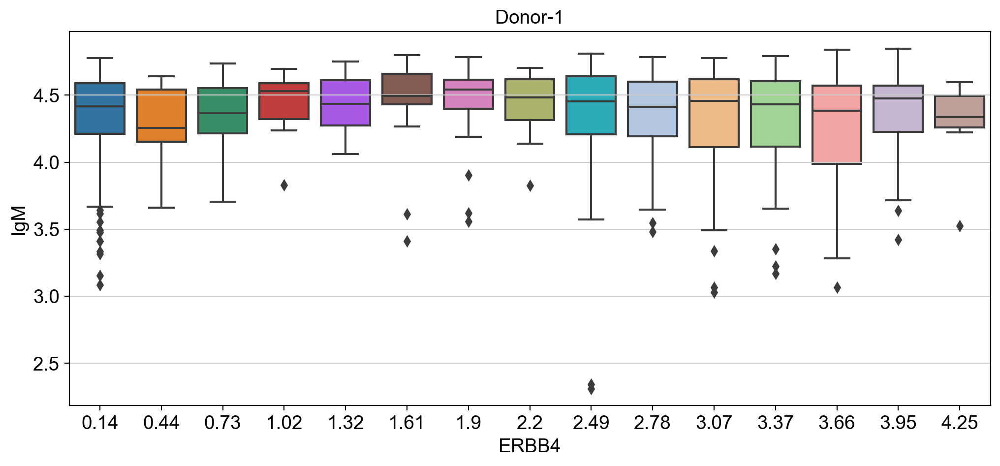

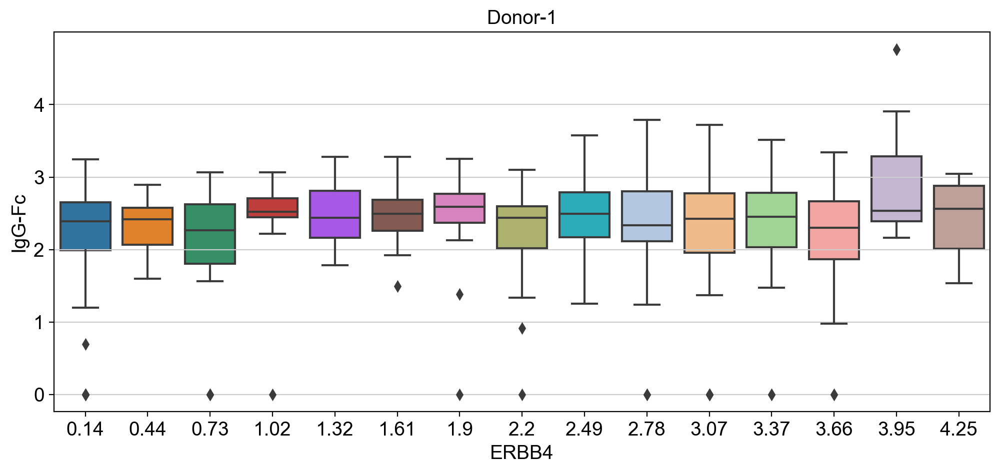

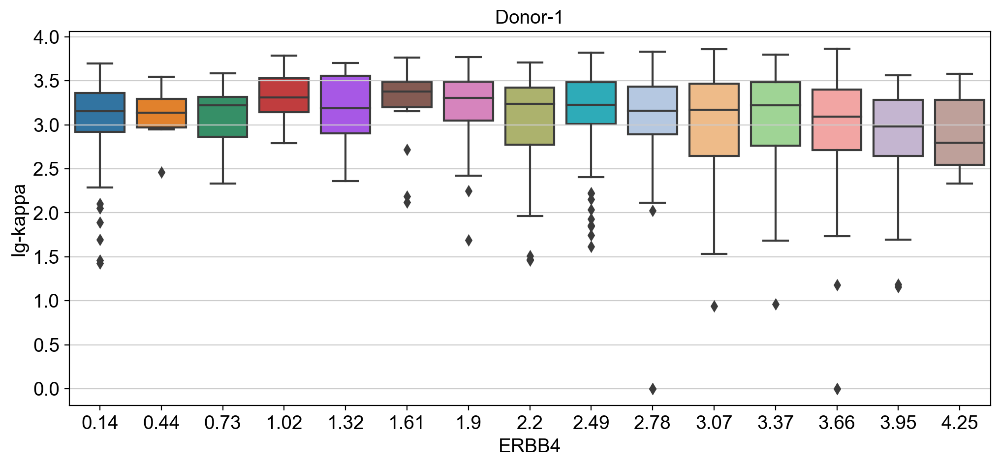

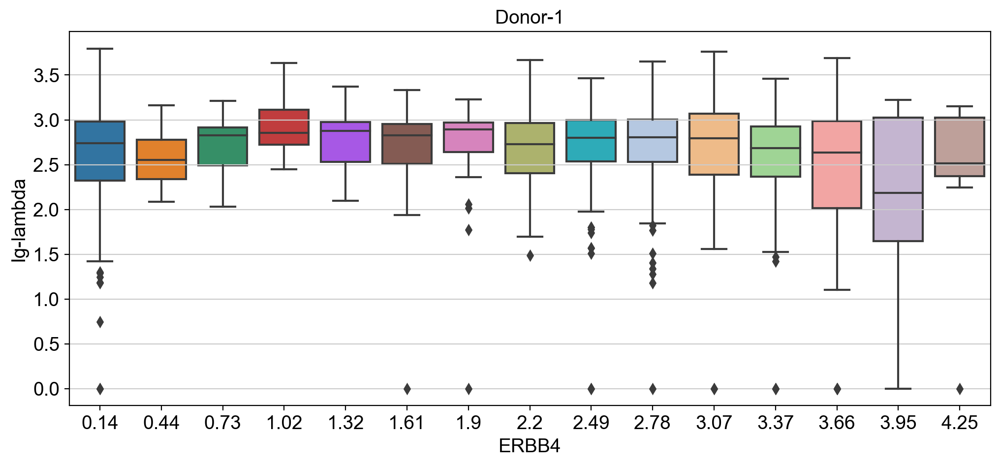

In [138]:
# Binned dependence of antibody binding from gene expression for Donor-1
num_bins = 15

bins = pd.cut(donor_1[gene_name], num_bins)

# Calculate the midpoints of the bins
bin_midpoints = bins.apply(lambda x: round((x.left + x.right) / 2, 2))
donor_1[f"{gene_name}_mid"] = bin_midpoints

for antibody_name in ant_names:
    fig, ax = plt.subplots(figsize=[12,5])
    sns.boxplot( y = antibody_name, x = f"{gene_name}_mid", ax= ax, data = donor_1)
    plt.title("Donor-1")
    plt.xlabel(gene_name);
    plt.savefig(f"{path_images}/{antibody_name}_binned_{gene_name}_donor1.png", bbox_inches="tight");

# Drop unnecessary binned data
donor_1.drop(columns = [f"{gene_name}_mid"], inplace=True)

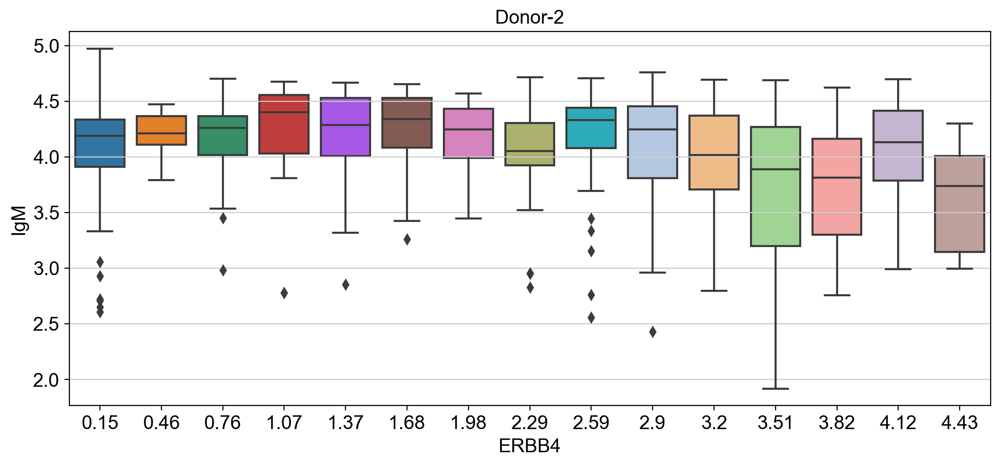

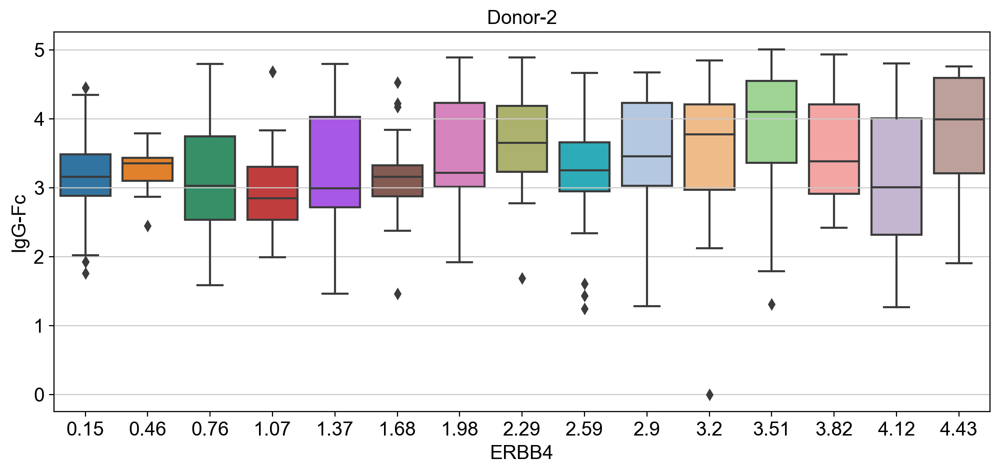

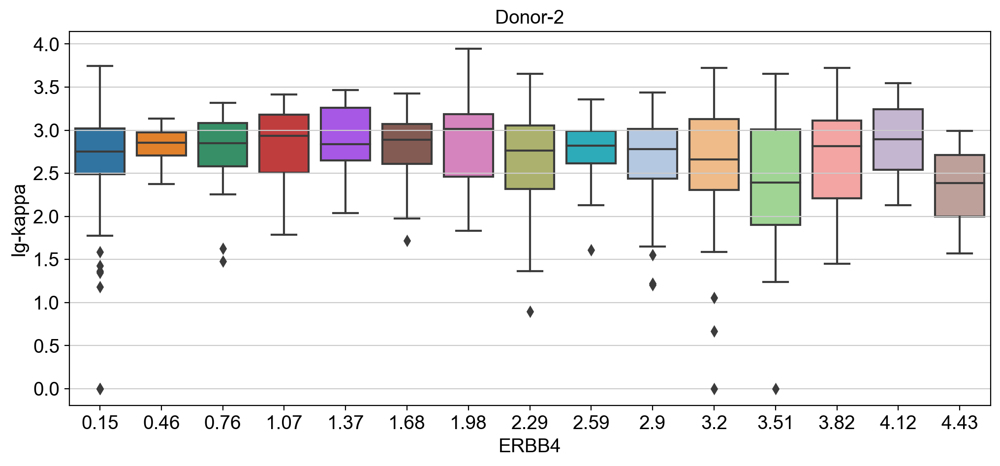

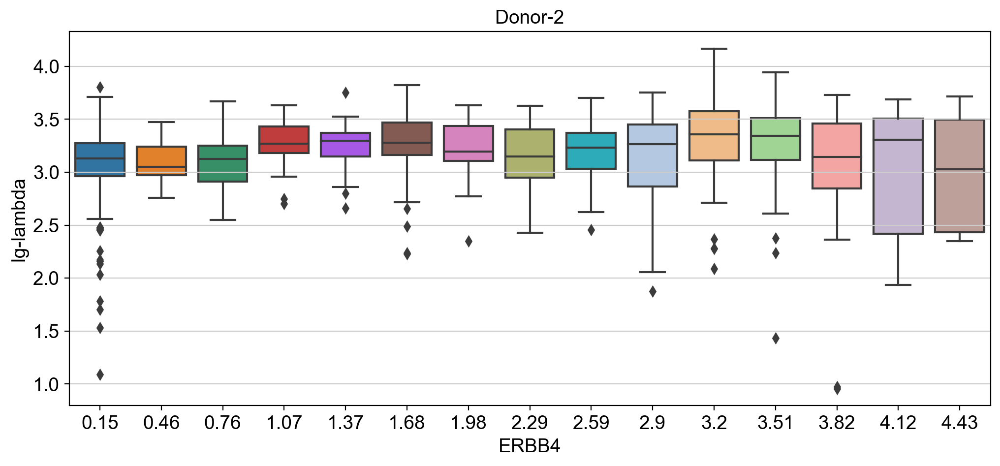

In [139]:
# Binned dependence of antibody binding from gene expression for Donor-2
num_bins = 15

bins = pd.cut(donor_2[gene_name], num_bins)

# Calculate the midpoints of the bins
bin_midpoints = bins.apply(lambda x: round((x.left + x.right) / 2, 2))
donor_2[f"{gene_name}_mid"] = bin_midpoints

for antibody_name in ant_names:
    fig, ax = plt.subplots(figsize=[12,5])
    sns.boxplot( y = antibody_name, x = f"{gene_name}_mid", ax= ax, data = donor_2)
    plt.title("Donor-2")
    plt.xlabel(gene_name)

    plt.savefig(f"{path_images}/{antibody_name}_binned_{gene_name}_donor2.png", bbox_inches="tight");

# Drop unnecessary binned data
donor_2.drop(columns = [f"{gene_name}_mid"], inplace=True)


### Correlations between antibody binding and gene expression  

Briefly, to compute the correlation heatmap of the top 10 genes for different antibodies, I followed these steps:

1. Calculate the Spearman correlation coefficient between each gene and antibody (summed over cells).
2. Select the top 20 **positively correlated genes for Donor-2** (who holds a special place in our dataset).
3. Merge data from various donors using the antibody correlation matrix.


In [140]:
# Compute the Spearman correlation for Donor-2

antibody_name = "IgG-Fc"

spearman_corr, _ = h.spearmanr(donor_2[gene_name], donor_2[antibody_name])

print(f"(Donor 2) Spearman correlation between {gene_name} and {antibody_name}:", spearman_corr)

(Donor 2) Spearman correlation between ERBB4 and IgG-Fc: 0.27355134750832955


In [141]:
# Do the same for all genes and antibodies

spearman_corr_1 = h.spearman_corr(donor_1)
spearman_corr_2 = h.spearman_corr(donor_2)
spearman_corr_3 = h.spearman_corr(donor_3)
spearman_corr_4 = h.spearman_corr(donor_4)

/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:5445: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))
/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:5445: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))
/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:5445: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))
/Users/anastasiacertkova/opt/anaconda3/envs/bio_env_39_3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:5445: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined

If a donor has zero gene counts the rank correlation coefficient for the gene is NaN. 

In [142]:
# Check 
print(f"(Donor 2) Spearman correlation between {gene_name} and {antibody_name}:", spearman_corr_2[gene_name][antibody_name])

(Donor 2) Spearman correlation between ERBB4 and IgG-Fc: 0.27355134750832955


#### Correlation heatmaps 

In [143]:
n_top = 20

fig_length = 0.42*n_top

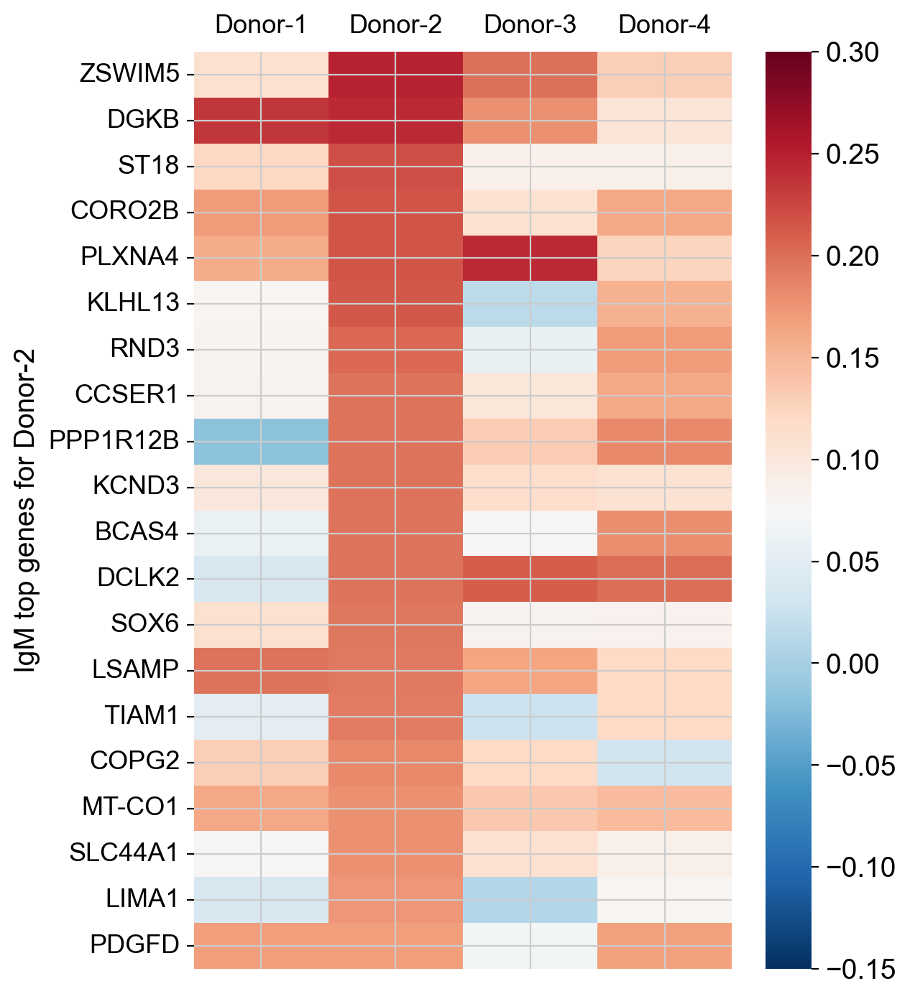

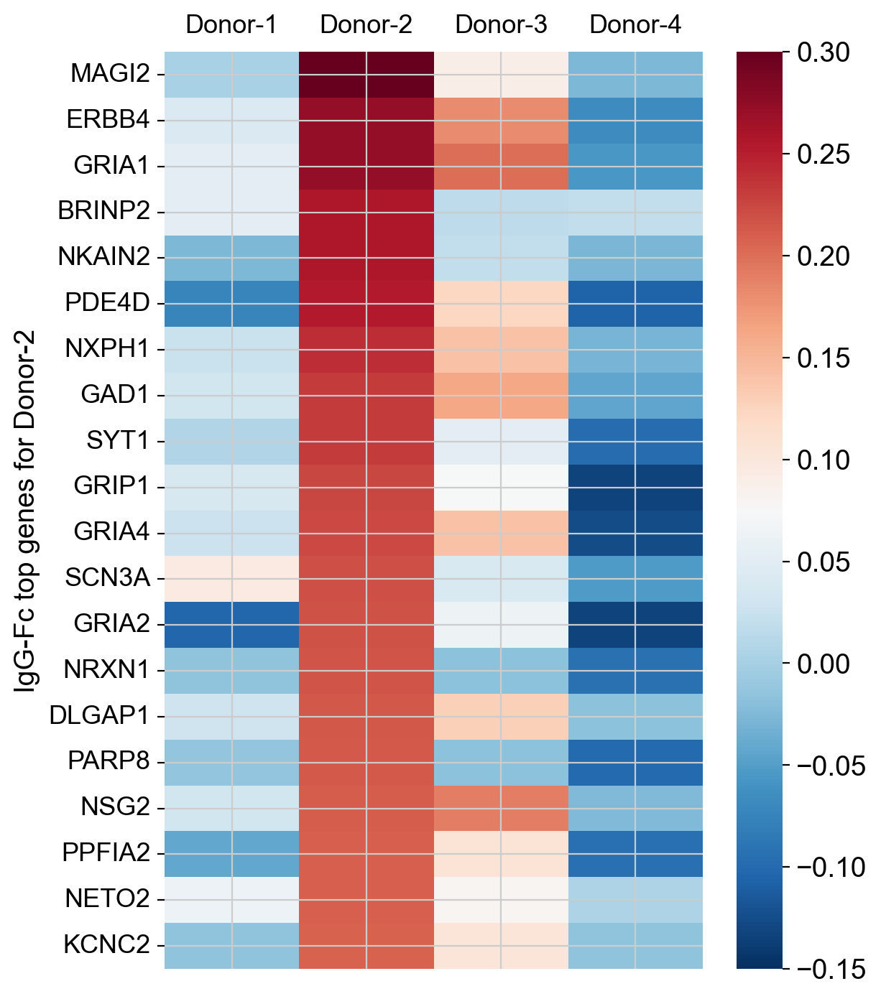

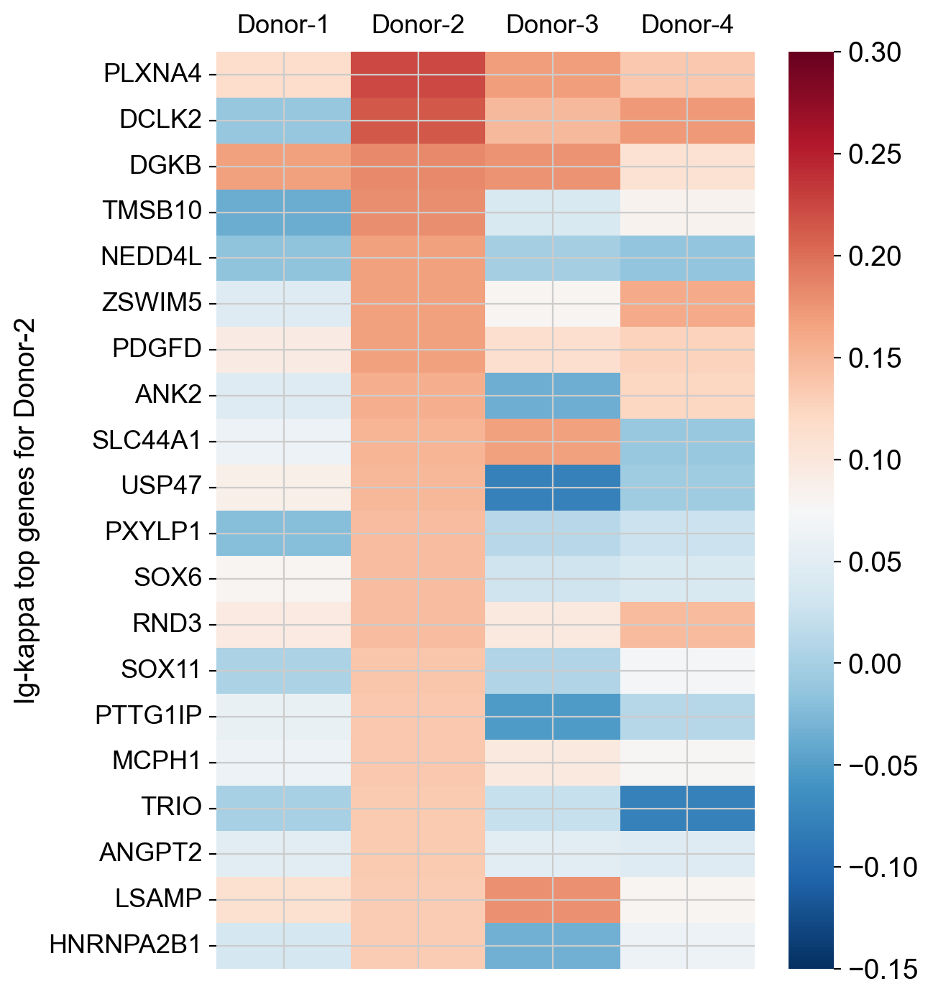

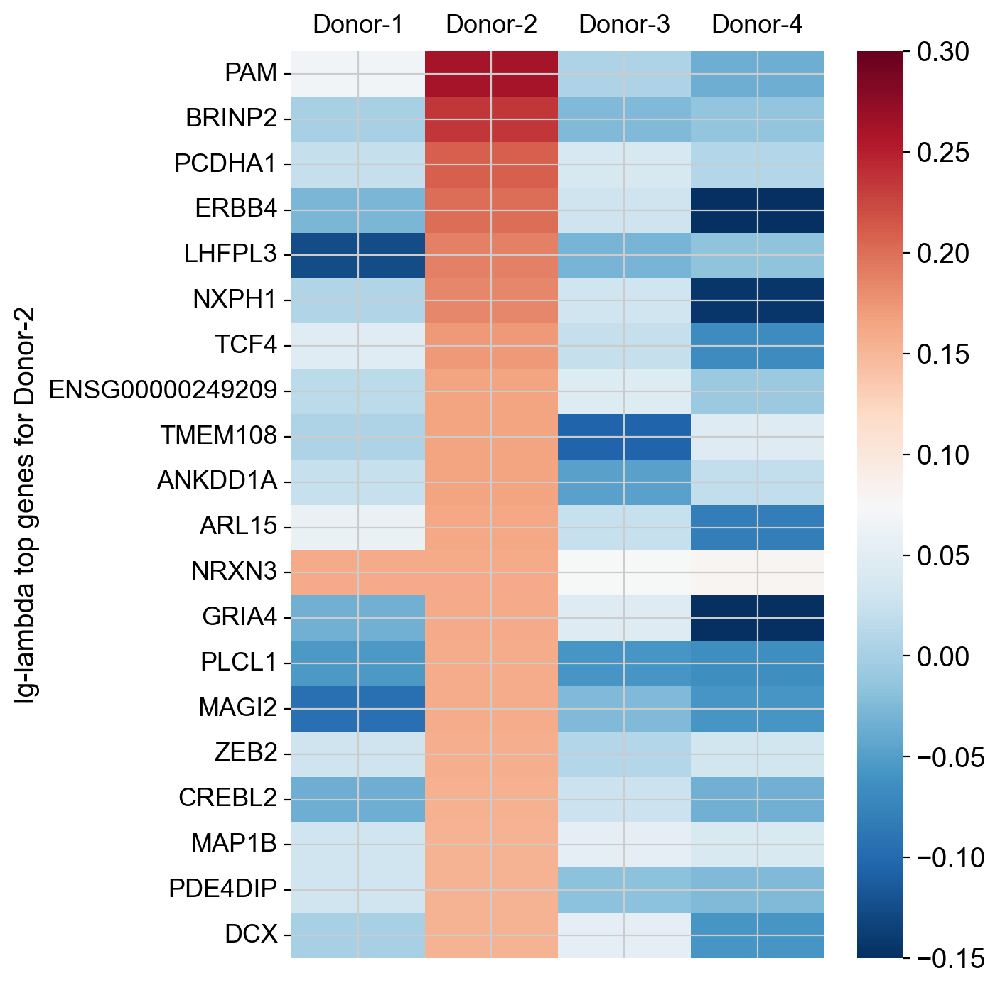

In [144]:

for antibody_name in ant_names:
    corr_matrix_for_antibody = h.antibody_corr_matrix(
        antibody_name, 
        spearman_corr_1, spearman_corr_2, spearman_corr_3, spearman_corr_4, 
        n_top = n_top)
    
    corr_matrix_for_antibody.index.name = f"{antibody_name} top genes for Donor-2"
    #corr_matrix_for_antibody.head(n_top)
    
    fig, ax = plt.subplots(figsize=(6,fig_length))       
    g = sns.heatmap(corr_matrix_for_antibody, cmap="RdBu_r") #, annot=True, fmt='.2f', annot_kws={'size': 10})
    #plt.title("Spearman's rank correlation coefficient", fontsize=20);
    plt.tick_params(axis='both', which='major', labelsize=13, labelbottom = False, bottom=False, top = False, labeltop=True)
    g.collections[0].set_clim(-0.15,0.3)
    plt.savefig(f"{path_images}/spearmans_corr_{antibody_name}_top_{n_top}.png", bbox_inches="tight", dpi=300);




### Correlations for plasma membrane genes

In [145]:
path_pm_genes = joined_dir

# Data from Human Protein Atlas: https://www.proteinatlas.org/search/subcell_location%3APlasma+membrane%2CCell+Junctions

parameters_pm = (["Gene", "Gene description", 
                  "Ensembl", "Position", 
                  "Protein class", "Evidence",
                  "RNA brain regional distribution", 
                  "RNA brain regional specificity"])

pm_genes_df = pd.read_csv(f"{path_pm_genes}/subcell_location_Plasma.tsv", sep='\t')

pm_genes_df = pm_genes_df[parameters_pm]

pm_genes_df.info()
pm_genes_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2286 entries, 0 to 2285
Data columns (total 8 columns):
 #   Column                           Non-Null Count  Dtype 
---  ------                           --------------  ----- 
 0   Gene                             2286 non-null   object
 1   Gene description                 2286 non-null   object
 2   Ensembl                          2286 non-null   object
 3   Position                         2286 non-null   object
 4   Protein class                    2286 non-null   object
 5   Evidence                         2286 non-null   object
 6   RNA brain regional distribution  2286 non-null   object
 7   RNA brain regional specificity   2286 non-null   object
dtypes: object(8)
memory usage: 143.0+ KB


,Gene,Gene description,Ensembl,Position,Protein class,Evidence,RNA brain regional distribution,RNA brain regional specificity
0,AADAT,Aminoadipate aminotransferase,ENSG00000109576,170060222-170091699,"Enzymes, Metabolic proteins, Predicted intrace...",Evidence at protein level,Detected in all,Low region specificity
1,AAK1,AP2 associated kinase 1,ENSG00000115977,69457997-69674349,"Enzymes, Predicted intracellular proteins",Evidence at protein level,Detected in all,Low region specificity
2,ABCA12,ATP binding cassette subfamily A member 12,ENSG00000144452,214931542-215138626,"Disease related genes, Enzymes, Human disease ...",Evidence at protein level,Detected in single,Low region specificity
3,ABCA7,ATP binding cassette subfamily A member 7,ENSG00000064687,1039997-1065572,"Disease related genes, Enzymes, Human disease ...",Evidence at protein level,Detected in all,Low region specificity
4,ABCB1,ATP binding cassette subfamily B member 1,ENSG00000085563,87503017-87713323,"Cancer-related genes, CD markers, Disease rela...",Evidence at protein level,Detected in all,Low region specificity


In [146]:
pm_genes = list(pm_genes_df["Gene"])
rna_genes = rna.var.index

pm_genes_seq = []

for i in range(len(pm_genes)):
    if pm_genes[i] in list(gene_expr.columns):

        pm_genes_seq.append(pm_genes[i])
        
print("Number of plasma membrane genes in RNA-seq data: ", len(pm_genes_seq))

Number of plasma membrane genes in RNA-seq data:  577


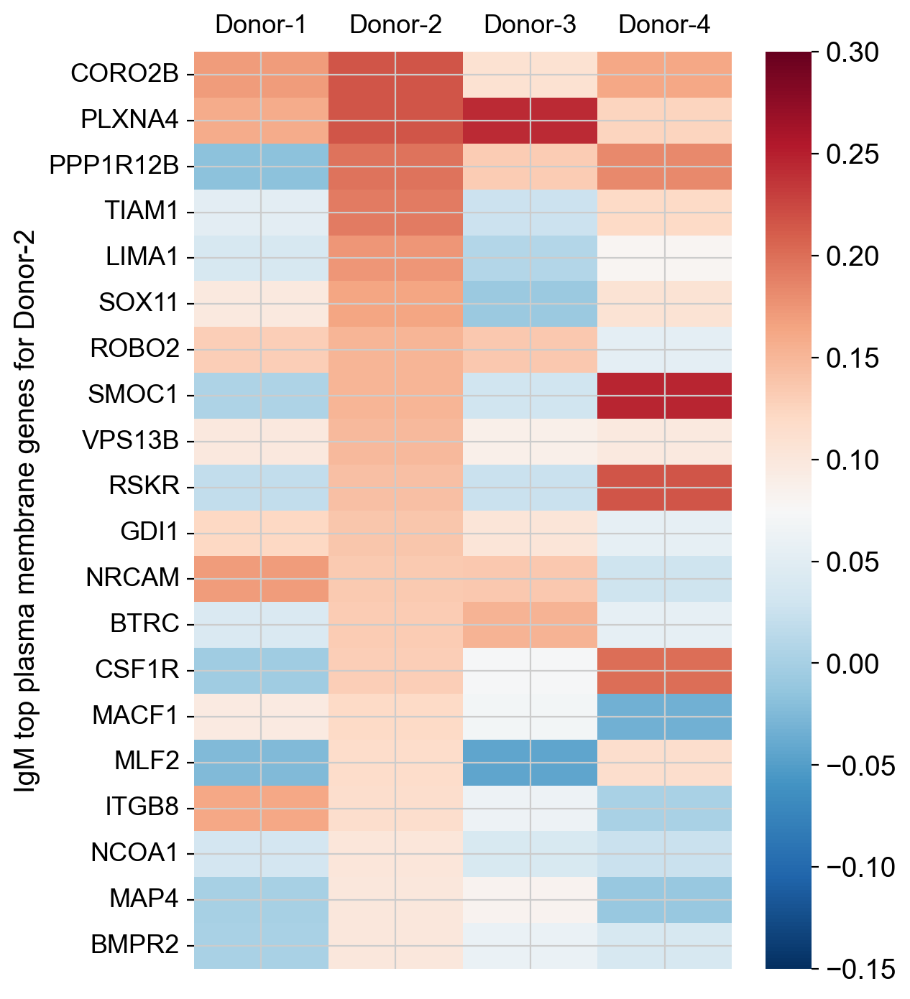

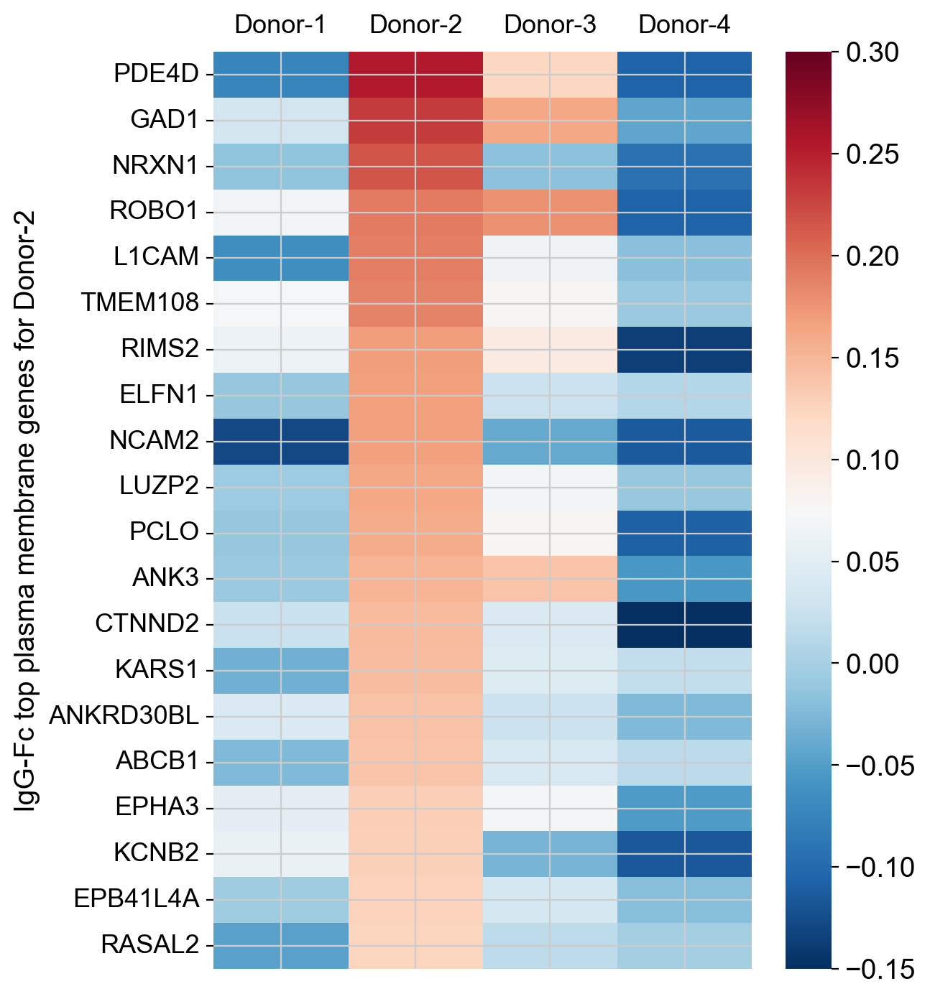

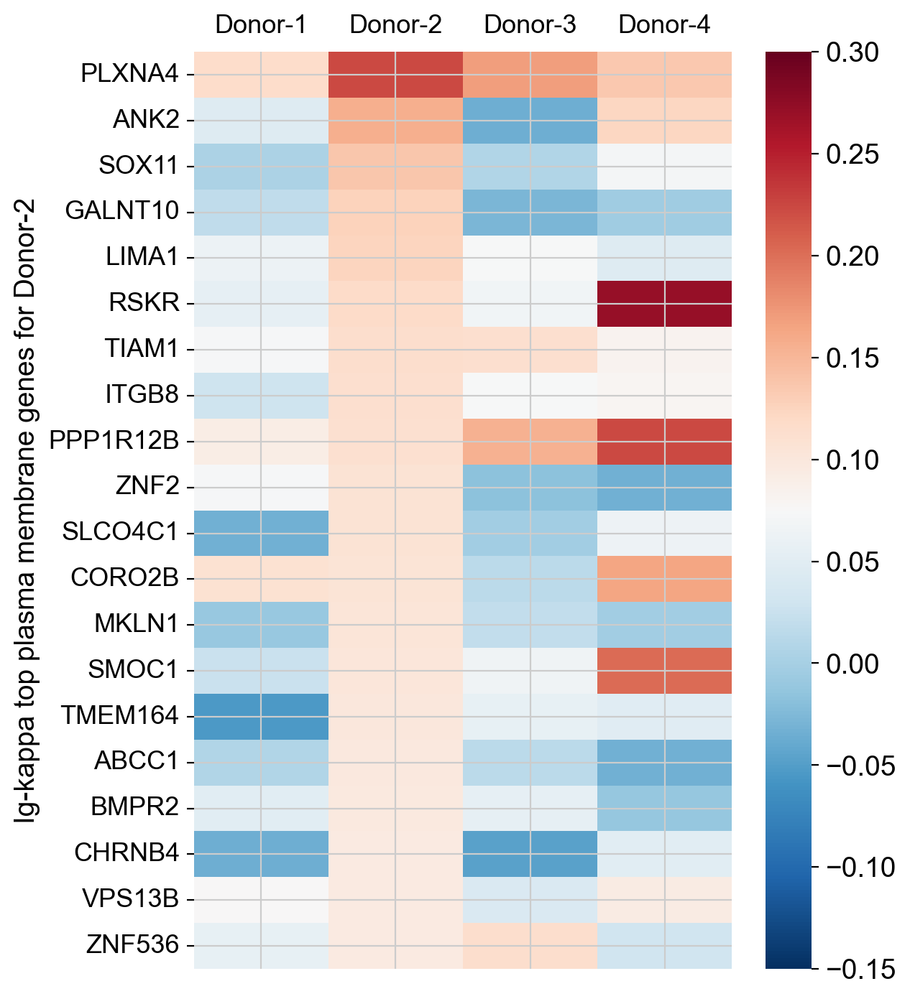

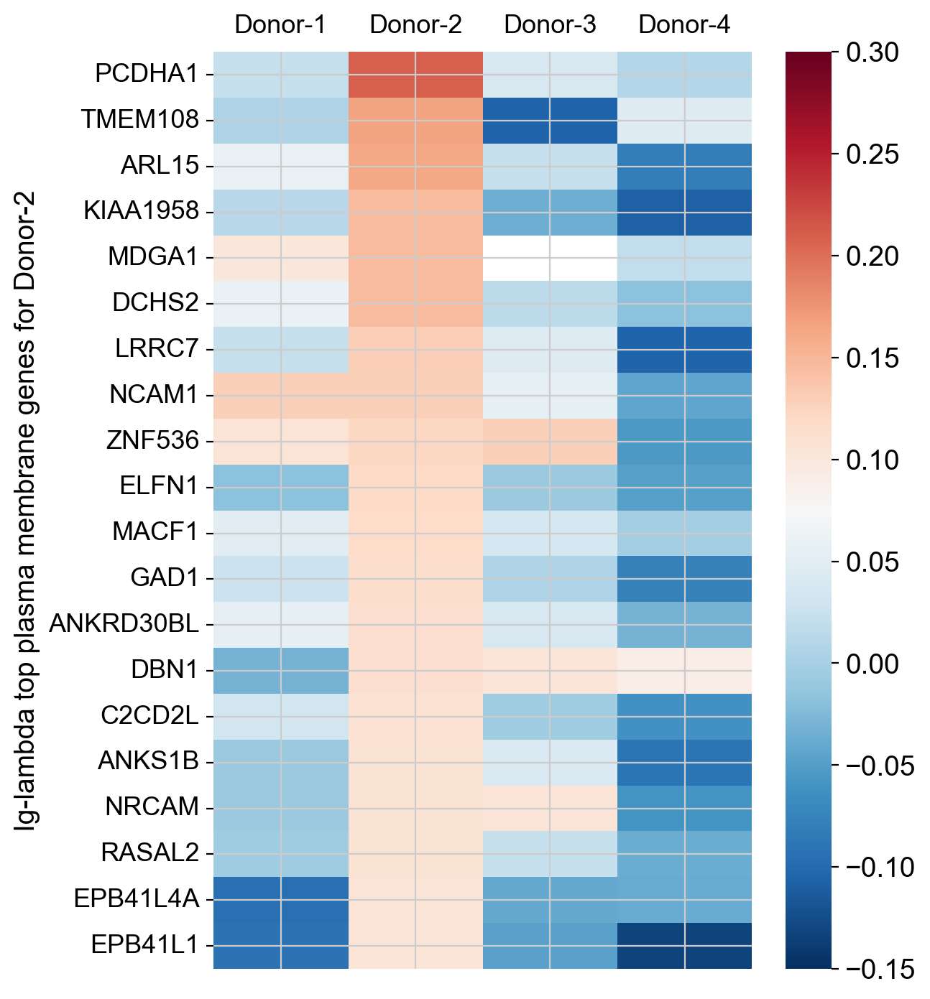

In [147]:
for antibody_name in ant_names:
    corr_matrix_for_antibody = h.antibody_corr_matrix(
        antibody_name, 
        spearman_corr_1[pm_genes_seq],
        spearman_corr_2[pm_genes_seq], 
        spearman_corr_3[pm_genes_seq], 
        spearman_corr_4[pm_genes_seq],
        n_top = n_top)
    
    corr_matrix_for_antibody.index.name = f"{antibody_name} top plasma membrane genes for Donor-2"
    #corr_matrix_for_antibody.head(n_top)
    
    fig, ax = plt.subplots(figsize=(6,fig_length))       
    g = sns.heatmap(corr_matrix_for_antibody, cmap="RdBu_r") #, annot=True, fmt='.2f', annot_kws={'size': 10})
    #plt.title("Spearman's rank correlation coefficient", fontsize=20);
    plt.tick_params(axis='both', which='major', labelsize=13, labelbottom = False, bottom=False, top = False, labeltop=True)
    g.collections[0].set_clim(-0.15,0.3)
    plt.savefig(f"{path_images}/spearmans_corr_{antibody_name}_top_{n_top}_PM.png", bbox_inches="tight", dpi=300);



In [148]:
gene_name = "MDGA1"
antibody_name = "Ig-lambda" 

print(f"(Donor 3) Spearman correlation between {gene_name} and {antibody_name}:", spearman_corr_3[gene_name][antibody_name])

(Donor 3) Spearman correlation between MDGA1 and Ig-lambda: nan


In [149]:
donor_3[gene_name].sum()

0.0

"MDGA1" gene is not detected for Donor-3.

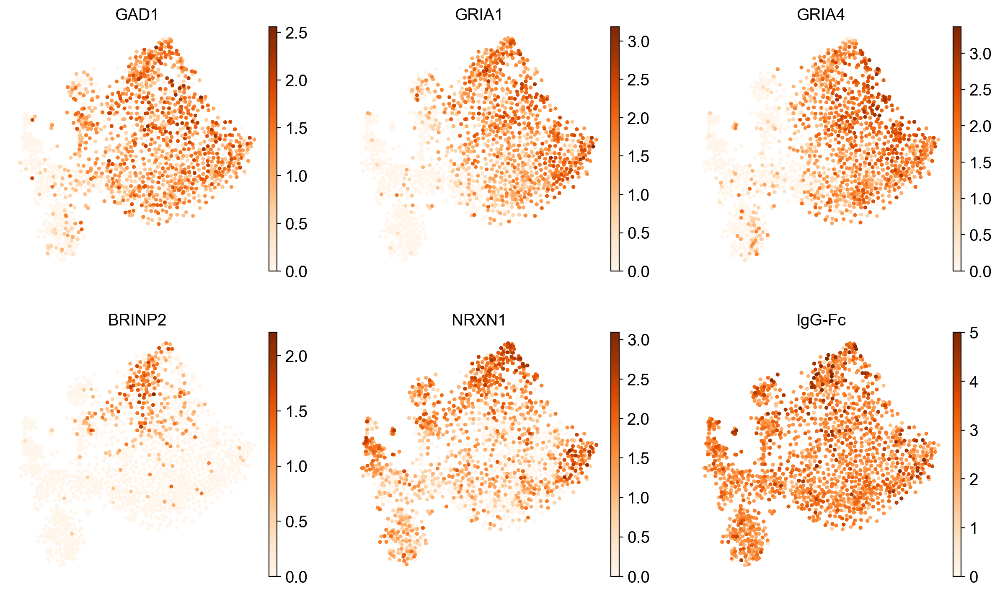

In [150]:
set_of_genes = ["GAD1","GRIA1", "GRIA4", "BRINP2", "NRXN1"]
mu.pl.embedding(mdata, 
                basis="RNA:X_tsne", 
                color=set_of_genes + [ant_names[1]],
                color_map="Oranges",
                ncols = 3,
                save="_set_of_genes.png") #color_map

#### Comparison with Donor-4 (healthy)

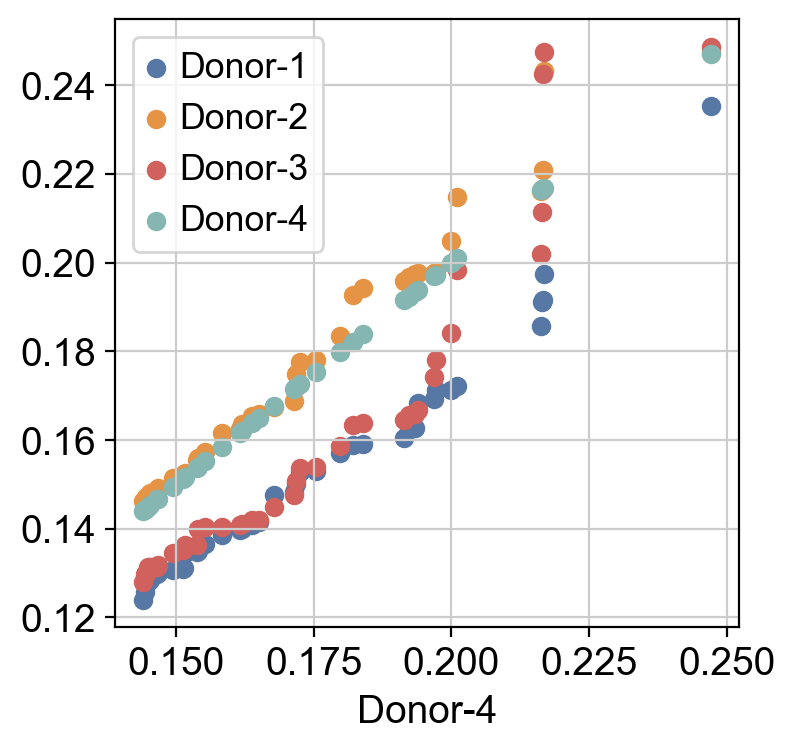

In [161]:
n_top = 40
antibody_name = "IgM"

d1_y = h.top_correlated_genes(spearman_corr_1, antibody_name, n=n_top)
d2_y = h.top_correlated_genes(spearman_corr_2, antibody_name, n=n_top)
d3_y = h.top_correlated_genes(spearman_corr_3, antibody_name, n=n_top)
d4_x = h.top_correlated_genes(spearman_corr_4, antibody_name, n=n_top)

plt.scatter(d4_x ,d1_y, color=colors[0], label="Donor-1")
plt.scatter(d4_x ,d2_y,color=colors[1], label="Donor-2")
plt.scatter(d4_x ,d3_y,color=colors[2], label="Donor-3")
plt.scatter(d4_x ,d4_x, color=colors[3], label="Donor-4")
plt.xlabel("Donor-4")
plt.legend();

#### Correlations for excitatory synapse genes

In [152]:
df_annotation = pd.read_csv(f"{path_pm_genes}/annotation.csv", sep=',', header=1)
df_col_names = pd.read_csv(f"{path_pm_genes}/annotation.csv", sep=',', skipfooter=199).columns.to_list()
df_annotation.columns = df_col_names
df_annotation = df_annotation[["Gene name", "Synapse type"]].copy()


/var/folders/d4/v5xmg8w567957dly2bs_qpfm0000gn/T/ipykernel_27435/2647438280.py:2: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support skipfooter; you can avoid this warning by specifying engine='python'.
  df_col_names = pd.read_csv(f"{path_pm_genes}/annotation.csv", sep=',', skipfooter=199).columns.to_list()


In [153]:
# Prior annotation as excitatory (E), inhibitory (I), or unknown (U)

df_annotation["Gene name"] = df_annotation["Gene name"].str.upper()
df_annotation

,Gene name,Synapse type
0,LRRTM2,E
1,SLC39A10,U
2,LRRTM1,E
3,LY6H,E
4,GRIN1,E
...,...,...
194,CNTNAP1,E
195,CACNA2D3,both
196,CDH9,E
197,SLITRK2,E


In [154]:
excitatory_genes = df_annotation[(df_annotation["Synapse type"] == "E") | (df_annotation["Synapse type"] == "both") ]
excitatory_genes

,Gene name,Synapse type
0,LRRTM2,E
2,LRRTM1,E
3,LY6H,E
4,GRIN1,E
6,CD200,E
...,...,...
194,CNTNAP1,E
195,CACNA2D3,both
196,CDH9,E
197,SLITRK2,E


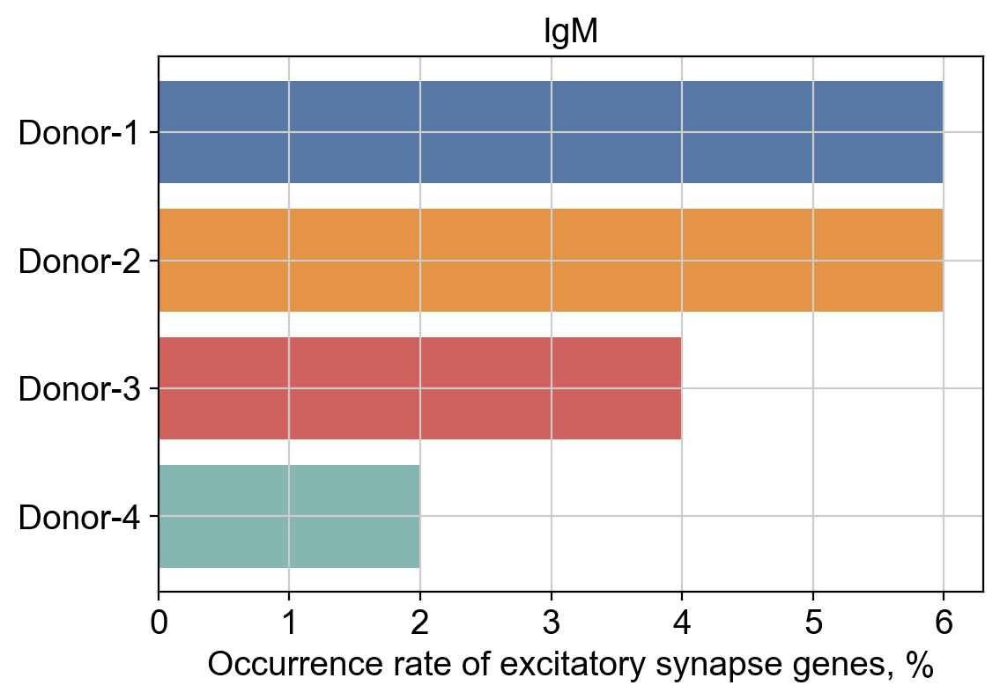

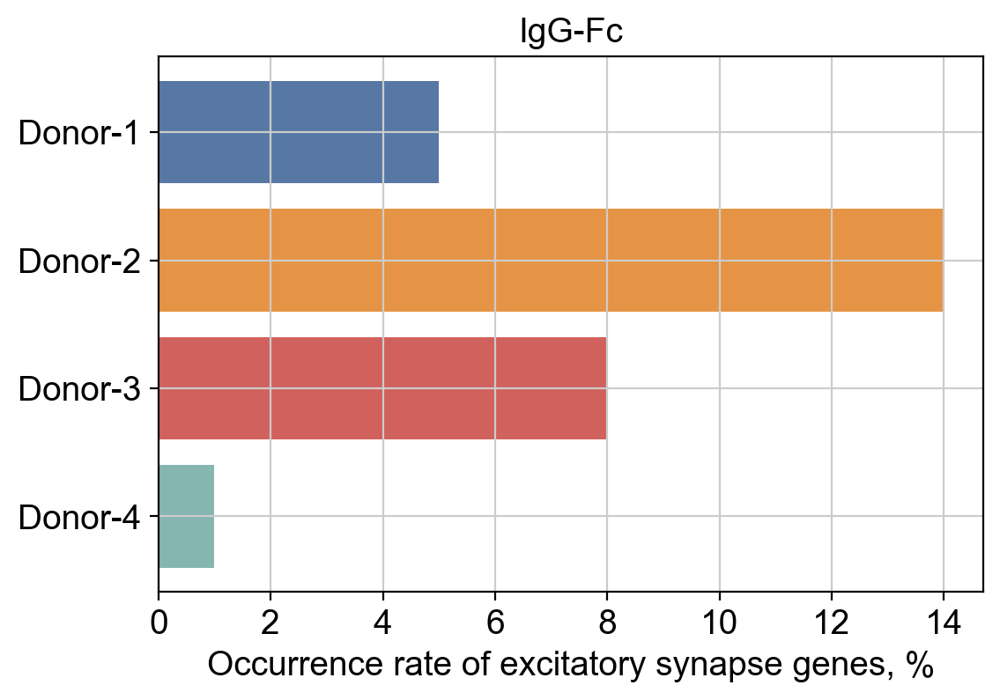

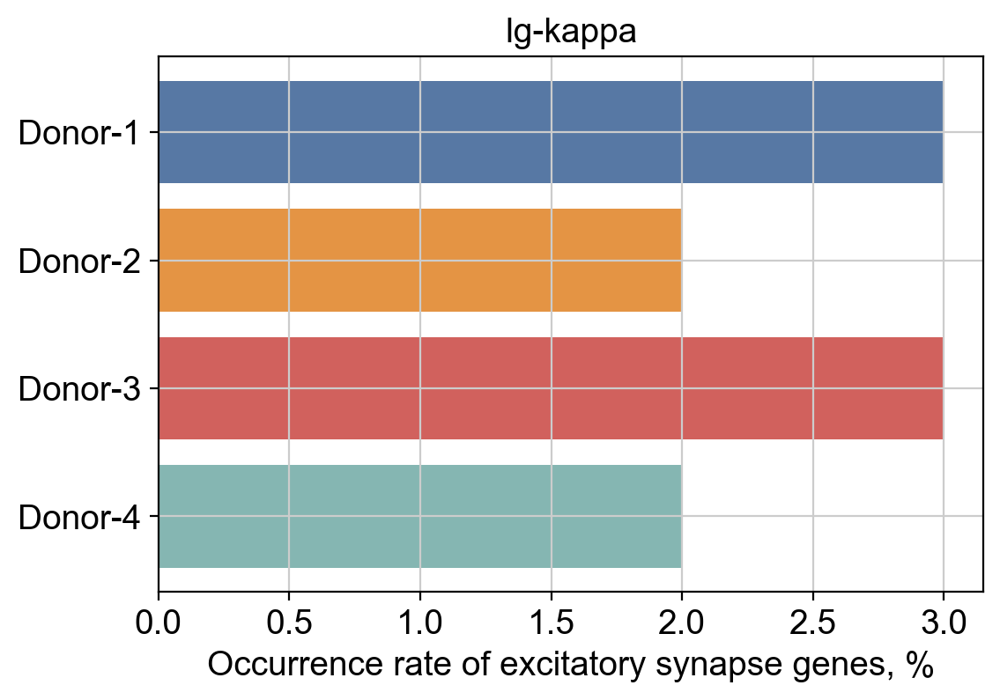

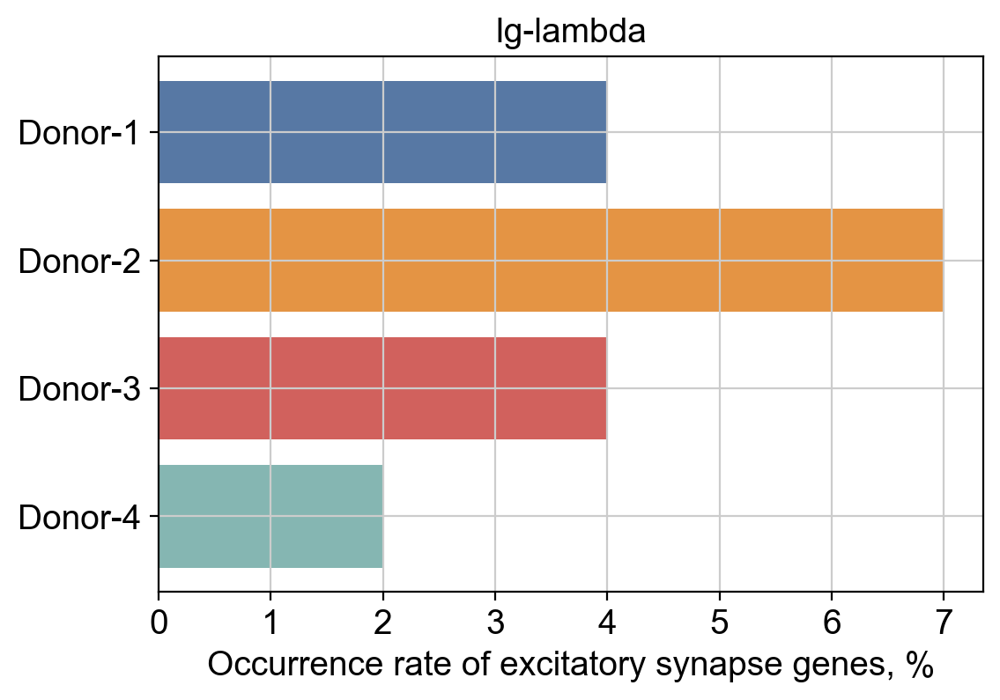

In [160]:
n_top = 100
antibody_name = "IgM"
colors =["#5778a4", "#e49444", "#d1615d", "#85b6b2"]


for antibody_name in ant_names:
    top_corr_genes_donor_1 = h.top_correlated_genes(spearman_corr_1, antibody_name, n=n_top)
    top_corr_genes_donor_2 = h.top_correlated_genes(spearman_corr_2, antibody_name, n=n_top)
    top_corr_genes_donor_3 = h.top_correlated_genes(spearman_corr_3, antibody_name, n=n_top)
    top_corr_genes_donor_4 = h.top_correlated_genes(spearman_corr_4, antibody_name, n=n_top)


    f1= 100*sum(top_corr_genes_donor_1.index.isin(excitatory_genes["Gene name"]))/n_top
    f2 = 100*sum(top_corr_genes_donor_2.index.isin(excitatory_genes["Gene name"]))/n_top
    f3 = 100*sum(top_corr_genes_donor_3.index.isin(excitatory_genes["Gene name"]))/n_top
    f4 = 100*sum(top_corr_genes_donor_4.index.isin(excitatory_genes["Gene name"]))/n_top


    y_pos = np.arange(len(donor_names))

    fig, ax = plt.subplots()
    ax.barh(y_pos, [f1,f2,f3,f4], color=colors)
    ax.set_yticks(y_pos, labels=donor_names)
    ax.invert_yaxis() 
    ax.set_xlabel("Occurrence rate of excitatory synapse genes, %")
    ax.set_title(antibody_name)
    fig.set_figheight(4)
    fig.set_figwidth(6)
    plt.savefig(f"{path_images}/rate_of_excitatory_genes_{antibody_name}_top_{n_top}.png", bbox_inches="tight", dpi=300);

    plt.show()

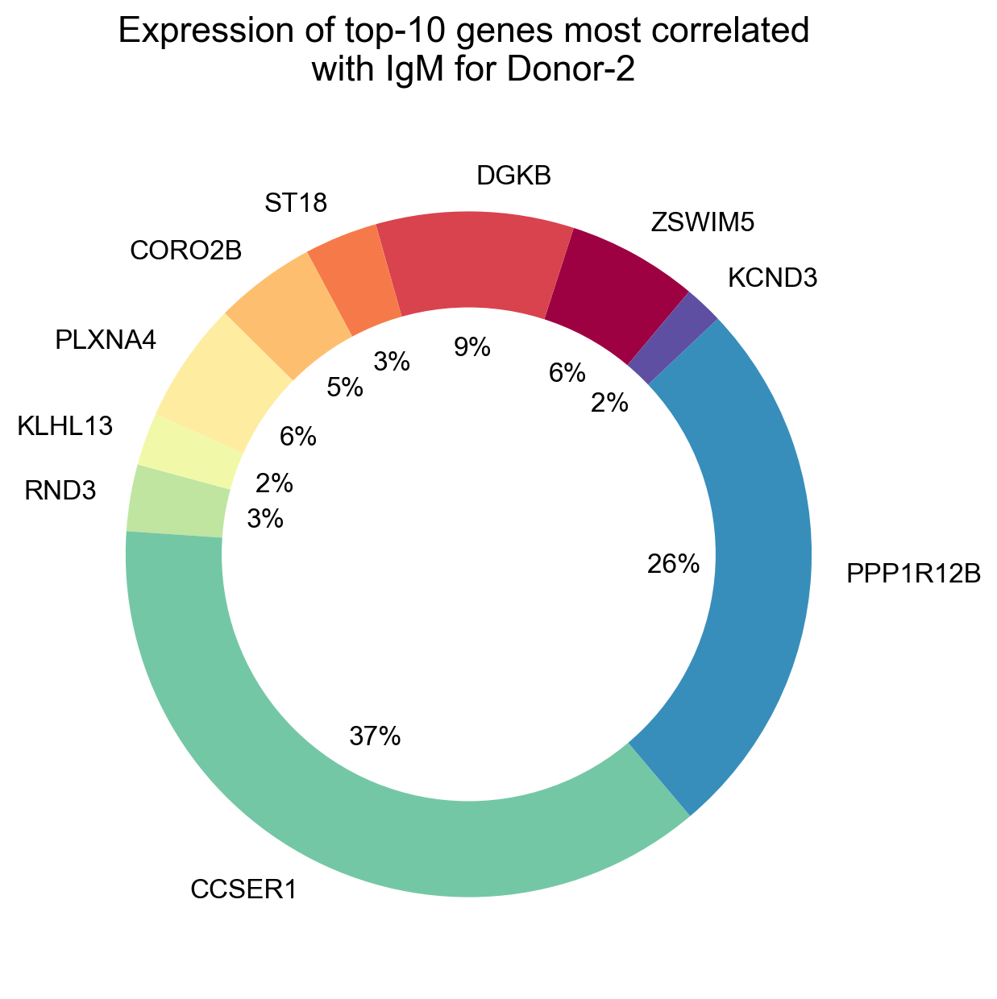

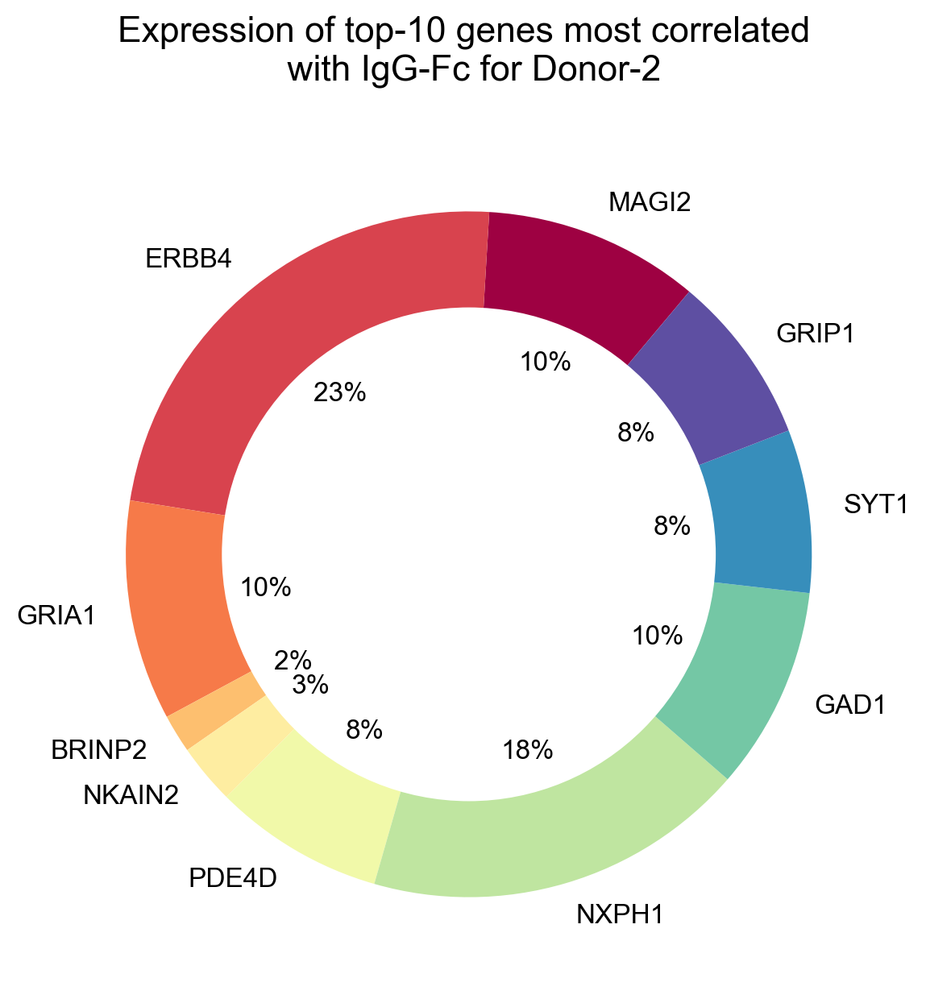

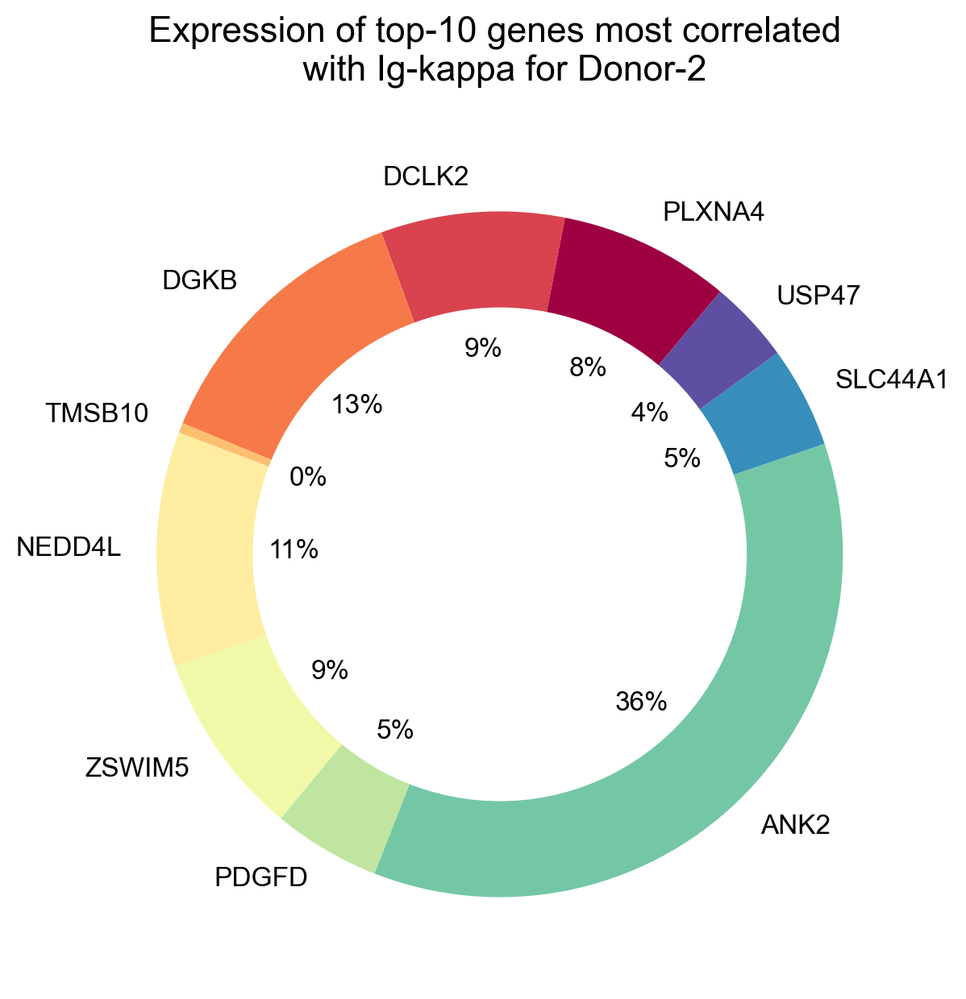

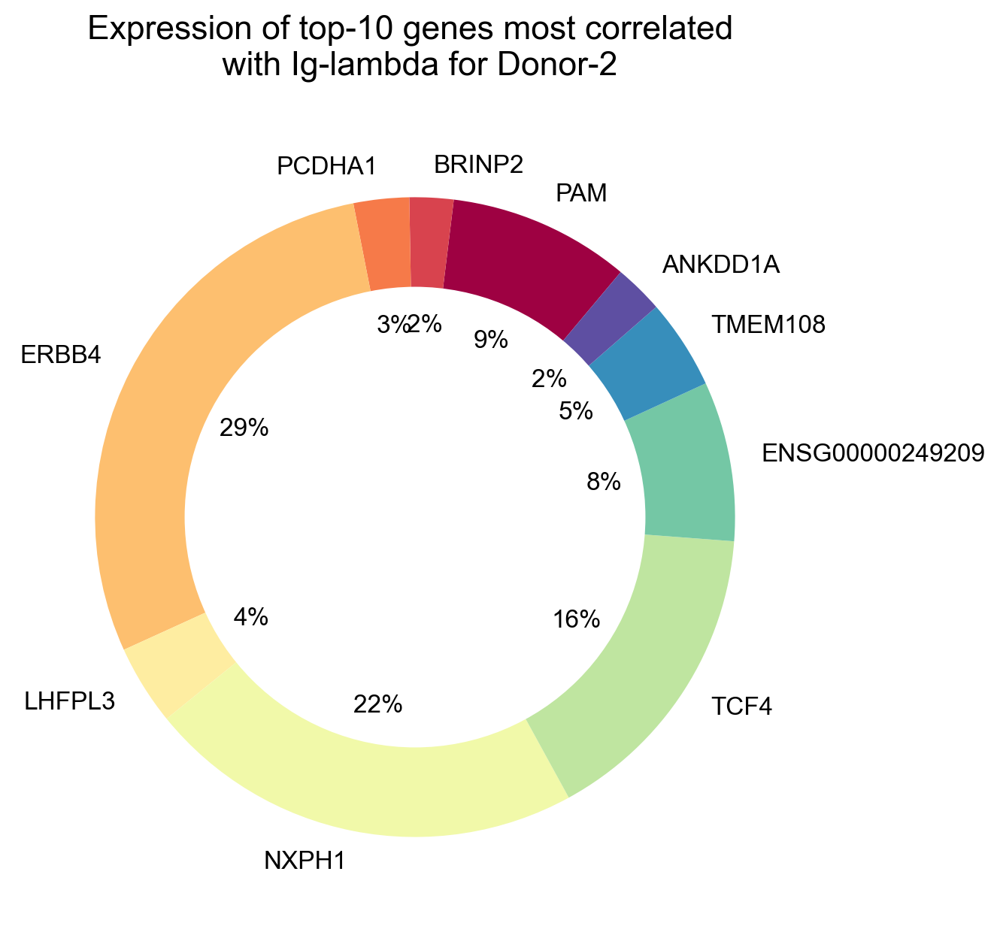

In [156]:

n_top = 10
donor = donor_names[1]

for antibody_name in ant_names:
    if donor=="Donor-1":
        sp_corr_df = spearman_corr_1.copy()
    elif donor=="Donor-2":
        sp_corr_df = spearman_corr_2.copy()
    elif donor=="Donor-3":
        sp_corr_df = spearman_corr_3.copy()
    elif donor=="Donor-4":
        sp_corr_df = spearman_corr_4.copy()
        
    list_of_top_genes = h.top_correlated_genes(sp_corr_df, antibody_name, n=n_top).index.to_list()
    rna.var.loc[list_of_top_genes]
    donor_gene_fractions = pd.DataFrame(rna.to_df()[list_of_top_genes].sum(), columns=["total_counts"])
    donor_gene_fractions /= donor_gene_fractions.sum()/100


    donor_gene_fractions["total_counts"].plot(kind='pie',
                                                autopct='%.0f%%',
                                                figsize=(15,7), 
                                                startangle=50,
                                                colormap="Spectral",
                                                rotatelabels = False,
                                                textprops={'fontsize':12},
                                                legend=False,
                                                labeldistance=1.1,
                                                
                                                ) #explode=[0.005]*len(list_of_top_genes))
    hole = plt.Circle((0,0), 0.72, facecolor='white')
    plt.title(
        label=f"Expression of top-{n_top} genes most correlated \n with {antibody_name} for {donor}", 
        fontdict={"fontsize":16},
        pad=20
    )
    plt.gcf().gca().add_artist(hole)
    #plt.ylabel(donor)
    plt.axis("off");
    plt.savefig(f"{path_images}/expression_of_genes_corr_{antibody_name}_top_{n_top}_{donor}.png", bbox_inches="tight", dpi=300);
    plt.show()

 --- 
Thank you for your attention to my notebook! Please check the presentation in PDF format to get a full overview of the project.